# Capstone Project: Create a Customer Segmentation Report for Arvato Financial Services

In this project, you will analyze demographics data for customers of a mail-order sales company in Germany, comparing it against demographics information for the general population. You'll use unsupervised learning techniques to perform customer segmentation, identifying the parts of the population that best describe the core customer base of the company. Then, you'll apply what you've learned on a third dataset with demographics information for targets of a marketing campaign for the company, and use a model to predict which individuals are most likely to convert into becoming customers for the company. The data that you will use has been provided by our partners at Bertelsmann Arvato Analytics, and represents a real-life data science task.

If you completed the first term of this program, you will be familiar with the first part of this project, from the unsupervised learning project. The versions of those two datasets used in this project will include many more features and has not been pre-cleaned. You are also free to choose whatever approach you'd like to analyzing the data rather than follow pre-determined steps. In your work on this project, make sure that you carefully document your steps and decisions, since your main deliverable for this project will be a blog post reporting your findings.

In [120]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import random

# From utils.py
from utils import get_missing_and_nas, remove_nas_rows, obtain_categorical_columns 
from utils import create_unknown_dataset, create_unknown_dictionary, replace_unknown_values
from utils import split_cameo
from utils import clean_azdias, clean_mailout 
from utils import do_pca, get_component, plot_component, scree_plot, save_model
import importlib

from jupyterthemes import jtplot
# currently installed theme will be used to
# set plot style if no arguments provided
jtplot.style()

# sklearn
from sklearn.preprocessing import Imputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

#Clustering
from sklearn.cluster import KMeans

# magic word for producing visualizations in notebook
%matplotlib inline

## 0. Get to Know the Data

There are four data files associated with this project:

- `Udacity_AZDIAS_052018.csv`: Demographics data for the general population of Germany; 891 211 persons (rows) x 366 features (columns).
- `Udacity_CUSTOMERS_052018.csv`: Demographics data for customers of a mail-order company; 191 652 persons (rows) x 369 features (columns).
- `Udacity_MAILOUT_052018_TRAIN.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 982 persons (rows) x 367 (columns).
- `Udacity_MAILOUT_052018_TEST.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 833 persons (rows) x 366 (columns).

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. Use the information from the first two files to figure out how customers ("CUSTOMERS") are similar to or differ from the general population at large ("AZDIAS"), then use your analysis to make predictions on the other two files ("MAILOUT"), predicting which recipients are most likely to become a customer for the mail-order company.

The "CUSTOMERS" file contains three extra columns ('CUSTOMER_GROUP', 'ONLINE_PURCHASE', and 'PRODUCT_GROUP'), which provide broad information about the customers depicted in the file. The original "MAILOUT" file included one additional column, "RESPONSE", which indicated whether or not each recipient became a customer of the company. For the "TRAIN" subset, this column has been retained, but in the "TEST" subset it has been removed; it is against that withheld column that your final predictions will be assessed in the Kaggle competition.

Otherwise, all of the remaining columns are the same between the three data files. For more information about the columns depicted in the files, you can refer to two Excel spreadsheets provided in the workspace. [One of them](./DIAS Information Levels - Attributes 2017.xlsx) is a top-level list of attributes and descriptions, organized by informational category. [The other](./DIAS Attributes - Values 2017.xlsx) is a detailed mapping of data values for each feature in alphabetical order.

In the below cell, we've provided some initial code to load in the first two datasets. Note for all of the `.csv` data files in this project that they're semicolon (`;`) delimited, so an additional argument in the [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call has been included to read in the data properly. Also, considering the size of the datasets, it may take some time for them to load completely.

You'll notice when the data is loaded in that a warning message will immediately pop up. Before you really start digging into the modeling and analysis, you're going to need to perform some cleaning. Take some time to browse the structure of the data and look over the informational spreadsheets to understand the data values. Make some decisions on which features to keep, which features to drop, and if any revisions need to be made on data formats. It'll be a good idea to create a function with pre-processing steps, since you'll need to clean all of the datasets before you work with them.

## I. Loading the data

In [3]:
# load in the data
azdias = pd.read_csv('Udacity_AZDIAS_052018.csv', sep=';')
customers = pd.read_csv('Udacity_CUSTOMERS_052018.csv', sep=';')
azdias.drop(columns='Unnamed: 0', inplace=True)
customers.drop(columns='Unnamed: 0', inplace=True)

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
# Also the attribute file will come in handy for handling missing or unknown values
dictionary = pd.read_excel('DIAS Attributes - Values 2017_revised.xlsx', sheet_name='Tabelle1')
dictionary.drop(columns='Unnamed: 0', inplace=True)

In [5]:
# File created by me, cataloguizing all the columns: categorical, numeric, mixed, ordinal, etc. 
# For easy data processing in later cells
feature_info = pd.read_csv('feature_info.csv')

In [7]:
# Let's get a sense of the data first
print(azdias.shape)
azdias.info(verbose=True, null_counts=True)


(891221, 366)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891221 entries, 0 to 891220
Data columns (total 366 columns):
LNR                            891221 non-null int64
AGER_TYP                       891221 non-null int64
AKT_DAT_KL                     817722 non-null float64
ALTER_HH                       817722 non-null float64
ALTER_KIND1                    81058 non-null float64
ALTER_KIND2                    29499 non-null float64
ALTER_KIND3                    6170 non-null float64
ALTER_KIND4                    1205 non-null float64
ALTERSKATEGORIE_FEIN           628274 non-null float64
ANZ_HAUSHALTE_AKTIV            798073 non-null float64
ANZ_HH_TITEL                   794213 non-null float64
ANZ_KINDER                     817722 non-null float64
ANZ_PERSONEN                   817722 non-null float64
ANZ_STATISTISCHE_HAUSHALTE     798073 non-null float64
ANZ_TITEL                      817722 non-null float64
ARBEIT                         794005 non-null float64
BALL

In [8]:
# Lets see missing vales in each colunmn closer
print("NAs / Nulls:")
print(pd.isnull(azdias).sum().sort_values(ascending=False))

NAs / Nulls:
ALTER_KIND4                    890016
ALTER_KIND3                    885051
ALTER_KIND2                    861722
ALTER_KIND1                    810163
EXTSEL992                      654153
KK_KUNDENTYP                   584612
ALTERSKATEGORIE_FEIN           262947
D19_LETZTER_KAUF_BRANCHE       257113
D19_LOTTO                      257113
D19_VERSI_ONLINE_QUOTE_12      257113
D19_BANKEN_ONLINE_QUOTE_12     257113
D19_SOZIALES                   257113
D19_GESAMT_ONLINE_QUOTE_12     257113
D19_KONSUMTYP                  257113
D19_TELKO_ONLINE_QUOTE_12      257113
D19_VERSAND_ONLINE_QUOTE_12    257113
KBA05_MOTOR                    133324
KBA05_MOD8                     133324
KBA05_MOD4                     133324
KBA05_MOD3                     133324
KBA05_MOD2                     133324
KBA05_SEG1                     133324
KBA05_MOD1                     133324
KBA05_MAXVORB                  133324
KBA05_MAXSEG                   133324
KBA05_MAXHERST                 133324

In [9]:
# How values look in each column?
azdias.describe()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CJT_GESAMTTYP,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_ONLINE_QUOTE_12,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,D19_BILDUNG,D19_BIO_OEKO,D19_BUCH_CD,...,REGIOTYP,RELAT_AB,RETOURTYP_BK_S,RT_KEIN_ANREIZ,RT_SCHNAEPPCHEN,RT_UEBERGROESSE,SEMIO_DOM,SEMIO_ERL,SEMIO_FAM,SEMIO_KAEM,SEMIO_KRIT,SEMIO_KULT,SEMIO_LUST,SEMIO_MAT,SEMIO_PFLICHT,SEMIO_RAT,SEMIO_REL,SEMIO_SOZ,SEMIO_TRADV,SEMIO_VERT,SHOPPER_TYP,SOHO_KZ,STRUKTURTYP,TITEL_KZ,UMFELD_ALT,UMFELD_JUNG,UNGLEICHENN_FLAG,VERDICHTUNGSRAUM,VERS_TYP,VHA,VHN,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
count,8.912210e+05,891221.000000,817722.000000,817722.000000,81058.000000,29499.000000,6170.000000,1205.000000,628274.000000,798073.000000,794213.000000,817722.000000,817722.000000,798073.000000,817722.000000,794005.000000,797481.000000,886367.000000,886367.000000,886367.000000,886367.000000,886367.000000,886367.000000,886367.000000,886367.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,634108.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,...,770025.000000,794005.00000,886367.000000,886367.000000,886367.000000,839995.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,891221.000000,817722.000000,793947.000000,817722.000000,793435.000000,793435.000000,817722.000000,793947.00000,891221.000000,817722.00000,770025.000000,815304.000000,815304.000000,815304.000000,783619.000000,817722.000000,798073.000000,891221.000000,891221.000000,891221.000000
mean,6.372630e+05,-0.358435,4.421928,10.864126,11.745392,13.402658,14.476013,15.089627,13.700717,8.287263,0.040647,0.154018,1.727637,7.599356,0.004162,3.167854,4.153043,3.632838,3.335264,3.368086,3.195014,3.351290,3.336151,3.360684,3.465980,0.122336,0.219907,9.267420,0.892735,0.568580,0.106769,9.926794,9.439073,0.705221,0.425645,0.467869,1.145516,0.485508,0.257938,1.585405,...,4.257967,3.07222,3.419630,3.233723,3.863797,3.023813,4.667550,4.481405,4.272729,4.445007,4.763223,4.025014,4.359086,4.001597,4.256076,3.910139,4.240609,3.945860,3.661784,4.023709,1.266967,0.008423,2.539212,0.003483,3.223125,4.017526,0.090067,4.58576,1.197852,0.43882,2.417322,6.001214,7.532130,5.945972,3.933406,7.908791,4.052836,3.362438,1.522098,2.777398
std,2.572735e+05,1.198724,3.638805,7.639683,4.097660,3.243300,2.712427,2.452932,5.079849,15.628087,0.324028,0.502389,1.155849,14.332201,0.068855,1.002376,2.183710,1.595021,1.493633,1.368331,1.401382,1.396508,1.373077,1.378992,1.328456,0.535950,0.747903,1.735725,2.011838,1.643764,0.808179,0.605641,1.547773,2.552707,1.510782,1.542151,2.266999,1.639340,1.252328,2.547925,...,2.030385,1.36298,1.417741,1.388687,1.282747,1.502725,1.795712,1.807552,1.915885,1.852412,1.830789,1.903816,2.022829,1.857540,1.770137,1.580306,2.007373,1.946564,1.707637,2.077746,1.287435,0.091392,0.754926,0.084957,1.255785,1.118399,0.286278,8.47152,0.952532,1.14329,1.166572,2.856091,3.247789,2.771464,1.964701,1.923137,1.949539,1.352704,0.499512,1.068775
min,1.916530e+05,-1.000000,1.000000,0.000000,2.000000,2.000000,4.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.00

In [10]:
# How values look in each object column? 
azdias.describe(include=['object'])

,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_INTL_2015,D19_LETZTER_KAUF_BRANCHE,EINGEFUEGT_AM,OST_WEST_KZ
count,792242,792242,792242,634108,798073,798073
unique,45,19,43,35,5162,2
top,6B,8,51,D19_UNBEKANNT,1992-02-10 00:00:00,W
freq,56672,78023,77576,195338,383738,629528


## II. Preprocessing the data

There are a bunch of steps here that we need to consider in order to have clean dataset. 

###  Assess missing data
The attribute file contains a summary of properties for each demographics data column. We can use this file to help making cleaning decisions during this step. 
### Convert unknown value codes to NaNs
We would need to do a bit of parsing here.

In [11]:
# Lets start taking a glimpse of the attributes file
dictionary.head()

,Attribute,Description,Value,Meaning
0,AGER_TYP,best-ager typology,"-1, 0",unknown
1,NaN,NaN,0,no classification possible
2,NaN,NaN,1,passive elderly
3,NaN,NaN,2,cultural elderly
4,NaN,NaN,3,experience-driven elderly


In [12]:
print ('Shape of the attribute file: {}'.format(dictionary.shape))
unknown_values = dictionary.Meaning.str.contains('unknown', case=False) 
print('Missing values in the array: {}'.format(len(unknown_values[unknown_values.isnull()])))
print(unknown_values.value_counts())
# Replacing NaNs with False
unknown_values.fillna(value=False, inplace=True)
print('After filling NaNs with False: ')
print(unknown_values.value_counts())

Shape of the attribute file: (2258, 4)
Missing values in the array: 11
False    2014
True      233
Name: Meaning, dtype: int64
After filling NaNs with False: 
False    2025
True      233
Name: Meaning, dtype: int64


In [13]:
# Are there missing attribute names for unknown values?
dictionary[unknown_values][dictionary[unknown_values].Attribute.isnull()]

,Attribute,Description,Value,Meaning
821,NaN,NaN,"-1, 9",unknown
2083,NaN,NaN,"-1, 9",unknown


In [15]:
df_unknown = dictionary[unknown_values]
df_unknown.head()

,Attribute,Description,Value,Meaning
0,AGER_TYP,best-ager typology,"-1, 0",unknown
5,ALTERSKATEGORIE_GROB,age classification through prename analysis,"-1, 0, 9",unknown
11,ALTER_HH,main age within the household,0,unknown / no main age detectable
33,ANREDE_KZ,gender,"-1, 0",unknown
40,BALLRAUM,distance to next urban centre,-1,unknown


In [16]:
# Testing
[int(element) for element in df_unknown.loc[5, 'Value'].split(',')]

[-1, 0, 9]

In [17]:
'''# Lets create a dictionary for the attributes with unknown values
unknown_dict = dict()
for attribute, unknown_value in zip(df_unknown.Attribute, df_unknown.Value):
    
    if type(unknown_value) == int:
        values = [unknown_value]
    else:
        values = [int(element) for element in unknown_value.split(',')]
    
    unknown_dict[attribute] = values
    
print(len(unknown_dict)) '''


"# Lets create a dictionary for the attributes with unknown values\nunknown_dict = dict()\nfor attribute, unknown_value in zip(df_unknown.Attribute, df_unknown.Value):\n    \n    if type(unknown_value) == int:\n        values = [unknown_value]\n    else:\n        values = [int(element) for element in unknown_value.split(',')]\n    \n    unknown_dict[attribute] = values\n    \nprint(len(unknown_dict)) "

In [19]:
df_unknown = create_unknown_dataset(dictionary.copy())
unknown_dict = create_unknown_dictionary(df_unknown)
print(len(unknown_dict))

Shape of the attribute file: (2258, 4)
Missing values in the array: 11
After filling NaNs with False: 
False    2025
True      233
Name: Meaning, dtype: int64
Shape of the attribute file: (233, 4)
Missing values in the array: 0
After filling NaNs with False: 
True    233
Name: Meaning, dtype: int64
233


In [21]:
col_na = get_missing_and_nas(azdias, unknown_dict)

In [22]:
print('Column name, { NaNs counts, unknown values counts }')
col_na

Column name, { NaNs counts, unknown values counts }


{'LNR': {0},
 'AGER_TYP': {0, 685843},
 'AKT_DAT_KL': {0},
 'ALTER_HH': {73499, 236768},
 'ALTER_KIND1': {0},
 'ALTER_KIND2': {0},
 'ALTER_KIND3': {0},
 'ALTER_KIND4': {0},
 'ALTERSKATEGORIE_FEIN': {0},
 'ANZ_HAUSHALTE_AKTIV': {0},
 'ANZ_HH_TITEL': {0},
 'ANZ_KINDER': {0},
 'ANZ_PERSONEN': {0},
 'ANZ_STATISTISCHE_HAUSHALTE': {0},
 'ANZ_TITEL': {0},
 'ARBEIT': {0},
 'BALLRAUM': {0, 93740},
 'CAMEO_DEU_2015': {0},
 'CAMEO_DEUG_2015': {0, 98979},
 'CAMEO_INTL_2015': {0},
 'CJT_GESAMTTYP': {0, 4854},
 'CJT_KATALOGNUTZER': {0},
 'CJT_TYP_1': {0},
 'CJT_TYP_2': {0},
 'CJT_TYP_3': {0},
 'CJT_TYP_4': {0},
 'CJT_TYP_5': {0},
 'CJT_TYP_6': {0},
 'D19_BANKEN_ANZ_12': {0},
 'D19_BANKEN_ANZ_24': {0},
 'D19_BANKEN_DATUM': {0},
 'D19_BANKEN_DIREKT': {0},
 'D19_BANKEN_GROSS': {0},
 'D19_BANKEN_LOKAL': {0},
 'D19_BANKEN_OFFLINE_DATUM': {0},
 'D19_BANKEN_ONLINE_DATUM': {0},
 'D19_BANKEN_ONLINE_QUOTE_12': {0},
 'D19_BANKEN_REST': {0},
 'D19_BEKLEIDUNG_GEH': {0},
 'D19_BEKLEIDUNG_REST': {0},
 'D19_BILDUNG

In [24]:
replace_unknown_values(azdias, unknown_dict)

In [25]:
azdias.head()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_INTL_2015,CJT_GESAMTTYP,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_ONLINE_QUOTE_12,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,...,REGIOTYP,RELAT_AB,RETOURTYP_BK_S,RT_KEIN_ANREIZ,RT_SCHNAEPPCHEN,RT_UEBERGROESSE,SEMIO_DOM,SEMIO_ERL,SEMIO_FAM,SEMIO_KAEM,SEMIO_KRIT,SEMIO_KULT,SEMIO_LUST,SEMIO_MAT,SEMIO_PFLICHT,SEMIO_RAT,SEMIO_REL,SEMIO_SOZ,SEMIO_TRADV,SEMIO_VERT,SHOPPER_TYP,SOHO_KZ,STRUKTURTYP,TITEL_KZ,UMFELD_ALT,UMFELD_JUNG,UNGLEICHENN_FLAG,VERDICHTUNGSRAUM,VERS_TYP,VHA,VHN,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
0,910215,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,5.0,1.0,1.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,NaN,0,0,0,...,NaN,NaN,5.0,1.0,4.0,1.0,6,3,6,6,7,3,5,5,5,4,7,2,3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,1,2.0
1,910220,NaN,9.0,NaN,NaN,NaN,NaN,NaN,21.0,11.0,0.0,0.0,2.0,12.0,0.0,3.0,6.0,8A,8,51,5.0,1.0,5.0,5.0,2.0,3.0,1.0,1.0,0,0,10,0,0,0,10,10,NaN,0,0,0,...,3.0,4.0,1.0,5.0,3.0,5.0,7,2,4,4,4,3,2,3,7,6,4,5,6,1,3.0,1.0,2.0,NaN,3.0,3.0,1.0,0.0,2.0,0.0,4.0,8.0,11.0,10.0,3.0,9.0,4.0,5,2,1.0
2,910225,NaN,9.0,17.0,NaN,NaN,NaN,NaN,17.0,10.0,0.0,0.0,1.0,7.0,0.0,3.0,2.0,4C,4,24,3.0,2.0,4.0,4.0,1.0,3.0,2.0,2.0,0,0,10,0,0,0,10,10,0.0,0,0,0,...,2.0,2.0,3.0,5.0,4.0,5.0,7,6,1,7,7,3,4,3,3,4,3,4,3,4,2.0,0.0,3.0,NaN,2.0,5.0,0.0,1.0,1.0,0.0,2.0,9.0,9.0,6.0,3.0,9.0,2.0,5,2,3.0
3,910226,2.0,1.0,13.0,NaN,NaN,NaN,NaN,13.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,4.0,2A,2,12,2.0,3.0,2.0,2.0,4.0,4.0,5.0,3.0,0,0,10,0,0,0,10,10,0.0,0,0,0,...,NaN,3.0,2.0,3.0,2.0,3.0,4,7,1,5,4,4,4,1,4,3,2,5,4,4,1.0,0.0,1.0,NaN,4.0,5.0,0.0,0.0,1.0,1.0,0.0,7.0,10.0,11.0,NaN,9.0,7.0,3,2,4.0
4,910241,NaN,1.0,20.0,NaN,NaN,NaN,NaN,14.0,3.0,0.0,0.0,4.0,3.0,0.0,4.0,2.0,6B,6,43,5.0,3.0,3.0,3.0,3.0,4.0,3.0,3.0,3,5,5,1,2,0,10,5,10.0,6,6,1,...,5.0,5.0,5.0,3.0,5.0,5.0,2,4,4,2,3,6,4,2,4,2,4,6,2,7,2.0,0.0,3.0,NaN,4.0,3.0,0.0,1.0,2.0,0.0,2.0,3.0,5.0,4.0,2.0,9.0,3.0,4,1,3.0


In [26]:
# When looking at the object columns lines ago, I noticed that the unique values were a lot more 
# than in the attributes files for the CAMEO_DEUG_2015. Lets check all the ob columns
# We can see here that CAMEO_DEU_2015 has a value of 'XX' which should be unknown
azdias.CAMEO_DEU_2015.value_counts()

6B    56672
8A    52438
4C    47819
2D    35074
3C    34769
7A    34399
3D    34307
8B    33434
4A    33155
8C    30993
9D    28593
9B    27676
9C    24987
7B    24503
9A    20542
2C    19422
8D    17576
6E    16107
2B    15486
5D    14943
6C    14820
2A    13249
5A    12214
1D    11909
1A    10850
3A    10543
5B    10354
5C     9935
7C     9065
4B     9047
4D     8570
3B     7160
6A     6810
9E     6379
6D     6073
6F     5392
7D     5333
4E     5321
1E     5065
7E     4633
1C     4317
5F     4283
1B     4071
5E     3581
XX      373
Name: CAMEO_DEU_2015, dtype: int64

In [27]:
# Converting XX to nan
azdias.loc[azdias['CAMEO_DEU_2015'] == 'XX', 'CAMEO_DEU_2015'] = np.nan

In [28]:
# This columns sould be integer and it should have only 9 unique values. Also we need to get rid 
# of the 'X' value
azdias.CAMEO_DEUG_2015.value_counts()

8      78023
9      62578
6      61253
4      60185
8.0    56418
3      50360
2      48276
9.0    45599
7      45021
6.0    44621
4.0    43727
3.0    36419
2.0    34955
7.0    32912
5      32292
5.0    23018
1      20997
1.0    15215
X        373
Name: CAMEO_DEUG_2015, dtype: int64

In [29]:
# Converting X to nan and changing column type
azdias.loc[azdias['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] = np.nan
azdias.loc[:, 'CAMEO_DEUG_2015'] = azdias.loc[:, 'CAMEO_DEUG_2015'].astype('float')

In [30]:
# this column semms fine
azdias.D19_LETZTER_KAUF_BRANCHE.value_counts()

D19_UNBEKANNT             195338
D19_VERSICHERUNGEN         57734
D19_SONSTIGE               44722
D19_VOLLSORTIMENT          34812
D19_SCHUHE                 32578
D19_BUCH_CD                28754
D19_VERSAND_REST           26034
D19_DROGERIEARTIKEL        24072
D19_BANKEN_DIREKT          23273
D19_BEKLEIDUNG_REST        21796
D19_HAUS_DEKO              20858
D19_TELKO_MOBILE           14447
D19_ENERGIE                12084
D19_TELKO_REST             11472
D19_BANKEN_GROSS           10550
D19_BEKLEIDUNG_GEH         10272
D19_KINDERARTIKEL           7301
D19_FREIZEIT                7257
D19_TECHNIK                 7002
D19_LEBENSMITTEL            6458
D19_BANKEN_REST             5247
D19_RATGEBER                4931
D19_NAHRUNGSERGAENZUNG      4061
D19_DIGIT_SERV              3577
D19_REISEN                  3122
D19_TIERARTIKEL             2578
D19_SAMMELARTIKEL           2443
D19_HANDWERK                2227
D19_WEIN_FEINKOST           2164
D19_GARTEN                  1646
D19_BANKEN

In [31]:
# Same here, this column should have 25 unique values, also we need to get rid of the 'XX' value
azdias.CAMEO_INTL_2015.value_counts()

51      77576
51.0    56118
41      53459
24      52882
41.0    38877
24.0    38276
14      36524
43      32730
14.0    26360
54      26207
43.0    23942
25      22837
54.0    19184
22      19173
25.0    16791
23      15653
13      15272
45      15206
22.0    13982
55      13842
52      11836
23.0    11097
13.0    11064
31      11041
45.0    10926
34      10737
55.0    10113
15       9832
52.0     8706
44       8543
31.0     7983
34.0     7787
12       7645
15.0     7142
44.0     6277
35       6090
32       6067
33       5833
12.0     5604
32.0     4287
35.0     4266
33.0     4102
XX        373
Name: CAMEO_INTL_2015, dtype: int64

In [32]:
# Converting XX to nan and changing column type
azdias.loc[azdias['CAMEO_INTL_2015'] == 'XX', 'CAMEO_INTL_2015'] = np.nan
azdias.loc[:, 'CAMEO_INTL_2015'] = azdias.loc[:, 'CAMEO_INTL_2015'].astype('float')

In [33]:
# Categorical columnm . Looks fine
azdias.OST_WEST_KZ.value_counts()

W    629528
O    168545
Name: OST_WEST_KZ, dtype: int64

### Assess Missing Data in Each Column

As we well remember from our previous cells, there is a bunch of columns with a considerable amount of missing values. Let's take a further look at these for now.

In [34]:
# Performing an assesment of how much missing data there is in each column of the dataset
column_dist = azdias.isnull().sum()
column_dist.sort_values(ascending=False, inplace=True)

print(column_dist[:30]/azdias.shape[0])

ALTER_KIND4                    0.998648
TITEL_KZ                       0.997576
ALTER_KIND3                    0.993077
ALTER_KIND2                    0.966900
ALTER_KIND1                    0.909048
AGER_TYP                       0.769554
EXTSEL992                      0.733996
KK_KUNDENTYP                   0.655967
KBA05_BAUMAX                   0.534687
ALTER_HH                       0.348137
ALTERSKATEGORIE_FEIN           0.295041
D19_VERSAND_ONLINE_QUOTE_12    0.288495
D19_TELKO_ONLINE_QUOTE_12      0.288495
D19_VERSI_ONLINE_QUOTE_12      0.288495
D19_BANKEN_ONLINE_QUOTE_12     0.288495
D19_SOZIALES                   0.288495
D19_LOTTO                      0.288495
D19_LETZTER_KAUF_BRANCHE       0.288495
D19_KONSUMTYP                  0.288495
D19_GESAMT_ONLINE_QUOTE_12     0.288495
REGIOTYP                       0.177357
KKK                            0.177357
KBA05_AUTOQUOT                 0.166193
KBA05_MOD3                     0.166188
KBA05_SEG2                     0.166188


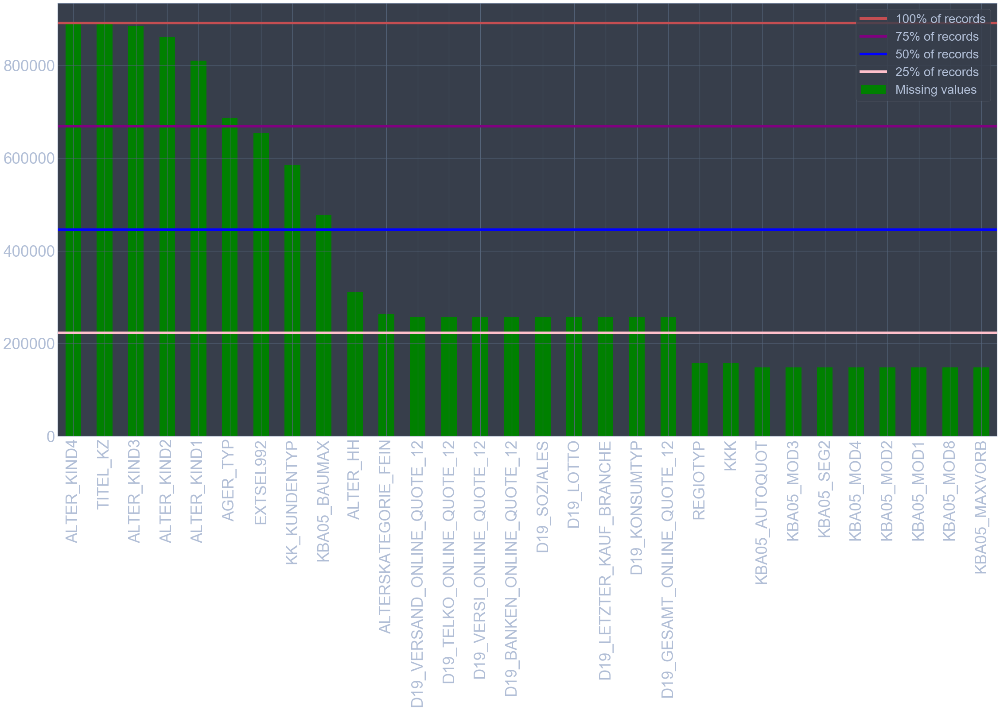

In [35]:
# Plotting the number of NaNs per feature
n_records = azdias.shape[0]
column_dist[:30].plot(kind='bar', figsize=(38,18), fontsize=35, color='green', label='Missing values')
plt.axhline(y = n_records, color='r', linewidth=6, label ='100% of records')
plt.axhline(y = n_records*0.75, color='purple', linewidth=6, label ='75% of records')
plt.axhline(y = n_records*0.5, color='blue', linewidth=6, label ='50% of records')
plt.axhline(y = n_records*0.25, color='pink', linewidth=6, label ='25% of records')
plt.legend(prop={'size':28});

We can see now that there are some columns that have nearly 100% missing values. After taking a further look at those columns, I decided to remove the ones showing more that 25 % of missing values. TITLE_KZ, AGER_TYP, KK_KUNDENTYP, KBA05_BAUMAX have more that 50% NAs. AGER_TYP is expected to have tons of NAs due to is a variable for elders, so everyone that is not elder will not have value here and it should be dropped (It could be re encoded with 0 for all the missing values). Same thing with the TITEL_KZ, which is the academic title and not everyone will have this populated. Also, the KK_KUNDENTYP is a customer flag and not everyone might be a customer.
Additionally, the columns starting with **'D19'** have the same amount of missing values, which is not suprinsing since they all belong to the same category: **Household**.
Lastly, there is no information for the columns starting with **ALTER_KIND** and **EXTSEL992**, and they have nearly 100% of missing values, so I will remove them. 


In [36]:
outlier_columns = column_dist.index[:20]
outlier_columns

Index(['ALTER_KIND4', 'TITEL_KZ', 'ALTER_KIND3', 'ALTER_KIND2', 'ALTER_KIND1',
       'AGER_TYP', 'EXTSEL992', 'KK_KUNDENTYP', 'KBA05_BAUMAX', 'ALTER_HH',
       'ALTERSKATEGORIE_FEIN', 'D19_VERSAND_ONLINE_QUOTE_12',
       'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSI_ONLINE_QUOTE_12',
       'D19_BANKEN_ONLINE_QUOTE_12', 'D19_SOZIALES', 'D19_LOTTO',
       'D19_LETZTER_KAUF_BRANCHE', 'D19_KONSUMTYP',
       'D19_GESAMT_ONLINE_QUOTE_12'],
      dtype='object')

In [37]:
# Removing the outlier columns from the dataset.
azdias.drop(outlier_columns, axis=1, inplace=True)

### Assess Missing Data in Each Row


Let's perform similar assesments for the rows of the dataset.

In [38]:
# How much data is missing in each row of the dataset?
rows_dist = azdias.isnull().sum(axis=1)
populated_rows = rows_dist[rows_dist[:] <= 0]

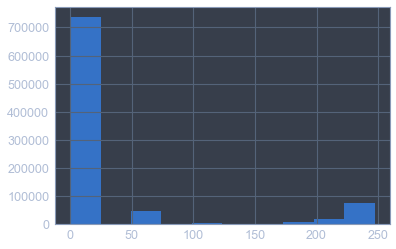

In [39]:
# Taking a look of the distribution or the NAs in the records
plt.hist(rows_dist);

In [40]:
n_columns = azdias.shape[1]
max_na = n_columns * 0.25
print('Maximum threshold for missing values: {}'.format(max_na))
# Lets divide the data into 2 subsets based on the number of missing values in each row, in
# this case we can use max_na as a threshold

na_rows_low = rows_dist[rows_dist < max_na]
na_rows_high = rows_dist[rows_dist >= max_na]

print(na_rows_low.shape, na_rows_high.shape)



Maximum threshold for missing values: 86.5
(785296,) (105925,)


Let's see if the distribution of data values on columns that are not missing data (or are missing very little data) are similar or different between the two subsets. 

In [41]:
# Comparing the distribution of values for at least five columns where there are
# no missing values, between the two subsets.

# Selection of columns with no missing values from 
populated_cols = random.choices(column_dist[(column_dist == 0) & (~column_dist.index.str.contains('D19'))].index, k=6)
populated_cols

['FINANZ_VORSORGER',
 'ZABEOTYP',
 'FINANZ_SPARER',
 'KOMBIALTER',
 'SEMIO_RAT',
 'FINANZ_SPARER']

In [42]:
# Taking a look at the rows >= 86 missing values  
azdias[populated_cols][azdias.index.isin(na_rows_high.index)].head()

,FINANZ_VORSORGER,ZABEOTYP,FINANZ_SPARER,KOMBIALTER,SEMIO_RAT,FINANZ_SPARER
0,3,3,4,9,4,4
11,3,3,4,9,4,4
14,3,3,4,9,4,4
15,5,3,1,4,3,1
17,3,3,4,9,4,4


In [43]:
def dist_data_plot(column):
    
    x_low = azdias[column][azdias.index.isin(na_rows_low.index)]
    x_high = azdias[column][azdias.index.isin(na_rows_high.index)]
    
    plt.subplot(1,2,1)
    sns.countplot(x = x_low, data=azdias)
    plt.title("Low NAs")
    
    plt.subplot(1,2,2)
    sns.countplot(x = x_high, data=azdias)
    plt.title("High NAs")

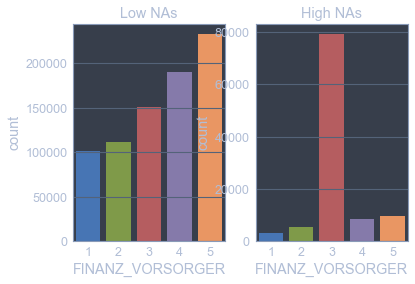

In [44]:
dist_data_plot(populated_cols[0])

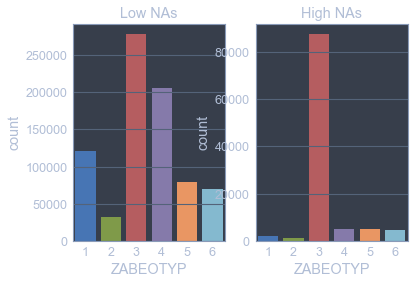

In [45]:
dist_data_plot(populated_cols[1])

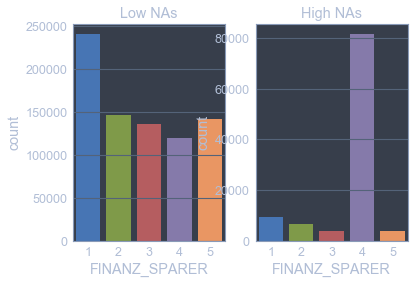

In [46]:
dist_data_plot(populated_cols[2])

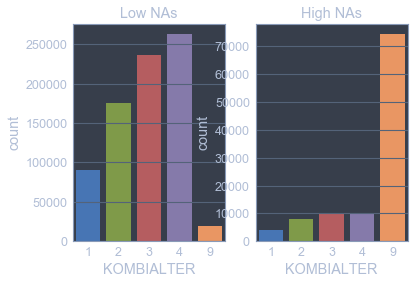

In [47]:
dist_data_plot(populated_cols[3])

There are 105925 rows that have 25 or more missing values. After plotting the frequency of missing values per category for each dataset (na_rows_high, na_rows_low), I noticed that there is no similarity in terms of how distributed are missing values between them. So, I decided to not to remove the data at this point, however, I will be using the na_rows_low moving forward. Also, I noticed that for the High missing values dataset, there is always a category that has very high frequescy in each plot.

In [70]:
# We will use the the low na dataset from now on
azdias_updated = azdias[azdias.index.isin(na_rows_low.index)].copy()

### Re-encode features

Since the unsupervised learning techniques to be used will only work on data that is encoded numerically, we need to make a few encoding changes or additional assumptions to be able to make progress. In addition, while almost all of the values in the dataset are encoded using numbers, not all of them represent numeric values. Let's consider the following:

- For numeric and interval data, these features can be kept without changes.
- Most of the variables in the dataset are ordinal in nature. While ordinal values may technically be non-linear in spacing, make the simplifying assumption that the ordinal variables can be treated as being interval in nature (that is, kept without any changes).
- Special handling may be necessary for the 'object' column types.

In [62]:
# In this part we will use the feature infor file I created before
feature_info['Type'].value_counts()

Ordinal        288
Categorical     19
Mixed            6
Numeric          1
Name: Type, dtype: int64

In [64]:
# Initializing categorical columns varible
categorical_cols = feature_info.Feature[feature_info.Type == 'Categorical'].copy()
categorical_cols

0      LP_FAMILIE_FEIN
1      LP_FAMILIE_GROB
4       LP_STATUS_FEIN
5       LP_STATUS_GROB
6     NATIONALITAET_KZ
7          OST_WEST_KZ
9          SHOPPER_TYP
10           SOHO_FLAG
11            TITEL_KZ
12            VERS_TYP
13           ANREDE_KZ
14       CJT_GESAMTTYP
15     CAMEO_DEUG_2015
16      CAMEO_DEU_2015
17           FINANZTYP
18         GEBAEUDETYP
19     GFK_URLAUBERTYP
20    GREEN_AVANTGARDE
21            ZABEOTYP
Name: Feature, dtype: object

In [65]:
# Dropping columns that are already removed TITEL_KZ due to missing values
categorical_cols.drop(labels=[10,11], inplace=True)

# Taking a look at the categorical columns in the dataset
azdias_updated[categorical_cols].describe()

,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,SHOPPER_TYP,VERS_TYP,ANREDE_KZ,CJT_GESAMTTYP,CAMEO_DEUG_2015,FINANZTYP,GEBAEUDETYP,GFK_URLAUBERTYP,GREEN_AVANTGARDE,ZABEOTYP
count,780737.000000,780737.000000,780737.000000,780737.000000,751968.000000,749211.000000,749211.00000,785296.000000,780737.000000,781298.000000,785296.000000,785296.000000,780737.000000,785296.000000,785296.000000
mean,3.794543,2.303360,4.780232,2.455677,1.168417,1.576115,1.51923,1.521630,3.502181,5.535735,3.804805,2.806788,7.469597,0.219894,3.381282
std,3.940592,1.727233,3.519843,1.511731,0.474536,1.026272,0.49963,0.499532,1.537081,2.489894,2.087161,2.663490,3.570075,0.414175,1.407523
min,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,2.000000,3.000000,2.000000,1.000000,4.000000,0.000000,3.000000
50%,1.000000,1.000000,4.000000,2.000000,1.000000,2.000000,2.00000,2.000000,4.000000,6.000000,4.000000,1.000000,8.000000,0.000000,3.000000
75%,8.000000,4.000000,9.000000,4.000000,1.000000,2.000000,2.00000,2.000000,5.000000,8.000000,6.000000,3.000000,11.000000,0.000000,4.000000
max,11.000000,5.000000,10.000000,5.000000,3.000000,3.000000,2.00000,2.000000,6.000000,9.000000,6.000000,8.000000,12.000000,1.000000,6.000000


In [66]:
# categorical columns and its unique values
for col in categorical_cols:
    print(azdias_updated[col].value_counts())

1.0     394916
10.0    127527
2.0      96957
11.0     48493
0.0      26321
8.0      21580
7.0      19281
4.0      11426
5.0      11062
9.0      10343
6.0       8272
3.0       4559
Name: LP_FAMILIE_FEIN, dtype: int64
1.0    394916
5.0    186363
2.0     96957
4.0     49133
3.0     27047
0.0     26321
Name: LP_FAMILIE_GROB, dtype: int64
1.0     203969
9.0     133607
10.0    110181
2.0     109949
4.0      73262
3.0      68066
6.0      28420
5.0      27005
8.0      17227
7.0       9051
Name: LP_STATUS_FEIN, dtype: int64
1.0    313918
2.0    168333
4.0    150834
5.0    110181
3.0     37471
Name: LP_STATUS_GROB, dtype: int64
1.0    657332
2.0     62628
3.0     32008
Name: NATIONALITAET_KZ, dtype: int64
W    619181
O    166115
Name: OST_WEST_KZ, dtype: int64
1.0    242672
2.0    203473
3.0    177075
0.0    125991
Name: SHOPPER_TYP, dtype: int64
2.0    389013
1.0    360198
Name: VERS_TYP, dtype: int64
2    409634
1    375662
Name: ANREDE_KZ, dtype: int64
4.0    194888
3.0    144719
2.0    13960

In [67]:
cat_col = obtain_categorical_columns(azdias_updated)
cat_col

{'multi': ['LP_FAMILIE_FEIN',
  'LP_FAMILIE_GROB',
  'LP_STATUS_FEIN',
  'LP_STATUS_GROB',
  'NATIONALITAET_KZ',
  'SHOPPER_TYP',
  'CJT_GESAMTTYP',
  'CAMEO_DEUG_2015',
  'FINANZTYP',
  'GEBAEUDETYP',
  'GFK_URLAUBERTYP',
  'ZABEOTYP'],
 'binary': ['OST_WEST_KZ', 'VERS_TYP', 'ANREDE_KZ', 'GREEN_AVANTGARDE']}

In [71]:
# After taking a better look at the unique values for the categorical columns, 
# I noticed the binary column OST_WEST_KZ has not numerical values 
# and the CAMEO_DEU_2015 has 44 unique values

# Re-encoding the binary column OST_WEST_KZ with numerical values
azdias_updated['OST_WEST_KZ'].replace(['W','O'], [1,0], inplace=True)

# Dropping the CAMEO_DEU_2015 since it will add several additional columns
# when re-encoding it
azdias_updated.drop('CAMEO_DEU_2015', axis=1, inplace=True)

In [72]:
# For the multi level columns, I will use get_dummies
azdias_updated = pd.get_dummies(azdias_updated, columns=cat_col['multi'])
azdias_updated.head()

,LNR,AKT_DAT_KL,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CAMEO_INTL_2015,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,D19_BILDUNG,D19_BIO_OEKO,D19_BUCH_CD,D19_DIGIT_SERV,D19_DROGERIEARTIKEL,D19_ENERGIE,D19_FREIZEIT,D19_GARTEN,D19_GESAMT_ANZ_12,D19_GESAMT_ANZ_24,D19_GESAMT_DATUM,...,CAMEO_DEUG_2015_1.0,CAMEO_DEUG_2015_2.0,CAMEO_DEUG_2015_3.0,CAMEO_DEUG_2015_4.0,CAMEO_DEUG_2015_5.0,CAMEO_DEUG_2015_6.0,CAMEO_DEUG_2015_7.0,CAMEO_DEUG_2015_8.0,CAMEO_DEUG_2015_9.0,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_5.0,GEBAEUDETYP_6.0,GEBAEUDETYP_8.0,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,ZABEOTYP_1,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6
1,910220,9.0,11.0,0.0,0.0,2.0,12.0,0.0,3.0,6.0,51.0,1.0,5.0,5.0,2.0,3.0,1.0,1.0,0,0,10,0,0,0,10,10,0,0,0,0,0,0,0,0,0,0,0,0,0,10,...,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
2,910225,9.0,10.0,0.0,0.0,1.0,7.0,0.0,3.0,2.0,24.0,2.0,4.0,4.0,1.0,3.0,2.0,2.0,0,0,10,0,0,0,10,10,0,0,0,6,0,0,0,0,0,0,0,0,0,10,...,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
3,910226,1.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,4.0,12.0,3.0,2.0,2.0,4.0,4.0,5.0,3.0,0,0,10,0,0,0,10,10,0,0,0,0,0,6,0,0,0,0,0,0,0,10,...,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
4,910241,1.0,3.0,0.0,0.0,4.0,3.0,0.0,4.0,2.0,43.0,3.0,3.0,3.0,3.0,4.0,3.0,3.0,3,5,5,1,2,0,10,5,6,6,1,6,0,6,0,1,5,0,0,6,6,1,...,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
5,910244,1.0,5.0,0.0,0.0,1.0,2.0,0.0,2.0,6.0,54.0,5.0,2.0,1.0,5.0,5.0,3.0,3.0,0,0,10,0,0,0,10,10,0,0,0,0,0,0,0,0,3,0,0,1,1,3,...,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


After looking at the categorical columns, I decided to drop the CAMEO_DEU_2015 since has 44 unique values that would add several columns to the dataset once it is enconded. The rest columns, I decided to keep them since I don't want to lose too much information. As mentioned above, I use get_dummies to enconde t

In [73]:
# Now, let's see the mixed variables
mixed_cols = feature_info.Feature[feature_info.Type == 'Mixed']
mixed_cols

2        LP_LEBENSPHASE_FEIN
3        LP_LEBENSPHASE_GROB
8      PRAEGENDE_JUGENDJAHRE
32        CAMEO_DEUINTL_2015
290              PLZ8_BAUMAX
311                 WOHNLAGE
Name: Feature, dtype: object

In [74]:
# Need to change the name of the column manually here
mixed_cols.loc[32] = 'CAMEO_INTL_2015'

In [75]:
for col in mixed_cols:
    print(azdias_updated[col].value_counts())
    
azdias_updated[mixed_cols].describe()

1.0     57998
5.0     51712
0.0     44684
6.0     42500
2.0     36626
8.0     28408
7.0     24690
29.0    24630
13.0    24420
11.0    24402
10.0    23489
31.0    22110
12.0    21615
30.0    20917
15.0    18784
3.0     18428
19.0    18213
37.0    17264
4.0     16291
20.0    16173
14.0    16077
32.0    15624
39.0    15055
40.0    14064
16.0    13495
27.0    13457
38.0    12946
35.0    12877
34.0    12213
21.0    11890
9.0     11754
28.0    11392
24.0    11226
25.0     9723
36.0     9584
23.0     8400
22.0     6757
18.0     6424
33.0     5682
17.0     5408
26.0     3335
Name: LP_LEBENSPHASE_FEIN, dtype: int64
2.0     147310
1.0     129343
3.0     106262
12.0     68913
4.0      50570
5.0      46218
9.0      45547
0.0      41888
10.0     37734
11.0     30772
8.0      28184
6.0      27047
7.0      20949
Name: LP_LEBENSPHASE_GROB, dtype: int64
14.0    180109
8.0     139159
10.0     84454
5.0      83746
3.0      53163
15.0     41672
11.0     35112
9.0      33129
6.0      25442
12.0     24137
1

,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,PRAEGENDE_JUGENDJAHRE,CAMEO_INTL_2015,PLZ8_BAUMAX,WOHNLAGE
count,780737.000000,780737.000000,757773.000000,781298.000000,773800.000000,785296.000000
mean,15.408821,4.692012,9.272731,35.488176,1.943887,4.057004
std,12.481881,3.815363,4.027087,14.033760,1.459549,1.941456
min,0.000000,0.000000,1.000000,12.000000,1.000000,0.000000
25%,5.000000,2.000000,6.000000,24.000000,1.000000,3.000000
50%,12.000000,3.000000,9.000000,41.000000,1.000000,3.000000
75%,27.000000,8.000000,14.000000,51.000000,3.000000,5.000000
max,40.000000,12.000000,15.000000,55.000000,5.000000,8.000000


For the column **PRAEGENDE_JUGENDJAHRE**, we are going to engineer two new variables out of this one. First, let's see the column definition: it combines information on three dimensions: generation by decade, movement (mainstream vs. avantgarde), and nation (east vs. west). While there aren't enough levels to disentangle east from west, we should create two new variables to capture the other two dimensions: an interval-type variable for decade, and a binary variable for movement.

**PRAEGENDE_JUGENDJAHRE**
Dominating movement of person's youth (avantgarde vs. mainstream; east vs. west)
- -1: unknown
-  0: unknown
-  1: 40s - war years (Mainstream, E+W)
-  2: 40s - reconstruction years (Avantgarde, E+W)
-  3: 50s - economic miracle (Mainstream, E+W)
-  4: 50s - milk bar / Individualisation (Avantgarde, E+W)
-  5: 60s - economic miracle (Mainstream, E+W)
-  6: 60s - generation 68 / student protestors (Avantgarde, W)
-  7: 60s - opponents to the building of the Wall (Avantgarde, E)
-  8: 70s - family orientation (Mainstream, E+W)
-  9: 70s - peace movement (Avantgarde, E+W)
- 10: 80s - Generation Golf (Mainstream, W)
- 11: 80s - ecological awareness (Avantgarde, W)
- 12: 80s - FDJ / communist party youth organisation (Mainstream, E)
- 13: 80s - Swords into ploughshares (Avantgarde, E)
- 14: 90s - digital media kids (Mainstream, E+W)
- 15: 90s - ecological awareness (Avantgarde, E+W)

In [76]:
# Mapping for mainstream
mainstream = (1,3,5,8,10,12,14)

In [77]:
# Maintream -> 0 and Avantgarde -> 1

col_move= np.where(azdias_updated['PRAEGENDE_JUGENDJAHRE'].isin(mainstream), 0, 
                   np.where(azdias_updated['PRAEGENDE_JUGENDJAHRE'].notnull(), 1, np.nan))
for col1, col2 in zip(azdias_updated['PRAEGENDE_JUGENDJAHRE'],col_move):
    print(col1,col2)

14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0

11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.

14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
nan nan
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
11.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.

nan nan
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
6.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
14

8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0

14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
3.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
4.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
4.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
1

14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
2.0 1.0
1.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
1.0 0.

10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.

14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
4.0 1.0
5.0 0.0
3.0 0.0
nan nan
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
4.0 1.

15.0 1.0
3.0 0.0
nan nan
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
11.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0

9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
nan nan
15.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
5.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0

14.0 0.0
2.0 1.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
nan nan
8.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
nan nan
8.0 0.0
3.0 0.0
9.0 1.0
13.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
nan nan
9.0 1.0
6.0 1.0
10.0 0.0
2.0

12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
nan nan
8.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
1.0 0.0
3.0 

8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
nan nan
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
2.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.

8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
15.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0

14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
nan nan
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.

15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
4.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
nan nan
4.0 1.0
5.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.

10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
9.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
nan nan
3.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 

8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
13.0 1.0
13.0 1.0
nan nan
8.0 0.0
1.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
7.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14

3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
11.0 1.0
15.0 1.0
2.0 1.0
6.0 1.0
14.0 0.0


10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
3.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
nan nan
9.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
nan nan
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
nan nan
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0


10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
13.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0

14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
nan nan
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10

8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0

nan nan
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
2.0 1.0
nan nan
14.0 0.0
12.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
nan nan
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.

5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
nan nan
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0

14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
11.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
nan nan
5.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0


14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
nan nan
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.

14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
4.0 1.0
nan nan
7.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 

8.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
9.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
9

15.0 1.0
3.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
1.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
nan nan
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
2.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
2.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0

14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan nan
5.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
7.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
1.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
nan nan
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0

5.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
11.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
7.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0

3.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
nan nan
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0


8.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
4.0 1.0
nan nan
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
nan nan
9.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
2.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
13.0 1.0
7.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
14.0 0

3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
1.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0

5.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
4.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
nan nan
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
nan nan
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.

1.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
nan nan
3.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
9.0 1.0
14.0 0.0
2.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
12.0 0.0
nan nan
12.0 0.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
nan nan
15.0 1.0
10.0 0.0


1.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
nan nan
1.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
2.0 1.0
11.0 1.0
nan nan
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
6.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 

13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
11.0 1.0
4.0 1.0
1

9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0

14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.

9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 

10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
13.0 1.0
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
9.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0


10.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0

5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
2.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0


8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0

14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 

9.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
4.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
2.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.

14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
6.0 1.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
nan nan
6.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8

14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
15.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
15.0 1

6.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.

10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
9.0 1.0
11.0 1.0
2.0 1.0
1.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
9.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
12.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.

8.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
nan nan
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
2.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0

11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
2.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
nan nan
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10

8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
nan nan
1.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10

5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.

3.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
nan nan
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14

14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
13.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
2.0 1.0
3.0 0.

12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
nan nan
11.0 1.0
nan nan
nan nan
3.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
nan nan
11.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
2.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
9.0

10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
2.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
nan nan
6.0 1.0
15.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14

14.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
nan nan
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
11.0 1.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
nan nan
3.0 0.0
1.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
13.0 1.0
12.0 0.0
1

14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 

5.0 0.0
14.0 0.0
nan nan
14.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
10.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
12.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0

3.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
nan nan
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
nan nan
3.0 0.0
6.0 1.0
10.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.

8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
3

6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
14.

8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
nan nan
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 

14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
nan nan
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
1.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
nan nan
4.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0


5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
7.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0


8.0 0.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
11.0 1.0
9.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
10

14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
nan nan
8.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
1.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0

8.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
11.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
15.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
11.0 1.0
9.0 1.0
4.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
2.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0

12.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
8.0 0.

3.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
2.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0

8.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
nan nan
3.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
3.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
6.0 1.0
nan nan
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8

14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
nan nan
8.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
1.0 0.

8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.

5.0 0.0
nan nan
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
1.0 0.0
4.0 1.0
9.0 1.0
1.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
13.0 

8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
15.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
9.0 1.0
11.0 1.0
9.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0

10.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
nan nan
1.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0


4.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
6.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
2.0 1.0
9.0 1.0
nan nan
9.0 1.0
nan nan
10.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
6.0 1.0
nan nan
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.

5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
1.0 0.0
nan nan
13.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.

15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
7.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15

10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
nan nan
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
nan nan
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
5.0

10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
1.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
1

8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
13.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
nan nan
15.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
nan nan
8.0

14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
14.0 

10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
nan nan
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
2.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0

9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
1.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
1

14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
nan nan
4.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
nan nan
5.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
4.0 1.0
4.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.

14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.

5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
nan nan
6.0 1.0
6.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0

8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
2.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
6.0 1.0
15.0 1.0
nan nan
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
nan nan
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
nan nan
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0

8.0 0.0
nan nan
10.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
13.0 1.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
nan nan
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.

10.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
13.0 1.0
8.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0


14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
14.0 0.0
nan nan
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
nan nan
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
6.0 

8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
4.0 1.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
9

9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
2.0 1.0
7.0 1.0
5.0 0.0
13.0 1.0
7.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.

15.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
nan nan
10.0 0.0
6.0 1.0
8.0 0.0
nan nan
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
6.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
nan nan
7.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
5.0

14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
nan nan
9.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
nan nan
3.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
4.0 1.0
9.0 1.0
9.0 1.0

14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
15.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
nan nan
1.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
13.0 1.0
5.0 0.0

12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
13.0 1.0
7.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
2.0 1.0
14.0 0.0
nan nan
2.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0

15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
nan nan
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
nan nan
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
nan nan
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0


14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
4.0 1.0
7.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0

10.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
9.0 1.0
4.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.

6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
nan nan
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
nan nan
5.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0

14.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
nan nan
12.0 0.0
nan nan
14.0 0.0
9.0 1.0
13.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
13.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
7.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
13.0 1.0
7.0 1.0
12.0 0.0
nan nan
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0

8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
9.0

10.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
nan nan
10.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
10.0

15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
6.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
8.

6.0 1.0
8.0 0.0
15.0 1.0
nan nan
13.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.

15.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
11.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
nan nan
1.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
nan nan
6.

5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
9.0 1.0
6.0 1.0
9.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
nan nan
3.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
6.0 1.0
11.0 1.0
10

14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
13.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
7.0 1.0
3.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15

15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
nan nan
14.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
nan nan
5.0 0.0
4.0 1.0
12.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0

14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
9.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
nan nan
4.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
2

nan nan
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
nan nan
6.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
15.0 1.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3

nan nan
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
6.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
nan nan
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
nan nan
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0

5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0

14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
6.0 1.0
12.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
6.0 1.0
15.0 1.0
11.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
3.0 0.0
4.0 1.0
10.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
nan nan
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
9.0 1.0
15.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
8.0 

2.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
nan nan
9.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
12.0 0.0
7.0 1.0
12.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
13.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
nan nan
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0


nan nan
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
4.0 1.0
9.0 1.0
12.0 0.0
1.0 0.0
4.0 1.0
2.0 1.0
3.0 0.0
8.0 0.0
14.

5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
nan nan
1.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
13.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
13.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
nan nan
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
1.

15.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
nan nan
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
nan nan
10.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
nan nan
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.

14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
3.

10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
nan nan
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
nan nan
3.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.

14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
nan nan
11.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0

14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
9.0 1.0
2.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0

14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
nan nan
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
11.

nan nan
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
nan nan
6.0 1.0
nan nan
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0

1.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
4.0 1.0
4.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
13.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
5.0 0.

3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.

6.0 1.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0

5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
2.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
5.0 0.0
2.0 1.0
8.0 0.0
nan nan
6.0 1.0
5.0 0.0
9.0 1.0
11.0 1.0
1.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
nan nan
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
3.

8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
nan nan
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0
14.0 0.0
12.0 0.0
2.0 1.0
3.

8.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
2.0 1.0
nan nan
5.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
9.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
4.0 1.0
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
1.0 0.0
nan nan
3.0 0.

14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0

2.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
nan nan
nan nan
3.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
nan nan
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
1.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.

15.0 1.0
15.0 1.0
3.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
nan nan
12.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0

14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
nan nan
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
nan nan
11.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
1.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
11

3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
1.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
1.0 0.0


8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 

10.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
nan nan
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
9.0 1.0
2.0 1.0
4.0 1.0
7.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
2.0 1.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
11.

5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
nan nan
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
1

11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
nan nan
14.0 0.0
3.0 0.0
nan nan
9.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
nan nan
1.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
15.

5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
12.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.

8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
13.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.

14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
nan nan
8.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0

3.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0

10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
nan nan
1.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
2.0 1.0
1.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0


nan nan
15.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
nan nan
nan nan
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.

14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
1

12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
6.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
nan nan
10.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
9.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
8.

14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
3.0 0.0
nan nan
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
1

5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
2.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
7.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
5.

8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
nan nan
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
nan nan
11.0 1.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 

14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
nan nan
13.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
nan nan
10.0 0.0
9.0 1.0
nan nan
1.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
1.0

14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
nan nan
9.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.

14.0 0.0
2.0 1.0
6.0 1.0
15.0 1.0
9.0 1.0
2.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
nan nan
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 

8.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
5.0 0.0
nan nan
9.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
3.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 

14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
1.0 0.0
12.0 0.0
13.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
11.0 1.

5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
nan nan
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
nan nan
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0

8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
2.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0


nan nan
1.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
4.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
nan nan
11.0 1.0
11.0 1.0
10.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5

14.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
nan nan
5.0 0.0
3.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
nan nan
14.0 0.0
1.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
10.0

2.0 1.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
nan nan
8.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
nan nan
6.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0

14.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
nan nan
8.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
6.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0


8.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
1.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
11.0 1.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 

3.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
nan nan
5.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
13.0 1.0
13.0 1.0
4.0 1.0
nan nan
14.0 0.0
nan nan
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
nan nan
15.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.

14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
nan nan
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
nan nan
4.0 1.0
3.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
nan nan
11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0


14.0 0.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
nan nan
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0

14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
4.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
nan nan
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.

14.0 0.0
11.0 1.0
11.0 1.0
nan nan
8.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
2.0 1.0
7.0 1.0
14.0 0.0
nan nan
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
7.0 1.0
12.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0

15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
1.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
nan nan
2.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
2.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
11.0 1.

10.0 0.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
9.0 1.0
nan nan
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
nan nan
5.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0

8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
15.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
nan nan
4.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
4.0 1.0
2.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
nan nan
4.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0

14.0 0.0
5.0 0.0
9.0 1.0
7.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
13.0 1.0
12.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 

14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
nan nan
15.0 1.0
4.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
nan nan
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
6.0 1.0
1.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0

14.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
nan nan
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1

10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
nan nan
6.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0

8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 

11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
3.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
2.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
nan nan
14.0 0.0
1.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.

14.0 0.0
10.0 0.0
nan nan
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
nan nan
nan nan
6.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.

5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
nan nan
9.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
14

13.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
nan nan
8.0 0.0
14.0 0.0
13.0 1.0
7.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
3

8.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
nan nan
13.0 1.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
10.0 0.0
10.0 0.0
nan nan
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.

13.0 1.0
4.0 1.0
12.0 0.0
1.0 0.0
13.0 1.0
12.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0


11.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
nan nan
3.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0

14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
nan nan
14.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
10.0 0.

8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
9.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
5.0 0.0
5.0 0.

11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
nan nan
3.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
1.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0

6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
1.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8

9.0 1.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
2.0 1.0
3.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0


11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.

12.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
9.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
nan nan
nan nan
10.0 0.0
10.0 0.0
nan nan
2.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
nan nan
11.0 1.0
14.0 0.0
9.0 1.0
7.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
7.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
nan nan
nan nan


nan nan
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
1.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
7.0 1.0
nan nan
14.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
13.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
3.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0

7.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
12.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0

14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
nan nan
6.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
9.0 1.0
3.0 0.0
4.0 1

10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
nan nan
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
5.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0

11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
nan nan
3.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
nan nan
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
nan nan
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
10.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
1

8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
10.0 0.0
11.0 1.0

14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
7.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
1

8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
nan nan
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
nan nan
10.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0

9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
2.0 1.0
9.0 1.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
2.0 1.0
4.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
5.0 

9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
nan nan
14.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 

nan nan
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
4.0 1.0
5.0 0.0
11.0 1.0
nan nan
9.0 1.0
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
4.0 1.0
nan nan
nan nan
1.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
4.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
nan nan
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0


14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
1.0 0.0
1.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
10.0 

12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
nan nan
14.0 0.0
nan nan
11.0 1.0
nan nan
10.0 0.0
10.0 0.0
12.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0

14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
2.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 

8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
nan nan
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
10.0 

3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0

5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 

8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
nan nan
15.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
3.0 

14.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
nan nan
5.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
5.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
nan nan
6.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14

5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
nan nan
6.0 1.0
8.

11.0 1.0
6.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
nan nan
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
10.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
nan nan
11.0 1.0
11.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
4.0 1.0


9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
nan nan
3.0 0.0
8.0 0.0
9.0 1.0
nan nan
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14

10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
10.0

10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
9.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
nan nan
1.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.

14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
nan nan
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
nan nan
15.0 1.0
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0

14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0

10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0

8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
nan nan
10.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0

14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
nan nan
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
1.0 0.0
nan nan
3.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
nan nan
10.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
4.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
na

10.0 0.0
4.0 1.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
11.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
nan nan
2.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14

14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
nan nan
10.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
nan nan
5.0 0.0
6.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.

3.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
13.0 1.0
13.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
nan nan
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.

5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
nan nan
3.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5

9.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
4

5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
nan nan
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0


14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
nan nan
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
nan nan
8.0 0.0
14

14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
nan nan
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
1.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
8.0

1.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0

12.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
nan nan
3.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
2.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
nan nan
5.0 0.0
11.0 1.0
nan nan
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
4.0 1.0
2.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0

4.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
nan nan
6.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
nan nan
9.0 1.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
4.0

11.0 1.0
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
13.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
nan nan
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
11.0 1.0
15.0 1.0
nan nan
10.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
15.0 1.0
2.0 1.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 

8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
4.0 1.0
14.0 0.0
6.0 1.0
nan nan
10.0 0.0
nan nan
8.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0

5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
15.0 1.0
9.0 1.0
1.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
9.0 

3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
7.0 1.0
13.0 1.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.

6.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
1.0 0.0
5.0 0.0
9.0 1.0
nan nan
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0

8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
4.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
1.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
4.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
1.0 0.0
3.0 0.0
11.0 1.0
2.0 1.0
5.0 0.0
11.0 1.0
1.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0


1.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
15.0 1.0
15.0 1.0
2.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0


6.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
nan nan

9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
nan nan
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.

12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
nan nan
11.0 1.0
8.0 0.0
15.0 1.0
nan nan
6.0 1.0
1.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
1.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0


14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
nan nan
7.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
9.0 1.0
nan nan
10.0 0.0
14

6.0 1.0
9.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
1.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
nan nan
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0


8.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
2.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
nan nan
9.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0

15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
9.0 1.0
7.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
13.0 1.0
1.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
3.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
13.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.

10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
3.0 0.0
13.0 1.0
7.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0

11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
1.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
14.0 0.0
13.0 1.0
7.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 

10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
2.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
1.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan


15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
nan nan
3.0 0.0
nan nan
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
1.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.

14.0 0.0
15.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
15.0 1.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0

4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
9.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1

14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
13.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
11.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0

14.0 0.0
nan nan
10.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
3.0 0

5.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.

8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
13.0 1.0
5.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
2.0 1.0
15.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
9.0 1.0
6.0 1.0
6.0 1.0
1.0

3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
7.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
13.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
nan nan
9.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 

8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
13.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
6.0 1.0
9.0 1.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
nan 

15.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
2.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
nan nan
9.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
nan nan
nan nan
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
8.0 0.0
1

6.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
8.0 

4.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
nan nan
8.0 0.0
1.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
2.0 1.0

9.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
nan nan
3.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
9.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
3

8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
4.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
15.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
7.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
7.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
1.0 0.0
6.0

8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1

4.0 1.0
9.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0

15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
3.0 0.0
nan nan
5.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
7.0 1.0
nan nan
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
nan nan
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 

8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
4.0 1.0
14.

5.0 0.0
9.0 1.0
6.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
nan nan
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15

12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
nan nan
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0

10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
7.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
6.0 1.0
nan nan
10.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.

14.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1

9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0

15.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0

10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
8.0

11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
2.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
6.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
1.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
7.0 1.0
12.

8.0 0.0
10.0 0.0
15.0 1.0
nan nan
11.0 1.0
14.0 0.0
nan nan
10.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
nan nan
1.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
13.0 1.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
nan nan
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0

5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
nan nan
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
4.0 1.0
nan nan
14.0 0.0
1.0 0.0
nan nan
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0


14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.

10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
nan nan
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0


8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
9.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
nan nan
4.0 1.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0

3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
9.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.

8.0 0.0
nan nan
15.0 1.0
5.0 0.0
nan nan
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
4.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
13.0 1.0
13.0 1.0
12.0 0.0
13.0 1.0
2.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
13.0 1.0
13.0 1.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
7.0 1.0
13.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan n

3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
1.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0

14.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
nan nan
10.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.

9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
5.0 0.0
nan nan
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
nan nan
nan nan
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
na

8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
6.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
9.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.

14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
nan nan
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
1.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.

11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
4.0 1.0
8.

nan nan
3.0 0.0
5.0 0.0
13.0 1.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
2.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0

8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
12.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
7.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
15.0 1.0
nan nan
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
2.0 1.0
9.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
1

5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
5.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
2.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14

14.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0

5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
nan nan
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0

8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
13.0 1.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
7.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
6.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
9.0 1.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
nan nan
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
3.

3.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
nan nan
nan nan
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
1.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
nan nan
2.0 1.0
14.0 0.0
15.0 1.0

8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
2.0 1.0
5.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
2.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
nan nan
14.0

9.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
nan nan
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
nan nan
6

15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
nan nan
5.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
nan nan
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
4.0 1.0
5.0 0.0
10.

10.0 0.0
15.0 1.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
13.0 1.0
1.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
nan nan
11.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
10.0 0.0
2.0 1.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14

14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
12.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
1.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
nan nan
4.0 1.0
5.0 0.0
7.0

10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
nan nan
7.0 1.0
13.0 1.0
3.0 0.0
8.0 0.0
13.0 1.0
9.0 1.0
3.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 

4.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
7.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
nan nan
3.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
12.0 0.0
4.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
1

1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
nan nan
11.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
4.0 1.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
nan nan
12.0 0.0
nan nan
nan nan
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
2.0 1.0
6.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0

9.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
nan nan
1.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.

14.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
2.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
nan nan
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
9.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
4.0 1.0
2.0 1.0
5.0 0.0
nan nan
12.0 0.0
13.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0

1.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
nan nan
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
nan nan
11.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
nan nan
15.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 

14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
13.0 1.0
3.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
3.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0

14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
7.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
4.0 1.0
10.0 0.0
nan nan
nan nan
4.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.

3.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
1.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
nan nan
nan nan
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 

5.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
7.0 1.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
2.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
nan nan
nan nan
4.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
15.0 1.0
nan nan
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
6.0 1.0
2.0

10.0 0.0
nan nan
8.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
2.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 

9.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
nan nan
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
3.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
nan nan
4.0 1.0
8.0 0.0
15.0 1.0
nan nan
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.

5.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
3.0 0.0
nan nan
10.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
1.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0

5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
11.0 1.0
5.0 0.0
9.0 1.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 

14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0


12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
1.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
nan nan
12.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
11.0 1.0
4.

14.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
15.0 1.0
6.0 1.0
15.0 1.0
4.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
14

11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
2.0 1.0
9.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
15.0 1.0
4.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
nan nan
5.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
nan nan
8.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
6.0 1.0
14.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0

10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
12.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
nan nan
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
nan nan
nan nan
nan nan
8.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
4.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
nan nan
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
2.0 1.0
nan nan
14.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.

3.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
13.0 1.0
12.0 0.0
13.0 1.0
nan nan
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
nan nan
3.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
15.0 1.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
10.0 0.

14.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
9.0 1.0
7.0 1.0
14.0 0.0
4.0 1.0
12.0 0.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
nan nan
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
7.0 1.0
12.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
1.0 0.

11.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
nan nan
11.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
11.0 1.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
4.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
8

3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
1.0 0.0
nan nan
6.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
nan nan
nan nan
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0

8.0 0.0
14.0 0.0
2.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
4.0 1.0
14.0 0.0
10.0

8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
4.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
4.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
14.

8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
9.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
2.0 

9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
6.0 1.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
7.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
13.0 1.0
nan n

14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
9.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0

14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
3.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
2.0 1.0
10.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
9.0 1.0
1.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
2.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
nan nan
11.0 1.0
9.0 1.0
nan nan
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0

14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
nan nan
8.0 0.0
6.0 1.0
11.0 1.0
4.0 1.0
4.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
6.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
4.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
6.0

12.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
nan nan
5.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
2.0 1.0
5.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
9.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1

15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
6.0 1.0
1.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
nan nan
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
2.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0

14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
nan nan
5.0 0.0
9.0 1.0
nan nan
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
nan nan
14.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
1.0 0.0
nan nan
4.0 1.0
6.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0

5.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
1.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
nan nan
4.0 1.0
9.0 1.0
4.0 1.0
nan nan
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0

9.0 1.0
9.0 1.0
4.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
2.0 1.0
2.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
2.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
1

14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
4.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
6.0 1.0
nan nan
15.0 1.

4.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
2.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
nan nan
9.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
15.0 1.0
5.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
nan nan
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
nan nan
11.0 1.0
11.0 1.0
11.0 1.0
4.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
1

8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
nan nan
5.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
2.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
6.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
4.0 1.0
2.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
5.0 

9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
1.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0

4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
2.0 1.0
10.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
nan nan
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
nan nan
6.0 1.0
11.0 1.0
nan nan
15.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
nan nan
10.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.

15.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
nan nan
11.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
7.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
2.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
nan nan
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14

14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
9.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0

8.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
nan nan
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0

15.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
6.0 1.0
1.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
7.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0

5.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0

6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
4.0 1.0
15.0 1.0
nan nan
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
1.0 0.0
3.0 0.0
4.0 1.0
6.0 1.0
12.0 0.0
14.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
9.0 1.0
4.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
nan nan
11.0 1.0
11.0 1.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
nan nan
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
11.0 1.0
2.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0


15.0 1.0
5.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
nan nan
nan nan
4.0 1.0
12.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
nan nan
nan nan
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.

10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
nan nan
1.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
3.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.

5.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
1.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
nan nan
15.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
2.0 1.0
4.0 1.0
8.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
1

5.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
4.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
1

1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
1.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
nan nan
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
11.0 1

10.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
1.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
4.0 1.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
2.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0

9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
nan nan
10.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
4.0 1.0
nan nan
10.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
15.0 1.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
nan nan
5.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
4.0 1

4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
nan nan
3.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
12.0 0.0
13.0 1.0
3.0 0.0
12.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 

8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
nan nan
3.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.

10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
9.0 1.0
7.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0

11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
1.0 0.0
nan nan
9.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
nan nan
nan nan
6.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
nan nan
10.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
nan nan
11.0 1.0
10.0

8.0 0.0
3.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
nan nan
11.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
2.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0


3.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
15.0 1.0
4.0 1.0
6.0 1.0
6.0 1.0
4.0 1.0
1.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
nan nan
1.0 0.0
13.0 1.0
1.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
nan nan
1.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
3.0 0.0
1.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0


10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
14.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
nan nan
5.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
5.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0

nan nan
5.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
11.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
11.0 1.0
6.0 1.0
1.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
2.0 1.0
4.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
4.0 1.0
4.0 1.0
nan nan
5.0 0.0
4.0 1.0
8.0 0.0
10.0 0

5.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
nan nan
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
4

8.0 0.0
nan nan
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
4.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
11.0 1.0
1.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
nan nan
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
6.0 1.0
2.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
nan nan
8.0 0.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0

14.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0

4.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
5.0 0.0
4.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
nan nan
11.0 1.0
15.0 1.0
5.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
4.0 1.0
1.0 0.0
4.0 1.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
6.0 1.0
12.0 0.0
nan nan
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
nan nan
14.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
6.0 1.0
14.0 0.0
8.0

8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
nan nan
10.0 0.0
14.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0


10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
nan nan
10.0 0.0
1.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
6.0 1.0
5.0 0.0
10.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10

8.0 0.0
9.0 1.0
11.0 1.0
6.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
11.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
15.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
5.0 0.0
7.0 1.0
2.0 1.0
4.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
15

5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
nan nan
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
13.0 1.0
13.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
4.0 1

8.0 0.0
12.0 0.0
5.0 0.0
7.0 1.0
4.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
nan nan
nan nan
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
5

5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
15.0 1.0
2.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
nan nan
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
9.0 1

1.0 0.0
8.0 0.0
3.0 0.0
nan nan
14.0 0.0
15.0 1.0
9.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
13.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
nan nan
9.0 1.0
12.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
nan nan
1.0 0.0
5.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
10.0 0.0
nan nan
8.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0

5.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
nan nan
8.0 0.0
10.0 0.0
9.0 1.0
nan nan
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
4.0 1.0
10.0 0.0
nan nan
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
1.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
9.0 1.0
7.0 1.0
12.0 0.0
1.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
nan nan
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
2.0 1.0
2.0 1.0
nan nan
5.0 0.0
15.0 1.0
14.

5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
7.0 1.0
nan nan
5.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
nan nan
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10

11.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
nan nan
5.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
3.0 0.0
1.0 0.0
9.0 1.0
2.0 1.0
3.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
nan nan
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
4.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 

5.0 0.0
12.0 0.0
8.0 0.0
1.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
nan nan
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
15.0 1.0
6.0 1.0
15.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
nan nan
12.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
9.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
5.0 0.

15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
8.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
nan nan
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
2.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
nan nan
9.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
2.0 1.0
9.0 1.0
9.0 1

10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
nan nan
12.0 0.0
3.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 

10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
nan nan
5.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
3.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
7.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
nan na

nan nan
15.0 1.0
10.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
nan nan
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
8.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
nan nan
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
1.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0

14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0

11.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
6.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
15.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
9.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
11.0

nan nan
3.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
2.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
13.0 1.0
8.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
9.0 1.0
1.0 0.0
12.0 0.0
2.0 1.0
9.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0
3.0 0.0
1.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
12.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
nan nan
nan nan
14.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
7.0 1.0
12.0 0.0
12.0 0.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
3

5.0 0.0
8.0 0.0
11.0 1.0
nan nan
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
11.0 1.0
nan nan
14.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
nan nan
10.0 0.0
8.0 0.0
6.0 1.0
2.0 1.0
4.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
nan nan
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
nan nan
14.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
nan nan
3.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
1.0 0.0
3.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
11.

5.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
nan nan
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
nan nan
3.0 0.0
13.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
nan nan
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
13.0 1.0
8.0 0.0
12.0

10.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
1.0 0.0
6.0 1.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
nan nan
nan nan
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
6.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0


14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
nan nan
15.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
nan nan
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
10.0 0.

8.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
6.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
1.0 0.0
10.0 0.0
nan nan
14.0 0.0
15.0 1.0
5.0 0.0
nan nan
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
nan nan
8.0 0.0
6.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0


4.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
nan nan
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
12.0 0.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
5.0 0.0
5.0 0.0
7.0 1.0
3.0 0.0
12.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
nan nan
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
15.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
nan nan
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
3.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
10.0 0.0
8.0

8.0 0.0
3.0 0.0
7.0 1.0
nan nan
8.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
10.0 0.0
9.0 1.0
5.0 0.0
6.0 1.0
6.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
7.0 1.0
9.0 1.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
7.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
14

14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
8.0 0.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
10.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
nan nan
8.0 0.0
nan nan
5.0 0.0
9.0 1.0
1.0 0.0
nan nan
3.0 0.0
14.0

10.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
3.0 0.0
nan nan
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
nan nan
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
nan nan
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
2.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
3.0 

8.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
11.0 1.0
6.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
7.0 1.0
15.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
10.0 0.0
4.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
8.0 0.0
7.0 1.0
14.0 0.0
4.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
1

14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
nan nan
14.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
nan nan
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
3.0 0.0
nan nan
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
6.0 1.0
2.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
nan nan
1.0 0.0
nan nan
14.0 0.0
14.0 0

5.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
1.0 0.0
4.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
9.0 1.0
15.0 1.0
5.0 0.0
5.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
nan nan
nan nan
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
4.0 1.0
4.0 1.0
15.0 1.0
10.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
9.0 1

8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
11.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
9.0 1.0
9.0 1.0
1.0 0.0
8.0 0.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
4.0 1.0
5.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
nan nan
14.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0

nan nan
6.0 1.0
15.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
nan nan
1.0 0.0
5.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
nan nan
6.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
14.0 0.0
10.0 0.0
14

5.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
2.0 1.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
6.0 1.0
4.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
nan nan
11.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
12.0 

8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
nan nan
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
12.0 0.0
4.0 1.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
13.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
12.0 0.0
12.0 0.0
3.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
15.0 1.0
6.0 1.0
15.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
nan nan
3.0 0.0
14

nan nan
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
2.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
nan nan
10.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
15.0 1.0
11.0 1.0
1.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
9.0 1.0
14.0 0.0
8.0 0

6.0 1.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
nan nan
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
13.0 1.0
3.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
1.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
nan nan
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
11.0 1.0
14.0

14.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
nan nan
6.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0


9.0 1.0
6.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
2.0 1.0
8.0 0.0
9.0 1.0
10.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
6.0 1.0
nan nan
14.0 0.0
6.0 1.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
8.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
4.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
9.0 1.0
8.0 0.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
15.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
13.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
9

4.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
15.0 1.0
6.0 1.0
3.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
nan nan
14.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
2.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
2.0 1.0
5.0 0.0
nan nan
12.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
nan nan
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0

5.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
nan nan
6.0 1.0
14.0 0.0
10.0 0.0
nan nan
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
nan nan
5.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
13.0 1.0
3.0 0.0
13.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
1.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
13.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14

10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
11.0 1.0
3.0 0.0
14.0 0.0
11.0 1.0
3.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
9.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
5.0 0.0
2.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
2.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
2.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
nan nan
14.0 0.0
3.0 0.0
9.0 1.0
12.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
14.0 0.

14.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
1.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
12.0 0.0
9.0 1.0
9.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
13.0 1.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
4.0 1.0
14

14.0 0.0
14.0 0.0
13.0 1.0
12.0 0.0
5.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
11.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
nan nan
nan nan
4.0 1.0
5.0 0.0
11.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
4.0 1.0
6.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
nan nan
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
nan nan
8.0 0.

5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
15.0 1.0
15.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
8.0 0.0
11.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
nan nan
nan nan
5.0 0.0
9.0 1.0
8.0 0.0
12.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
15.0 1.0
4.0 1.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
4.0 1.0
5.0 0.0
4.0 1.0
9.0 1.0
8.0 0.0
15.0 1.0
6.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
11.0 1.0
11.0 1.0


8.0 0.0
1.0 0.0
11.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
15.0 1.0
11.0 1.0
9.0 1.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
nan nan
8.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
1.0 0.0
4.0 1.0
10.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
5.0

14.0 0.0
11.0 1.0
1.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
9.0 1.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
9.0 1.0
14.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
3.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1

8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
5.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
7.0 1.0
1.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
1.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
13.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
nan nan
1.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
11.0 1.0
15.0 1.0
10.0 0.0
5.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
10.0 0

14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
3.0 0.0
7.0 1.0
8.0 0.0
13.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
1.0 0.0
nan nan
6.0 1.0
11.0 1.0
2.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
3

6.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
6.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
5.0 0.0
14.0 0.0
nan nan
9.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
4.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
6.0 1.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0


10.0 0.0
10.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
nan nan
nan nan
8.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
nan nan
nan nan
5.0 0.0
2.0 1.0
10.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
2.0 1.0
10.0 0.0
1.0 0.0
11.0 1.0
8.0 0.0
14.0 0.0

10.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
nan nan
6.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
9.0 1.0
11.0 1.0
nan nan
9.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
12.0 0.0
3.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
4.0 1.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
nan nan
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
14.0 0.0
9.0 1.0
3.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
6.0 1.

nan nan
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
nan nan
4.0 1.0
11.0 1.0
5.0 0.0
6.0 1.0
3.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
nan nan
1.0 0.0
8.0 0.0
nan nan
14.0 0.0
5.0 0.0
12.0 0.0
7.0 1.0
12.0 0.0
1.0 0.0
7.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
2.0 1.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
4.0 1.0
nan nan
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
4.0 1.0

nan nan
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
7.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
4.0 1.0
9.0 1.0
3.0 0.0
nan nan
8.0 0.0
6.0 1.0
6.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
14.0 0.0
12.

14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
8.0 0.0
6.0 1.0
6.0 1.0
5.0 0.0
1.0 0.0
5.0 0.0
9.0 1.0
9.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0

12.0 0.0
7.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
nan nan
15.0 1.0
10.0 0.0
nan nan
5.0 0.0
4.0 1.0
1.0 0.0
7.0 1.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
nan nan
8.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
4.0 1.0
11.0 1.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
11.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
1.0 0.0
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0


10.0 0.0
14.0 0.0
15.0 1.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
1.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
nan nan
13.0 1.0
8.0 0.0
12.0 0.0
nan nan
12.0 0.0
12.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
nan nan
12.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
nan nan
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 

1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
1.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
nan nan
10.0 0.0
5.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
4.0 1.0
2.0 1.0
4.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
9.0 1.0
15.0 1.0
3.0 0.0
nan nan
9.0 1.0
14.0 0.0
2.0 1.0
11.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
5

10.0 0.0
14.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
3.0 0.0
nan nan
3.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
nan nan
15.0 1.0
4.0 1.0
10.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
9.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0


8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
3.0 0.0
7.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
4.0 1.0
3.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
13.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
2.0 1.0
2.0 1.0
10.0 0.0
5.0 0.0
9.0 1.0
6.0 1.0
5.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
2.0 1.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
2.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
6.0

5.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
1.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
9.0 1.0
nan nan
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
11.0 1.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
9.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
15.0 1.0
nan nan
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
nan nan
10.0 0.0
3.0 0.0
2.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
2.0 1.0
14.0 0.0
6.0 1

10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
2.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
7.0 1.0
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
12.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
12.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
8.0 0.0
13.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
4.0 1.0
9.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
4.0 1.0
15.0 1.0
4.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
13.0 1.0
4.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0

14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
6.0 1.0
15.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
nan nan
8.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
nan nan
1.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
15.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
nan nan
5.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
4.0 1.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8

14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
3.0 0.0
nan nan
11.0 1.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
2.0 1.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
2.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
5.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
10.0 0.0
nan nan
14.0 0.0
3.0 0.0
nan nan
8.0 0.0
5.0 0.

4.0 1.0
8.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
2.0 1.0
15.0 1.0
10.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
nan nan
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
nan nan
nan nan
nan nan
nan nan
10.0 0.0
6.0 1.0
8.0 0.0
nan nan
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
15.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
nan nan
3.0 0.0
11.0 1.0
nan nan
5.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0

14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
5.0 0.0
14.0 0.0
4.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
4.0 1.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
nan nan
8.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
9.0 1.0
4.0 1.0
14.0 0.0
4.0 1.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
5.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
2.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
9.0 1.0
10.0 0.0
10.0 0.0
nan nan
15.0 1.0
6.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
4.0 1.0
12.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
nan nan
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
4.0 1.0


14.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
6.0 1.0
nan nan
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
8.0 0.0
4.0 1.0
14.0 0.0
10.0 0.0
nan nan
10.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
2.0 1.0
8.0 0.0
1.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
14.0 0.0
6.0 1.0
nan nan
4.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
10.0 0.0
5.0 0.0
5.0 0.0
9.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0


8.0 0.0
3.0 0.0
nan nan
9.0 1.0
3.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
3.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
4.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
6.0 1.0
3.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
1.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
4.0 1.0
10.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
1.0 0.0
12.0 0.0
3.0 0.0
nan nan
5.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
3.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
nan nan
5.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
11.0 1.0
2.0 1.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
nan nan
3.0 0.0
3.0 0.0
9.

6.0 1.0
8.0 0.0
10.0 0.0
2.0 1.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
nan nan
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
14.0 0.0
nan nan
1.0 0.0
5.0 0.0
10.0 0.0
4.0 1.0
9.0 1.0
6.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
3.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
nan nan
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
4.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
nan nan
6.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
nan nan
11.0 1.0
10.0 0.0
4.0 1.0
11.0 1.0
2.0 1.0
3.0 0.0
3.0 0.0
3.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0


8.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
2.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
nan nan
1.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
nan nan
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
nan nan
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
nan nan
10.0 0.0
10.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
5.0 0

nan nan
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
nan nan
10.0 0.0
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
6.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
5.0 0.0
nan nan
9.0 1.0
8.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
nan nan
3.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0


11.0 1.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
5.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
9.0 1.0
12.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
nan nan
8.0 0.0
12.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
6.0 1.0
5.0 0.0
14.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
14.0 0.0
nan nan
3.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
nan nan


9.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
1.0 0.0
11.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
9.0 1.0
11.0 1.0
5.0 0.0
5.0 0.0
13.0 1.0
3.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
3.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
4.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
3.0 0.0
5.0 0.0
nan nan
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
15.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
11.0 1.0
9.0 1.0
10.0 0.0
9.0 1.0
1.0 0.0
10.0 0.0
15.0 1.0
nan nan
10.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
14.0 0.0
4.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
nan nan

14.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
10.0 0.0
13.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
14.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
nan nan
5.0 0.0
1.0 0.0
1.0 0.0
11.0 1.0
4.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
6.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
11.0 1.0
14.0 0.0
6.0 1.0
nan nan
8.0 0.0
6.0 1.0
5.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
10.0 0.0
2.0 1.0
11.0 1.0
5.0 0.0
11.0 1.0
3.0 0.0
10.0 0.0
nan nan
9.0 1.0
8.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
10.0 0.0
9.0 1.0
6.0 1.0
nan nan
10.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
8.0 0.0


14.0 0.0
5.0 0.0
5.0 0.0
7.0 1.0
nan nan
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
6.0 1.0
9.0 1.0
2.0 1.0
9.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
nan nan
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
3.0 0.0
15.0 1.0
3.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
14.0 0.0
1.0 0.0
8.0 0.0
10.0 0.0
3.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
nan nan
5.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
15.0 1.0
3.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
4.0 1.0
nan nan
14.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
11.0 1.0
4.0 1.0
1.0 0.0
nan nan
10.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
4.0 1.0

4.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
nan nan
nan nan
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
11.0 1.0
1.0 0.0
6.0 1.0
14.0 0.0
11.0 1.0
8.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
1.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
3.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
14.0 0.0
2.0 1.0
2.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
1.0 0.0
5.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
7.0 1.0
nan nan
5.0 0.0
8.0 0.0
14.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
7.0 1.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
1.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
nan nan
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
8.0 

5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
11.0 1.0
4.0 1.0
3.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
15.0 1.0
15.0 1.0
5.0 0.0
14.0 0.0
1.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
8.0 0.0
nan nan
8.0 0.0
nan nan
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
nan nan
8.0 0.0
3.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
nan nan
nan nan
10.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
14.0 0.0
9.0 1.0
8.0 0.0
14.0 0.0
15.0 1.0
6.0 1.0
6.0 1.0
4.0 1.0
14.0 0.0
6.0 1.0
8.0 0.0
6.0 1.0
8.0 0.0
nan nan
3.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
10.0

14.0 0.0
3.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
9.0 1.0
1.0 0.0
1.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
8.0 0.0
9.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
11.0 1.0
14.0 0.0
4.0 1.0
11.0 1.0
9.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
3.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
nan nan
8.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
9.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
9.0 1.0
15.0 1.0
14.0 0.0
4.0 1.0
15.0 1.0
15.0 1.0
9.0 1.0
15.0 1.0
4.0 1.0
1.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
15.0 1.0
11.0 1.0
10.0 0.0
15.0 1.0
1.0 0.0
9.0 1.0
9.0 1.0
3.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
1.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
15.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
4.0 1.0
15.0 1.0
9.0 1.0
nan nan
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0

5.0 0.0
8.0 0.0
6.0 1.0
5.0 0.0
4.0 1.0
10.0 0.0
5.0 0.0
6.0 1.0
4.0 1.0
15.0 1.0
1.0 0.0
9.0 1.0
5.0 0.0
15.0 1.0
8.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
9.0 1.0
11.0 1.0
3.0 0.0
8.0 0.0
15.0 1.0
11.0 1.0
9.0 1.0
9.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
1.0 0.0
nan nan
1.0 0.0
3.0 0.0
6.0 1.0
1.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
5.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
10.0 0.0
11.0 1.0
12.0 0.0
8.0 0.0
14.0 0.0
nan nan
5.0 0.0
8.0 0.0
3.0 0.0
7.0 1.0
7.0 1.0
7.0 1.0
3.0 0.0
13.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
3.0 0.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
3.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
11.0 1.0
14.0 0.0
14.0 0.0
14

14.0 0.0
5.0 0.0
5.0 0.0
4.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
8.0 0.0
1.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
15.0 1.0
2.0 1.0
11.0 1.0
8.0 0.0
14.0 0.0
3.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
nan nan
5.0 0.0
3.0 0.0
10.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
14.0 0.0
11.0 1.0
8.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
15.0 1.0
6.0 1.0
5.0 0.0
4.0 1.0
3.0 0.0
10.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
9.0 1.0
1.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
13.0 1.0
12.0 0.0
8.0 0.0
8.0 0.0
13.0 1.0
8.0 0.0
3.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
7.0 1.0
7.0 1.0
8.0 0.0
14.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
7.0 1.0
8.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
nan nan
11.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0

11.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
9.0 1.0
10.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
10.0 0.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
15.0 1.0
15.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
6.0 1.0
2.0 1.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
12.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
nan nan
14.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
nan nan
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
13.0 1.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
7.0 1.0
14.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
6.0 1.0
5.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
9.0 1.0
5.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
5.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
9.0 1.0
14

14.0 0.0
14.0 0.0
15.0 1.0
4.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
9.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
2.0 1.0
5.0 0.0
10.0 0.0
11.0 1.0
9.0 1.0
9.0 1.0
10.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
2.0 1.0
8.0 0.0
4.0 1.0
5.0 0.0
11.0 1.0
8.0 0.0
6.0 1.0
3.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
nan nan
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
6.0 1.0
8.0 0.0
15.0 1.0
15.0 1.0
15.0 1.0
12.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
10.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
3.0 0.0
6.0 1.0
10.0 0.0
14.0 0.0
5.0 0.0
5.0 

8.0 0.0
5.0 0.0
3.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
5.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
nan nan
10.0 0.0
1.0 0.0
6.0 1.0
nan nan
15.0 1.0
14.0 0.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
3.0 0.0
13.0 1.0
14.0 0.0
12.0 0.0
12.0 0.0
5.0 0.0
8.0 0.0
7.0 1.0
5.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
3.0 0.0
12.0 0.0
8.0 0.0
5.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
nan nan
12.0 0.0
3.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
12.0 0.0
3.0 0.0
4.0 1.0
12.0 0.0
7.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
4.0 1.0
13.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
1.0 0.0
14.0 0.0
nan nan
5.0 0.0
nan nan
5.0 0.0
1.0 0.0
15.0 1.0
5.0 0.0
5.0 0.0
5.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
7.0 1.0
1.0 0.0
3.0 0.0
3.0 0.0
12.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
12.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
2.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
7.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
1.0 0.0
3.0 0.0
14.

15.0 1.0
14.0 0.0
9.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
8.0 0.0
8.0 0.0
5.0 0.0
5.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
11.0 1.0
11.0 1.0
8.0 0.0
8.0 0.0
11.0 1.0
5.0 0.0
1.0 0.0
8.0 0.0
15.0 1.0
9.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
2.0 1.0
6.0 1.0
nan nan
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
11.0 1.0
14.0 0.0
nan nan
5.0 0.0
10.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
nan nan
8.0 0.0
1.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
10.0 0.0
8.0 0.0
nan nan
nan nan
15.0 1.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
11.0 1.0
nan nan
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
6.0 1.0
14.0 0.0
4.0 1.0
14.0 0.0
9.0 1.0
10.0 0.0
nan nan
15.0 1.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
14.0 0.0
1

8.0 0.0
11.0 1.0
10.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
4.0 1.0
14.0 0.0
nan nan
8.0 0.0
14.0 0.0
9.0 1.0
15.0 1.0
1.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
10.0 0.0
3.0 0.0
9.0 1.0
11.0 1.0
4.0 1.0
9.0 1.0
4.0 1.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
14.0 0.0
1.0 0.0
14.0 0.0
nan nan
3.0 0.0
1.0 0.0
6.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
11.0 1.0
14.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
nan nan
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
3.0 0.0
10.0 0.0
14.0 0.0
10.0 0.0
6.0 1.0
6.0 1.0
8.0 0.0
10.0 0.0
5.0 0.0
11.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
nan nan
2.0 1.0
14.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
11.0 1.0
5.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
5.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
12.0 0.0
8.0 

2.0 1.0
nan nan
14.0 0.0
15.0 1.0
3.0 0.0
11.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
8.0 0.0
14.0 0.0
6.0 1.0
6.0 1.0
4.0 1.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
3.0 0.0
9.0 1.0
10.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
8.0 0.0
11.0 1.0
2.0 1.0
10.0 0.0
9.0 1.0
3.0 0.0
8.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
15.0 1.0
3.0 0.0
15.0 1.0
11.0 1.0
3.0 0.0
15.0 1.0
1.0 0.0
15.0 1.0
5.0 0.0
4.0 1.0
14.0 0.0
15.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
8.0 0.0
3.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
8.0 0.0
8.0 0.0
nan nan
14.0 0.0
9.0 1.0
8.0 0.0
11.0 1.0
5.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
10.0 0.0
10.0 0.0
nan nan
8.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
13.0 1.0
nan nan
14.0 0.0
12.0 0.0
5.0 0.0
12.0 0.0
2.0 1.0
3.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
12.0 0.0
14.0 0.

5.0 0.0
14.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
5.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
11.0 1.0
3.0 0.0
nan nan
8.0 0.0
5.0 0.0
10.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
10.0 0.0
10.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
5.0 0.0
15.0 1.0
8.0 0.0
8.0 0.0
10.0 0.0
9.0 1.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
14.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
15.0 1.0
10.0 0.0
5.0 0.0
8.0 0.0
4.0 1.0
10.0 0.0
15.0 1.0
14.0 0.0
8.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
11.0 1.0
10.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
14.0 0.0
6.0 1.0
14.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
10.0 0.0
1.0 0.0
14.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
3.0 0.0
14.0 0.0
5.0 0.0
4.0 1.0
8.0 0.0
11.0 1.0
3.0 0.0
8.0 0.0
2.0 1.0
14.0 0.0
8.0 0.0
10.0 0.0
1.0 0.0
4.0 1.0
14.0 0.0
1.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
10.0 0.0
15.0 1.0
10.0 0.0
10.0 0.0
10.0 0.0
1.0 0.0
1.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
1.0 0.0
11.0 1.0
14.0 0.0
11.0 1.

9.0 1.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
10.0 0.0
15.0 1.0
8.0 0.0
10.0 0.0
nan nan
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
11.0 1.0
14.0 0.0
1.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
nan nan
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
nan nan
14.0 0.0
3.0 0.0
7.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
5.0 0.0
11.0 1.0
8.0 0.0
3.0 0.0
nan nan
6.0 1.0
15.0 1.0
10.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
8.0 0.0
12.0 0.0
5.0 0.0
14.0 0.0
9.0 1.0
14.0 0.0
10.0 0.0
6.0 1.0
14.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
9.0 1.0
10.0 0.0
10.0 0.0
8.0 0.0
5.0 0.0
8.0 0.0
14.0 0.0
8.0 0.0
9.0 1.0
14.0 0.0
8.0 0.0
3.0 0.0
3.0 0.0
8.0 0.0
15.0 1.0
1.0 0.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
15.0 1.0
14.0 0.0
14.0 0.0
8.0 0.0
8.0 0.0
14.0 0.0
10.0 0.0
14.0 0.0
5.0 0.0
15.0 1.0
14.0 0.0
5.0 0.0
5.0 0.0
14.0 0.0
14.0 0.0
4.0 1.0
14.0 0.0
5.0 0.0
nan nan
11.0 1.0
8.0 0.0
14.0 0.0
8.0 0.0
12.0 0.0
13.0 1.0
8.0 0.0
1.0 0.0
8.0 0.0
12.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
14.0 0.0
14.0 0.0
5.0 0.0
3.0 0.0
8.0 0.0
5.0 0.

8.0 0.0
14.0 0.0
12.0 0.0
14.0 0.0
12.0 0.0
7.0 1.0
nan nan
14.0 0.0
12.0 0.0
12.0 0.0
8.0 0.0
12.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
14.0 0.0
5.0 0.0
12.0 0.0
14.0 0.0
nan nan
5.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
9.0 1.0
9.0 1.0
5.0 0.0
14.0 0.0
3.0 0.0
5.0 0.0
15.0 1.0
9.0 1.0
3.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
3.0 0.0
14.0 0.0
8.0 0.0
6.0 1.0
nan nan
6.0 1.0
14.0 0.0
15.0 1.0
8.0 0.0
3.0 0.0
8.0 0.0
3.0 0.0
8.0 0.0
14.0 0.0
15.0 1.0
5.0 0.0
8.0 0.0
12.0 0.0
14.0 0.0
3.0 0.0
14.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
5.0 0.0
4.0 1.0
5.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
9.0 1.0
3.0 0.0
12.0 0.0
14.0 0.0
14.0 0.0
12.0 0.0
1.0 0.0
3.0 0.0
12.0 0.0
4.0 1.0
8.0 0.0
3.0 0.0
4.0 1.0
8.0 0.0
8.0 0.0
1.0 0.0
15.0 1.0
15.0 1.0
9.0 1.0
6.0 1.0
3.0 0.0
10.0 0.0
6.0 1.0
8.0 0.0
14.0 0.0
5.0 0.0
14.0 0.0
10.0 0.0
8.0 0.0
8.0 0.0
6.0 1.0
8.0 0.0
1.0 0.0
15.0 1.0
6.0 1.0
14.0 0.0
1.0 0.0
10.0 0.0
5.0 0.0
10.0 0.0
10.0 0.0
14.0 0.0
14.0 0.0
2.0 1.0
14.0 0.0
14.0 0.0
5.0 0.0


In [78]:
azdias_updated['PRAEGENDE_JUGENDJAHRE_MOVEMENT'] = col_move

azdias_updated[['PRAEGENDE_JUGENDJAHRE','PRAEGENDE_JUGENDJAHRE_MOVEMENT']].head(5)

,PRAEGENDE_JUGENDJAHRE,PRAEGENDE_JUGENDJAHRE_MOVEMENT
1,14.0,0.0
2,15.0,1.0
3,8.0,0.0
4,8.0,0.0
5,3.0,0.0


In [79]:
# Dictionary for decade

decade = {1:40,2:40,3:50,4:50,5:60,6:60,7:60,8:70,9:70,10:80,11:80,12:80,13:80,14:90,15:90}

In [80]:
# Mapping with decade
col_dec = azdias_updated['PRAEGENDE_JUGENDJAHRE'].map(decade)

for col1, col2 in zip(azdias_updated['PRAEGENDE_JUGENDJAHRE'],col_dec):
    print(col1,col2)

14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90

14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
15.0 90.0
3.0 50.0
1.0 40.0
6.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
3.0 50.0
nan nan
3.0 50.0
1.0 40.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70

7.0 60.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
11.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 9

9.0 70.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
nan nan
11.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
1.0 40.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
5.0 60.0
nan nan
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
2.0 40.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0

8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
9.0 70.0
11.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
nan nan
8.0 70.0
nan nan
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
nan nan
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
3.0 50.0
3.0 50.0
8.0 70.0
14

8.0 70.0
8.0 70.0
7.0 60.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
13.0 80.0
nan nan
12.0 80.0
1.0 40.0
13.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
nan nan
14.0 90.0
1.0 40.0
12.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
2.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 

8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
5.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
9.0 70.0
9.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
4.0 50.0
nan nan
14.0 90.0
5.0 60.0
6.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
13.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
2.0 4

3.0 50.0
13.0 80.0
5.0 60.0
7.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
13.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
nan nan
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
4.0 50.0
3.0 50.0
5.0 60.0
nan nan
11.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
1.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
3

14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
9.0 70.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
5.0 60.0
2.0 40.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
4.0 50.0
9.0 70.0
3.0 50.0
1.0 40.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
15.0 90.0
12.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0

11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
2.0 40.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
5.0 60.0
2.0 40.0
4.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
nan nan
5.0 60.0
14.0 90.0
14.0 

1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
nan nan
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
6.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
nan nan
11.0 80.0
5.0 60.0
5.0 60.0
4.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
nan nan
10.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
4.0 50.0
nan nan
10.0 80.0
15.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 

5.0 60.0
10.0 80.0
nan nan
5.0 60.0
9.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
nan nan
nan n

5.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
6.0 60.0
2.0 40.0
6.0 60.0
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
6.0 60.0
4.0 50.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
6.0 60.0
3.0 50.0
10.0 80.0
15.0 90.0
2.0 40.0
11.

2.0 40.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
6.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
13.0 80.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0

6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
11.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
6.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
11.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
2.0 40.0
10.0 80.0
1.0 40.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
4.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
15

10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
6.0 60.0
9.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
nan nan
15.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
4.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
4.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
1.0 40.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0

9.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
nan nan
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
11.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
nan nan
6.0 60.0
8

14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
4.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
2.0 40.0
3.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 

5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
7.0 60.0
9.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
2.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
6.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
9.0 70.0
9.0 70.0
3.0 50.0
15.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
1.0 40.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
2.0 40.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
12.0 80.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0

14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
11.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
10.0 80.0
3.0 50.0
2.0 40.0
8.0 70.0
10.0 80.0
2.0 40.0
10.0 80.0
6.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
13.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
5.0 6

8.0 70.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
9.0 70.0
12.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
nan nan
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
6.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
4.0 50.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
6.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 

3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
1.0 40.0
8.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
12.0 80.0
3.0 50.0
5.0 60.0
1.0 40.0
15.0 90.0
11.0 80.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
4.0 50.0
15.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70

5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
2.0 40.0
10.0 80.0
nan nan
1.0 40.0
11.0 80.0
4.0 50.0
15.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
2.0 40.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
6.0 60.0
5.0 60.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
1.0 40.0
1.0 40.0
1.0 40.0
5.0 60.0
12.0 80.0
8.0 70.0
3.

3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
10.0 80.0
1.0 40.0
13.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
4.0 50.0
10.0 80.0
3.0 50.0
4.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
nan nan
3.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0


8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
9.0 70.0
nan nan
5.0 60.0
15.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
4.0 50.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
9.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
7.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0


6.0 60.0
8.0 70.0
9.0 70.0
2.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
6.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
nan nan
14.0 90.0
10.0 80.0
3.0 50.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
4.0 50.0
10.0 80.0
5.0 60.0
11.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0

3.0 50.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
2.0 40.0
14.0 90.0
12.0 80.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
nan nan
nan nan
nan nan
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
1.0 40.0
nan nan
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
1.0 40.0
nan nan
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0

14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
1.0 40.0
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90

9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
4.0 50.0
4.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
11.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
13.0 80.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
nan nan
nan nan
3.0 50.0
8.0 70.0
9.0 70.0
15.0 90.0
14

8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
2.0 40.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
9.0 70.0
3.0 50.0
3.0 50.0
9.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
nan nan
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
9.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
nan nan
14.0 90.0


4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0

8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
3.0 50.0
11.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
4.0 50.0
11.0 80.0
nan nan
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
1.0 40.0
4.0 50.0
11.0 80.0
3.0 50.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0


3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
nan nan
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0

4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
13.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
2.0 40.0
7.0 60.0
5.0 60.0
13.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
1.0 40.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 7

14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
6.0 60.0
1.0 40.0
15.0 90.0
15.0 90.0
3.0 

14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
7.0 60.0
3.0 50.0
13.0 80.0
5.0 60.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
13.0 80.0
7.0 60.0
nan nan
12.0 80.0
1.0 40.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
1.0 40.0
11.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
12.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0


nan nan
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
9.0 70.0
11.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
6.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
1.0 40.0
11.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
14.

10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
7.0 60.0
12.0 80.0
3.0 50.0
7.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
10

nan nan
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
15.0 90.0
6.0 60.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
8.0 70.0
12.0 80.0
8

14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
6.0 60.0
2.0 40.0
8.0 70.0
5.0 60.0
4.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
3.0 50.0
nan nan
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
nan nan
4.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 9

8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
9.0 70.0
14.0 90.0
13.0 80.0
3.0 50.0
12.0 80.0
9.0 70.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
6.0 60.0
4.

3.0 50.0
3.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
15.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
2.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
9.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
6.0 60.0
12.0 80.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
1.0 40.0

11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
3.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
nan nan
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 7

14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
13.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
6.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
3.0 50.0
nan nan
8.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
9.0 70.0
3.0 50.

5.0 60.0
14.0 90.0
7.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
13.0 80.0
12.0 80.0
1.0 40.0
9.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
4.0 50.0
15.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
6.0 60.0
nan nan
5.0 60.0
5.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
nan nan
nan nan
15.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
13.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
8

10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
7.0 60.0
2.0 40.0
5.0 60.0
8.0 70.0
7.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
nan nan
6.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0

10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
14.0 90.0
5.0 60.0
nan nan
13.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
13.0 80.0
7.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
13.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
1.0 40.0
12.0 80.0
5.0 60.0
nan nan
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
2.0 40.0
3.0 50.0
14.0 90.0
12.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
1.0 40.0
15.0 90.0
8.0 70.0

8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
11.0 80.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.

5.0 60.0
10.0 80.0
11.0 80.0
3.0 50.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
3.0 50.0
7.0 60.0
14.0 90.0
7.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
4.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
6.0 60.0
6.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 7

6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
9.0 70.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
4.0 50.0
4.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
13.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50

4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
1.0 40.0
10.0 80.0
4.0 50.0
6.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
3.0 50.0
4.0 50.0
5.0 60.0
11.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
9.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90

nan nan
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
9.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
11.0 80.0

11.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
15.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
nan nan
2.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80

8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
4.0 50.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
11.0 80.0
2.0 40.0
5.0 60.0
nan nan
2.0 40.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0

11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
4.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
11.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
5.0 60.0
nan nan
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
13.

11.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
9.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
1.0 40.0
8.0 70.0
11.0 80.0
15.0 90.0
6.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
12.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
11.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
11.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60

1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
11.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
6.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
13.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
13.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.

14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
8.0 70.0
15.0 9

14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
1.0 40.0
1.0 40.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
11.0 80.0
6.0 60.0
4.0 50.0
9.0 70.0
8.0 70.0
2.0 40.0
10.0 80.0
9.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
4.0 50.0
15.0 90.0
11.0 80.0
2.0 40.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
15.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0


4.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
1.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
nan nan
3.0 50.0
9.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0

14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 

14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
1.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
1.0 40.0
1.0 40.0
14.0 90.0
nan nan
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
3.0 50.0
nan nan
15.0 90.0
1.0 40.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0


8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
nan nan
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
nan nan
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
7.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
7.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 4

9.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
6.0 60.0
4.0 50.0
nan nan
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
2.0 40.0
4.0 50.0
15.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
6.0 60.0
9.0 70.0
9.0 70.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 9

14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
1.0 40.0
15.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
7.0 60.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
1.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
7.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
9

10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
2.0 40.0
8.0 70.0
3.0 50.0
1.0 40.0
2.0 40.0
7.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
6.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
9.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
9.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
2.0 40.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
4.0 50.0
2.0 40.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
12.0 80.0
8.0 70.0
3.0 50.0

8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
4.0 50.0
4.0 50.0
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
1.0 40.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1

6.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
4.0 50.0
6.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
11.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
nan nan
8.0 70.0
1.0 40.0
6.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
12.0 80.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
5.0 60.0
nan nan
12.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14

5.0 60.0
3.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
2.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
13.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
15.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
nan nan
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
13.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.

15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
12.0 80.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
2.0 40.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80

10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
1.0 40.0
3.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
nan nan
11.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 9

3.0 50.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
7.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
9.0 70.0
3.0 50.0
3.0 50.0
7.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
1.0 40.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80

14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
2.0 40.0
3.0 50.0
2.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
9.0 

13.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
4.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
15.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
15.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
11.0 80.0
10.0 80.0
11.0

3.0 50.0
3.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
9.0 70.0
1.0 40.0
5.0 60.0
13.0 80.0
8.0 70.0
13.0 80.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
9.0 70.0
1.0 40.0
11.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
9.0 70.0
4.0 50.0
15.0 90.0
3.0 50.0
4.0 50.0
nan nan
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0

10.0 80.0
11.0 80.0
4.0 50.0
3.0 50.0
6.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
4.0 50.0
9.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
11.

14.0 90.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
4.0 50.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 9

8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
2.0 40.0
12.0 80.0
14.0 90.0
nan nan
13.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
7.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80

13.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
2.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
4.0 50.0
11.0 80.0
11.0 80.0
4.0 50.0
13.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0


10.0 80.0
5.0 60.0
4.0 50.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
2.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
2.0 40.0
nan nan
5.0 60.0
4.0 50.0
9.0 70.0
9.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3

8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
6.0 60.0
9.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
4.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
n

3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
nan nan
15.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
1.0 40.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70

8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
9.0 70.0
9.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
11.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
9.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
1.0 40.0
1.0 40.0
11.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
4

8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
9.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
10.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
12.0 80.0

14.0 90.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
13.0 80.0
nan nan
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
2.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
nan nan
4.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70

14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
13.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
7.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0


8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
15.0 90.0
nan nan
8.0 70.0
15.0 90.0
4.0 50.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0


14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
9.0 70.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
4.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
2.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
2.0 40.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
1.0 40.0
3.0 50.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70

3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
3.0 50.0
5.0 60.0
12.0 80.0
1.0 40.0
9.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
nan nan
9.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
nan nan
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
11.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
13.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
4.0 

5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
11.0 80.0
11.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
9.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
4.

8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
12.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
1.0 40.0
3.0 50.0
1.0 40.0
12.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
2.0 40.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
10.0 80.0
2.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
13.0 80.0
13.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 9

15.0 90.0
3.0 50.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0

3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
1.0 40.0
9.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
nan nan
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
6.0 60.0
6.0 60.0
1

14.0 90.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
5.0 60.0
7.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
2.0 40.0
15.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
nan nan
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0

5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
4.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0


8.0 70.0
15.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
nan nan
9.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
4.0 50.0
3.0 50.0
1.0 40.0
5.0 60.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
6.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0

15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
6.0 60.0
15.0 90.0
10.0 80.0
2.0 40.0
4.0 50.0
9.0 70.0
4.0 50.0
6.0 60.0
15.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
13.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90

8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
6.0 60.0
nan nan
1.0 40.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
1.0 40.0
15.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
1

14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
nan nan
12.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
9.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
nan nan
5.0 60.0
14.0 90.0


14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
3.0 50.0
3.0 50.0
11.

14.0 90.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
3.0 50.0
10.0 80.0
11.0 80.0
11.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
3.0 50.0
4.0 50.0
nan nan
nan nan
11.0 80.0
8.0 70.0
nan nan
nan nan
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
1.0 40.0
6.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
1.0 40.0
3.0 50.0
6.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
nan nan
9.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 

1.0 40.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
15.0 90.0
nan nan
5.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
1.0 40.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0


14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
4.0 50.0
2.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
11.0 80.0
2.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
11.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
nan nan
11.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
2.0 40.0
5.0 60.0
14.0 90.0
4.0 

10.0 80.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
4.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
nan nan
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
15.0 90.0
4.0 50.0
8.0 70.0
2.0 40.0
nan nan
10.0 80.0
nan nan
3.0 50.0
7.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.

8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
4.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
10.0 80.0
15.0 90.0
nan nan
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
4.0 50.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0

14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
1.0 40.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
4.0 50.0
3.0 50.0
2.0 40.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
nan nan
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
1.0 40.0
9.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
9.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0


1.0 40.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
15.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
3.0 50.0
2.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
4.0 50.0
15.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
7.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
7.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
2.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
3.0 50.0
1.0 40.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
2.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
4.0 5

9.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
nan nan
9.0 70.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
1.0 40.0
6.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
nan nan
15.0 90.0
6.0 60.0
nan nan
1

nan nan
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
1.0 40.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
2.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
13.0 80.0
7.0 60.0
12.0 80.0
9.0 70.0
12.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
15.0 90.0
4.0 50.0
11.0 

8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
2.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
6.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
2.0 40.0
5.0 60.0
4.0 50.0
4.0 50.0
6.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60

12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
6.0 60.0
15.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
nan nan
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
4.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
14.0 90.0
4.0 50.0
nan nan
2.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
13.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
6.0 60.0
1.0 40.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
4.0 50.0
6.0 60.0
2.0 40.0
8.0 70.0
6.0 60.0
1

14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
1.0 40.0
9.0 70.0
9.0 70.0
5.0 60.0
2.0 40.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
12.0 80.0
nan nan
10.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
6.0 60.0
6.0 60.0
10.0 80.0
6.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
4.0 50.0
11.0 80.0
9.0 70.0
14

5.0 60.0
13.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
nan nan
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
6.0 60.0
11.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
9.0 70.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
10.0 8

14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
5.0 60.0
11.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0

14.0 90.0
nan nan
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
2.0 40.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
13.0 80.0
4.0 50.0
10.0 80.0
6.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
nan nan
11.0 80.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
15.

3.0 50.0
1.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
2.0 40.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
1.0 40.0
13.0 80.0
12.0 80.0
nan nan
13.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
nan nan
11.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
2.0 40.0
9.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0

8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
nan nan
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
15.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
1.0 40.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
3.0 50.0
10.0 80.0
4.0 50.0
15.0 90.0
15.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
nan nan
11.0 80.0
nan nan
6.0 60.0
6.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 9

4.0 50.0
9.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
5.0 60.0
10.0 80.0
5.0 60.0
nan nan
6.0 60.0
14.0 90.0
nan nan
11.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
7.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
nan nan
7.0 60.0
8.0 70.0
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
3.0 50.0
12.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
15

8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
3.0 50.0
6.0 60.0
nan nan
nan nan
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
nan nan
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
nan nan
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
13.0 80.0
nan n

2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
15.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
2.0 40.0
3.0 50.0
2.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
11.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
11.0 80.0
nan nan
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
13.0 80.0
7.0 60.0
1.0 40.0
12.0 80.0
11.0 80.0
6.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
3

10.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
nan nan
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
12.0 80.0
3.0 50.0
7.0 60.0
5.0 60.0
4.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
4.0 50.0
4.0 50.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
nan nan
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
15.0 90.0
14.0 

8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
5.0 60.0
11.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
12.0 80.0
5.0 60.0
7.0 60.0
8.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
13.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
3.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
15.

4.0 50.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
4.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
6.0 60.0
1.0 40.0
9.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
2.0 40.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14

nan nan
11.0 80.0
15.0 90.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
6.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
nan nan
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
2.0 40.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
10.0 8

nan nan
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
13.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
15.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
3.0 50.0
11.0 80.0
2.0 40.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan


4.0 50.0
nan nan
4.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0

14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
13.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
nan nan
12.0 80.0
6.0 60.0
5.0 60.

11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
4.0 50.0
11.0 80.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
2.0 40.0
5.0 60.0
14.0 90.0
2.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
6.0 60.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 5

14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
2.0 40.0
11.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
1.0 40.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
9.0 70.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
15.0 90.0

3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
nan nan
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
11.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
7.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
5.0 60

nan nan
5.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0

8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
nan nan
11.0 80.0
11.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
6.0 60.0
3.0 50.0
10.0 80.0
4.0 50.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
nan nan
15.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
2.0 40.0
nan nan
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
3.0 50.0
11.0 80.0
5.0 60.0
15.0 90.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
12.0 80.0
14.0

14.0 90.0
14.0 90.0
nan nan
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
4.0 50.0
2.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
15.0 90.0
4.0 50.0
5.0 60.0
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 7

11.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
7.0 60.0
2.0 40.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
7.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
1.0 40.0
9.0 70.0
4.0 50.0
14.0 90.

10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
13.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
15.0 90.0
1.0 40.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
nan nan
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
nan nan
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
1.0 4

14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
6.0 60.0
6.0 60.0
4.0 50.0
9.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
5.0 60.0
4.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0


3.0 50.0
nan nan
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
3.0 50.0
9.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
13.0 80.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0


3.0 50.0
1.0 40.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 

8.0 70.0
5.0 60.0
14.0 90.0
7.0 60.0
3.0 50.0
3.0 50.0
13.0 80.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
nan nan
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 

5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
nan nan
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
6.0 60.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
3.0 50.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
9.0 70.0
1.0 40.0
6.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
4.0 50.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0

12.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
2.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
5.0 60.0
4.0 50.0
10.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
4.0 50.0
14.0 90.0
14.0 

14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
6.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
3.0 50.0
4.0 50.0
14.0 90.0
4.0 50.0
4.0 50.0
1.0 40.0
5.0 60.0
6.0 60.0
6.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
nan nan
11.0 80.0
6.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
nan n

11.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
1.0 40.0
5.0 60.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
3.

15.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
5.0 60.0
4.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
15.0 90.0
10.0 80.0
15.0 90.0

14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
2.0 40.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
11.0 80.0
10.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
nan nan
14.0 90.0
9.0

4.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
12.

8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
4.0 50.0
1.0 40.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
6.0 60.0
4.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
1

3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
3.0 50.0
13.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
11.0 80.0
5.0 60.0
1.0 40.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
6.0 60.0
nan nan
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
2.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
nan nan
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 

10.0 80.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
13.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
4.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
2.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
15.0 90.0
2.0 40.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 9

5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
11.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
2.0 40.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
5

14.0 90.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
6.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
1.0 40.0
9.0 70.0
6.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
6.0 

5.0 60.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
2.0 40.0
1.0 40.0
4.0 50.0
1.0 40.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
4.0 50.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
2.0 40.0
4.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
6.0 60.0
nan nan
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
9.0 70.0
3.0 50.0
1.0 40.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
2.0 40.0
4.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
3.0 50.0
13.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.

15.0 90.0
8.0 70.0
6.0 60.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
3.0 50.0
4.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
9.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
2.0 40.0
3.0 50.0
9.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
4.0

15.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
11.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
7.0 60.0
10.0 80.0
11.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
3.0 

14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
15.0 90.0
10.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
nan nan
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 

11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
11.0 80.0
6.0 60.0
nan nan
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
4.0 50.0
10.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
11.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
6.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
nan nan
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
10

5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
4.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
nan nan
2.0 40.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
2.0 40.0
5.0 60.0
1.0 40.0
9.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
5.0 60.0
nan nan
14.0 90.0
6.0 60.0
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
4.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan

14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
1.0 40.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
1.0 40.0
6.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
2.0 40.0
10.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
nan nan
9.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.

5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
nan nan
nan nan
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
nan nan
9.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
1.0 40.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
5.0 60.0
9.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
13.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
6

8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
4.0 50.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
8.0 70.0
4.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
5.0 60.0
nan nan
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
10.0 80

5.0 60.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
4.0 50.0
15.0 90.0
3.0 50.0
11.0 80.0
1.0 40.0
6.0 60.0
5.0 60.0
11.0 80.0
nan nan
3.0 50.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
9.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
4.0 50

11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
2.0 40.0
4.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
6.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0


14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
nan nan
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
4.0 50.0
6.0 60.0
3.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
nan nan
8.0 70.0
4.0 50.0
5.0 60.0
3.0 50.0
9.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
11.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
nan nan
8.0 70.0
3.0 5

13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
7.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
12.0 80.0
nan nan
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
4.0 50.0
1.0 40.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
6.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0

14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
10.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
2.0 40.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
nan nan
14.0 90.0
1.0 40.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
10.0 80.0
1.0 40.0
4.0 50.0
11.0 80.0
10.0 80.0
9.0 70.0
9.0 70.0
9.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
4.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
3.0 50.0
4.0 50.0
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
14

4.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
nan nan
11.0 80.0
11.0 80.0
10.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
2.0 40.0
6.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
15.0 90.0
11.0 80.0
nan nan
10.0 80.0
10.0 80.0
4.0 50.0
11.0 80.0
11.0 80.0
8.0 70.0
5

nan nan
14.0 90.0
1.0 40.0
5.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
1.0 40.0
3.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
6.0 60.0
3.0 50.0
nan nan
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
1.0 40.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.

10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
2.0 40.0
10.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
nan nan
6.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
4.0 50.0
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
9.0 70.0
3.0 50.0
15.0 90.0
4.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
nan nan
9.0 70.0
3.0 50.0
14.0 90.0
nan nan
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 

3.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
9.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
4.0 50.0
5.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
13.0 80.0
15.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0


6.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
12.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
nan nan
10.0 80.0
nan nan
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.

14.0 90.0
nan nan
14.0 90.0
11.0 80.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
1.0 40.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
6.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
nan nan
15.0 90.0
4.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
7.0 60.0
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
15.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
nan nan
14.0 90.0
4.0 50.0
14.0 90.0
12.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
13.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
1

14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
nan nan
4.0 50.0
3.0 50.0
10.0 80.0
4.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
11.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
9.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.

1.0 40.0
9.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
3.0 50.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.

14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
11.0 80.0
1.0 40.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
3.0 50.0
14.0 90.

3.0 50.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
9.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
nan nan
5.0 60.0
10.0 80.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
11.0 80.0
nan nan
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
11.0 80.0
9.0 70.0
11.0 80.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
10.

3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
nan nan
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
nan nan
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
6.0 60.0
9.0 70.0
1.0 40.0
4.0 50.0
6.0 60.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 

15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
7.0 60.0
1.0 40.0
13.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
13.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
nan nan
8.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
2.0 40.0
8.0 70.0
8.0 70.0
14.0

8.0 70.0
11.0 80.0
1.0 40.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
2.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
15.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
6.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
8.0 70.0
nan nan
6.0 60.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
10.0 80.0
9.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
14.

14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
9.0 70.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
6.0 60.0


5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
3.0 50.0
nan nan
13.0 80.0
8.0 70.0
3.0 50.0
4.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
nan nan
14.0 90.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
1.0 40.0
11.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
6.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
14.0 90.0
10.

9.0 70.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
6.0 60.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
nan nan
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
9.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
nan nan
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.

8.0 70.0
13.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
11.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
2.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
4.0 50.0
3.0 50.0
4.0 50.0
10.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
15.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
6.0 60.0
9.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
14.0 90.0
nan n

9.0 70.0
6.0 60.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
3.0 50.0
6.0 60.0
8.0 70.0
15.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
2.0 40.0
15.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
6.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
6.0 60.0
9.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 

9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
nan nan
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
nan nan
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
1.0 40.0
12.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
9.0 70.0
9.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 

11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
12.0 80.0
9.0 70.0
nan nan
13.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
12.0 80.0
5.0 60.0
nan nan
5.0 60.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
3.0 50.0
3.0 50.0
nan nan
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
nan nan
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
9.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0


5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
11.0 80.0
4.0 50.0
15.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
9.0 70.0
5.0 60.0
6.0 60.0
14.0 90.0
11.0 80.0
6.0 60.0
11.0 80.0
9.0 70.0
15.0 90.0
2.0 40.0
8.0 70.0
9.0 70.0
9.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0

14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
6.0 60.0
15.0 90.0
2.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
2.0 40.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
1.0 40.0
3.0

5.0 60.0
12.0 80.0
8.0 70.0
7.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
nan nan
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
9.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
4.0 50.0
5.0 60.0
1.0 40.0
11.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
4.0 50.0
9.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
4.0 50.0
6.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
1.0 40.0
8.

11.0 80.0
4.0 50.0
2.0 40.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
6.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
1.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
nan nan
8.0 70.0
14.0 90.0
9.0 70.0
2.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
6.0 60

8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
2.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
2.0 40.0
3.0 50.0
1.0 40.0
5.0 60.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
6.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 

8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
1.0 40.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
4.0 50.0
11.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
6.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
15.0 

14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
6.0 60.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
15.0 90.0
7.0 60.0
3.0 50.0
3.0 50.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan

12.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
nan nan
nan nan
2.0 40.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
5.0 60.0
9.0 70.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
6.0 60.0
11.0 80.0
1.0 40.0
15.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
nan nan
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
1.0 40.0
11.0 80.0
6.0 60.0
3.0 50.0
15.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.

6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
1.0 40.0
nan nan
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
4.0 50.0
nan nan
1.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
1

6.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
4.0 50.0
nan nan
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
2.0 40.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
4.0 50.0
9.0 70.0
6.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
nan nan
12.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
13.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
5.0 60.0
13.

10.0 80.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
2.0 40.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
nan nan
3.0 50.0
15.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
13.0 80.0
1.0 40.0
3.0 50.0
4.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
5

14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
7.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
12.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
3.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
9.0 70.0
10.0 80.0
nan nan
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
6.0 60.0
15.0 90.0
15.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
3.0 50.

5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
2.0 40.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
1.0 40.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
7.0 60.0
14.0 90.0
13.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
13.0 80.0
13.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
nan nan
5.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0


5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
10.0 80.0
9.0 70.0
6.0 60.0
6.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
4.0 50.0
1.0 40.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
6.0 60.0
4.0 50.0
8.0 70.0
2.0 40.0
6.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
2.0 40.0
11.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
15

5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
nan nan
nan nan
5.0 60.0
1.0 40.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
6.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
5.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.

5.0 60.0
7.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
6.0 60.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
7.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
7.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
1.0 40.0
13.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
15.0 90.0
nan nan
11.0 80.0
11.0 80

14.0 90.0
13.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
4.0 50.0
6.0 60.0
9.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
15.0 90.0
nan nan
8.0 70.0
2.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
nan nan
15.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
6.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
6.0 60.0
6.0 60.0
11.0 80.0
15.0 90.0
6.0 60.0
4.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
2.0 40.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.

14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
12.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
nan nan
4.0 50.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
7.0 60.0
nan nan
11.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
9.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
6.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
6.0 60.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14

8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
2.0 40.0
5.0 60.0
9.0 70.0
4.0 50.0
5.0 60.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
nan nan
9.0 70.0
8.0 70.0
13.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
2.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
11.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
7.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.

5.0 60.0
3.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
9.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
nan nan
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.0
1.0 40.0
6.0 60.0
5.0 60.0
nan nan
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
4.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
nan nan
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
3.0 50.0
14.

3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
4.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
1.0 40.0
4.0 50.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
1.0 40.0
9.0 70.0
1.0 40.0
9.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
12.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
15

5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
1.0 40.0
3.0 50.0
4.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
7.0 60.0
nan nan
8.0 70.0
5.0 60.0
nan nan
9.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
9.0 70.0
13.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
12.0 80.0
3.0 50.0
1.0 40.0
nan nan
10.0 80.0
9.0 70.0
6.0 60.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 7

6.0 60.0
11.0 80.0
nan nan
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
3.0 50.0
1

5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
nan nan
4.0 50.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
nan nan
10.0 80.0
15.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
6.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
10.0 80.0
11.0 80.0
nan nan
3.0 50.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
3.0

12.0 80.0
12.0 80.0
1.0 40.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
2.0 40.0
4.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
9.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
4.0 50.0
1.0 40.0
11.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
5.0 60.0
15.0 90.0
10.0 80.0
2.0 40.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
4.0 50.0
5.0

5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
12.0 80.0
4.0 50.0
14.0 90.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
10.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.

3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
6.0 60.0
nan nan
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
nan nan
11.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
13.0 80.0
8.0 70.0
12.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
nan nan
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
1

14.0 90.0
5.0 60.0
5.0 60.0
nan nan
9.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
13.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
11.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 

5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
nan nan
2.0 40.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0


9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
4.0 50.0
11.0 80.0
9.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
1.0 40.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
nan nan
9.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
11.0 80.0
3.0 50.0
6.0 60.0
4.0 50.0
nan na

14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
nan nan
4.0 50.0
3.0 50.0
nan nan
1.0 40.0
12.0 80.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
nan nan
4.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
4.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
12.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80

8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
12.0 80.0
8.0 70.0
13.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
nan nan
3.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
4.0 50.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 

3.0 50.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
nan nan
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
nan nan
15.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0

5.0 60.0
6.0 60.0
9.0 70.0
11.0 80.0
14.0 90.0
4.0 50.0
4.0 50.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
nan nan
3.0 50.0
5.0 60.0
15.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
10.0 80.

14.0 90.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
nan nan
14.0 90.0
4.0 50.0
6.0 60.0
nan nan
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
7.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
3.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
nan nan
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
15.0 9

11.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
15.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.

3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
7.0 60.0
5.0 60.0
2.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
13.0 80.0
7.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
nan nan
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.

5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
nan nan
11.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
10.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
9.0 70.0
nan nan
5.

5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
11.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
4.0 50.0
11.0 80.0
9.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0

14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
1.0 40.0
11.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
9.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
nan nan
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.

14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
2.0 40.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
2.0 40.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
4.0 50.

14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
8.0 70.0
2.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0

10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 9

5.0 60.0
9.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0

14.0 90.0
11.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
2.0 40.0
15.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.

4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
3.0 50.0
6.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
7.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
1.0 40.0
nan nan
14.0 90.0
2.0 40.0
9.0 70.0
5.0 60.0
3.0 50.0
15.0 90.0
2.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
4.0 50.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0


8.0 70.0
12.0 80.0
12.0 80.0
13.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
3.0 50.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
4.0 50.0
5.0 60.0
2.0 40.0
15.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
4.0 50.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
4.0 50.0
9.0 70.0
4.0 50.0
14.0 90.0


nan nan
11.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
1.0 40.0
nan nan
nan nan
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
nan nan
11.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
6.0 60.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
1

8.0 70.0
3.0 50.0
9.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
2.0 40.0
4.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
6.0 60.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
13.0 80.0
5.0 60.0
12.0 80.0
4.0 50.0
14.0 90.0
nan nan
3.0 50.0
3.0 50.0
3.0 50.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60

5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
4.0 50.0
2.0 40.0
10.0 80.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
11.0 80.0
10.0 80.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
1.0 40.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
nan nan
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
7.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
13.0

10.0 80.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
3.0 50.0
10.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
2.0 40.0
4.0 50.0
1.0 40.0
nan nan
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
11.0 80.0
4.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0

4.0 50.0
11.0 80.0
15.0 90.0
nan nan
10.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
2.0 40.0
15.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
nan nan
5.0 60.0
15.0 90.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
9.0 70.0
2.0 40.0
4.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
nan nan
5.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
8.

14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
13.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
13.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
6.0 60.0
11.0 80.0
3.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.

3.0 50.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
nan nan
15.0 90.0
9.0 70.0
1.0 40.0
6.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
nan nan
5.0 60.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
4.0 50.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
6.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
nan nan
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
nan n

8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
13.0 80.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
nan nan
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
nan nan
6.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.

10.0 80.0
8.0 70.0
2.0 40.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
7.0 60.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
4.

8.0 70.0
8.0 70.0
10.0 80.0
7.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
nan nan
9.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0

1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
14.0 90.0
1.0 40.0
nan nan
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
nan nan
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
1

14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
2.0 40.0
9.0 70.0
6.0 60.0
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
4.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
9.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
1

8.0 70.0
1.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
4.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
nan nan
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
15.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
11.0 80.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
2.0 40.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
1.0 40.0
nan nan
5.0 60.0
nan nan
14.0 90.0
5.

3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
11.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
nan nan
14.0 90.0
2.0 40.0
5.0 60.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 

10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
nan nan
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
2.0 40.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
11.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
1

15.0 90.0
nan nan
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
9.0 70.0
11.0 80.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
6.0 60.0
10.0 80.0
6.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
6.0 60.0
9.0 70.0
nan nan
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
nan nan
1.0 40.0
10.0 80.0
nan nan
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0


11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
nan nan
11.0 80.0
1.0 40.0
9.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
5.0 60.0
11.0 80.0
2.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
15.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
2.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 9

14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
3.0 50.0
13.0 80.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
7.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
13.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0

12.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
nan nan
15.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
11.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
nan nan
8.0 70.0
4.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
1.0 40.0
6.0 60.0
14.0 90.0
5.0

8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
14.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
9.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
7.0 60.0
7.0 60.0
9.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
nan nan
2.0 40.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
nan nan
5.0 60.0
8.0 70.0
4.0 50.0
5.0 60.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0


12.0 80.0
5.0 60.0
7.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
14.0 90.0
13.0 80.0
1.0 40.0
12.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
2.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
nan nan
2.0 40.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
7.0 60.0
2.0 40.0
5.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
14.0 

5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
1.0 40.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
4.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
3.0 50.0
6.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
7.0 60.0
14.0 90.0
8.0 70.0
13.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
15.0 90.0
1.0 40.0
1.0 40.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
1.0 40.0
14.0 90.0
14.

13.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
12.0 80.0
15.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
3.0 50.0
1.0 40.0
3.0 50.0
10.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
15.0 90.0
10.0 80.0
4.0 50.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
15.0 90.

10.0 80.0
5.0 60.0
4.0 50.0
9.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
6.0 60.0
4.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
nan nan
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
4.0 50.0
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
nan nan
3.0 50.0
14.0 90.0
nan nan
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 6

4.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
4.0 50.0
9.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
11.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
9.0 70.0


nan nan
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
15.0 90.0
11.0 80.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
1.0 40.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
nan nan
11.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
13.0 80.0
3.0 50.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0


10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
4.0 50.0
6.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
nan nan
11.0 80.0
11.0 80.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
10.0 80.0
2.0 40.0
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 8

8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
2.0 40.0
15.0 90.0
3.0 50.0
6.0 60.0
11.0 80.0
9.0 70.0
6.0 60.0
6.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
5.0 60.0
nan nan
9.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
3.0 50.0
2.0 40.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
4.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0

14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
5.0 60.0
1.0 40.0
10.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
4.0 50.0
4.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
nan nan
9.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
12.0 80.0
9.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
nan nan
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
nan nan
nan nan
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
15.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80

8.0 70.0
9.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
2.0 40.0
8.0 70.0
9.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
9.0 70.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
2.0 40.0
11.0 80.0
8.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
nan nan
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
5.0 60.0
2.0 40.0
15.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
4.0 50.0
1.0 40.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 

14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
9.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
nan nan
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
15.0 90.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
6.0 60.0
11.0 80.0
15.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
10.0 80.0
nan nan
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
1.0 40.0
nan nan
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
2.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
nan nan
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0

9.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
11.0 80.0
4.0 50.0
5.0 60.0
2.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
7.0 60.0
13.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
11.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
nan nan
11.0 80.0


nan nan
3.0 50.0
8.0 70.0
10.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
11.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0


6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
2.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
11.0 80.0
4.0 50.0
nan nan
5.0 60.0
9.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
13.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
1.0

12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
7.0 60.0
7.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
7.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
9.0 70.0
nan nan
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
1.0 40.0
8.0 70.0
4.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.

8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
nan nan
4.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
12.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
6.0 60.0
3.0 50.0
3.0 50.0
5.0 60.0

8.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
4.0 50.0
4.0 50.0
8.0 70.0
5.0 60.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
nan nan
6.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
nan nan
5.0 60.0
6.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
1.0 40.0
nan nan
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
4.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
1

8.0 70.0
3.0 50.0
8.0 70.0
4.0 50.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
3.0 50.0
4.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
nan nan
3.0 50.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0

12.0 80.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
10.0 80.0
9.0 70.0
6.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
15.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
11.0 80.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
1.0 40.0
6.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
1.0 40.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
14

14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
6.0 60.0
5.0 60.0
2.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0


12.0 80.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
4.0 50.0
5.0 60.0
4.0 50.0
3.0 50.0
11.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
11.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
9.0 70.0
11.0 80.0
2.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
nan nan
3.0 50.0
6.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
11.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
6.0 60.0
11.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
1.

10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
11.0 80.0
11.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
5.0 60.0
nan nan
10.0 80.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
11.0 80.0
3.0 50.0
4.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
4.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0


14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
2.0 40.0
6.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
2.0 40.0
15.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
13.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
nan nan
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
1.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.

14.0 90.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
1.0 40.0
nan nan
10.0 80.0
14.0 90.0
nan nan
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
4.0 50.0
4.0 50.0
10.0 80.0
4.0 50.0
6.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
6.0 60.0
2.0 40.0
10.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
8.0 7

4.0 50.0
5.0 60.0
9.0 70.0
9.0 70.0
6.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
nan nan
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
nan nan
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
5

10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
6.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
15.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
13.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0


9.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
2.0 40.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
2.0 40.0
1.0 40.0
14.0 90.0
7.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
13.0 80.0
8.0 70.0
5.0 60.0
8.

3.0 50.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
nan nan
4.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
2.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
2.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
nan nan
14.0 90.0
5.0 60.0
2.0 40.0
12.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
13.0 80.0
7.0 60.0
15.0 90.0
14.0 90.0
8.0

9.0 70.0
6.0 60.0
5.0 60.0
11.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
6.0 60.0
nan nan
11.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
5.0 60.0
2.0 40.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
nan nan
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
15.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
nan nan
6.0 60.0
14.0 9

14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
nan nan
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
2.0 40.0
9.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
9.0 70.0
11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10

10.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
1.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
nan nan
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
2.0 40.0
9.0 70.0
8.0 70.0
5.0 60.0
4.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
11.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
12.0 80.0
3.0 50.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
4.0 50.0
10.0 80.0
9.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
4.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
1.0 40.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
8.0

5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
3.0 50.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
4.0 50.0
3.0 50.0
nan nan
1.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
12.0 80.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
1.0 40.0
10.0 80.0
14.0 90.

5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
15.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
3.0 50.0
11.0 80.0
8.0 70.0
11.0 80.0
1.0 40.0
8.0 70.0
15.0 90.0
15.0 90.0
5.0 60.0
1.0 40.0
nan nan
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
15.0 90.0
8.0 70.0
nan nan
3.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
1

nan nan
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
15.0 90.0
4.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
9.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
nan nan
6.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
nan nan
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
nan nan
nan nan
1.0 40.0
14.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
4.0 50.0
12.0 80.0
1.0 40.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
3.0 50.0
11.0 80.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0

7.0 60.0
14.0 90.0
5.0 60.0
1.0 40.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
3.0 50.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
1.0 40.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
7.0 60.0
nan nan
1.0 40.0
3.0 50.0
6.0 60.0
8.0 70

8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
9.0 70.0
4.0 50.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0

15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
7.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
nan nan
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
9.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
7.0 60.0
5.0 60.0
1.0 4

14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
4.0 50.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
14.0 90.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
13.0 80.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
11.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.

nan nan
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
12.0 80.0
12.0 80.0
4.0 50.0
nan nan
9.0 70.0
1.0 40.0
nan nan
8.0 70.0
14.0 90.0
7.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
13.0 80.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
nan nan
10.0 80.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.

12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
7.0 60.0
13.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
4.0 50.0
1.0 40.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
1.0 40.0
11.0 80.0
15.0 90.0
1.0 40.0
15.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
3.0 50

8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
11.0 80.0
6.0 60.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
1.0 

4.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
2.0 40.0
11.0 80.0
3.0 50.0
5.0 60.0
4.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
5.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
12.0 80.0
8.0 7

14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
1.0 40.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
3.0 50.

10.0 80.0
11.0 80.0
4.0 50.0
6.0 60.0
14.0 90.0
6.0 60.0
nan nan
3.0 50.0
7.0 60.0
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
7.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
2.0 40.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
2.0 40.0
6.0 60.0
6.0 60.0
4.0 50.0
10.0 80.0
10.0 80.0
5.0 60.0
nan nan
11.0 80.0
5.0 60.0
1.0 40.0
6.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
2.0 40.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0


14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
6.0 60.0
15.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
1.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
1.0 40.0
nan nan
14.0 90.0
13.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
nan nan
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
2.0 40.0
5.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.

10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
3.0 50.0
1.0 40.0
3.0 50.0
1.0 40.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
9.0 70.0
4.0 50.0
5.0 60.0
3.0 50.0
4.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
nan nan
1.0 40.0
nan nan
3.0 50.0
8.0 70.0
nan nan
1.0 40.0
5.0 60.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
14

14.0 90.0
nan nan
12.0 80.0
12.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
10.0 80.0
10.0 80.0
2.0 40.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
4.0 50.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
4.0 50.0
1.0 40.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
9.0 70.0
6.0 60.0
4.0 50.0
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
5.0 60.0
4.0 50.0
13.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
4.0 50.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
6.0 60.0
15.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
9.0 70.0
1.0 40.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
9.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0


14.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
nan nan
2.0 40.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
nan nan
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
3.0 50.0
13.0 80.0
12.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0

2.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
6.0 60.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
3

15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
4.0 50.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
nan nan
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
nan nan
11.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
3.0 50.

14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
7.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
1.0 40.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
9.0 70.0
6.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
6.0 60.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
11.0 80.0
6.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0


14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
13.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
13.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
11.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 

5.0 60.0
10.0 80.0
4.0 50.0
4.0 50.0
3.0 50.0
12.0 80.0
1.0 40.0
14.0 90.0
12.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
5.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
5.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 

1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
15.0 90.0
nan nan
3.0 50.0
10.0 80.0
5.0 60.0
6.0 60.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
12.0 80.0
4.0 50.0
14.0 90.0
4.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
6.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
9.0 70.0

5.0 60.0
14.0 90.0
9.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
9.0 70.0
nan nan
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
7.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
13.0 80.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
6.0 60.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
7.0 60.0
12.0 80.0
1.0 40.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
13.0 80.0
12.0 80.0
5.0 60.0


14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
11.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
1.0 40.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
5.0 60.0
1.0 40.0
12.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
11.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
2.0 40.0
6.0 60.0
9.0 70.0
nan nan
11.0 80.0
10.0 80.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
11.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan

14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
7.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
7.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
11.0 80.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
9.0 70.0
2.0 40.0
14.0 90.0
1.0 40.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
11.0 80.0
9.0 70.0
9.0 70.0
10.0 80.0
1.0 40.0
8.0 70.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
nan nan
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
12.0 80.0
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
4.0 50.0
5.0 60.0
6

3.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
nan nan
1.0 40.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
4.0 50.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
nan nan
4.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
7.0 6

8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
7.0 60.0
12.0 80.0
8.0 70.0
4.0 50.0
nan nan
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
nan nan
5.0 60.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
nan nan
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
6.0 60.0
8.0 70.0
14.0 90.0
nan nan
6.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0

14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
14.0 90.0
13.0 80.0
14.0 90.0
nan nan
7.0 60.0
5.0 60.0
10.0 80.0
nan nan
11.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
3.0 50.0
4.0 50.0
3.0 50.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
15.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
11.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0


15.0 90.0
5.0 60.0
6.0 60.0
nan nan
11.0 80.0
11.0 80.0
6.0 60.0
2.0 40.0
5.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
13.0 80.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
4.0 50.0
9.0 70.0
5.0 60.0
12.0 80.0
2.0 40.0
7.0 60.0
12.0 80.0
15.0 90.0
1.0 40.0
6.0 60.0
15.0 90.0
4.0 50.0
nan nan
5.0 60.0
nan nan
6.0 60.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
nan nan
11.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
3.0 50.0
11.0 80.0
6.0 60.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
6.0 60.0
nan nan
6.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
11.0 80.0

9.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
nan nan
14.0 90.0
nan nan
4.0 50.0
2.0 40.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
nan nan
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
1.0 40.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
nan nan
9.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
1.0 40.0
4.0 50.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0


14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
6.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
4.0 50.0
4.0 50.0
2.0 40.0
14.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
12.0 80.0
5.0 60.0
13.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
13.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
13.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
13.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
14.0 90.0
11.0 80.0
11.0 80.0
2.

9.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
9.0 70.0
15.0 90.0
nan nan
2.0 40.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
12.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
13.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
6.0 60.0
1.0 40.0
1.0 40.0
14.0 90.0
1.0 40.0
11.0 80.0
8.0 70.0
9.0 

10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.

15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
4.0 50.0
10.0 80.0
2.0 40.0
8.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
9.0 70.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
3.0 50.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
13.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
13.0 80.0
5.0 60.0
14.0 90.0
nan nan
12.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
10.0 80.0
11.0 80.0
nan nan
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
4.0 50.0
nan nan
10.0 80.0
15.0 90.0
15.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0

5.0 60.0
nan nan
11.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
15.0 90.0
3.0 50.0
5.0 60.0
nan nan
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
nan nan
4.0 50.0
14.0 90.0
8.0 70.0
nan nan
nan nan
9.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
5.0 

8.0 70.0
14.0 90.0
3.0 50.0
nan nan
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
4.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
6.0 60.0
15.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
11.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
13.0 80.0
9.0 70.0
14.0 90.0
13.0 80.0
13.0 80.0
3.0 50.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
nan nan
1

8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
2.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
9.0 70.0
3.0 50.0
3.0 50.0
15.

12.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
9.0 70.0
4.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
15.0 90.0
nan nan
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
9.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
4.0 50.0
6.0 60.0
nan nan
5.0 60.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
7.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.

14.0 90.0
13.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
nan nan
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
9.0 70.0
15.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
2.0 40.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
2.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
12.0 80.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
1.0 40

9.0 70.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
2.0 40.0
9.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
nan nan
9.0 70.0
5.0 60.0
14.0 90.0
nan nan
11.0 80.0
14.0 90.0
9.0 70.0
15.0 90.0
1.0 40.0
10.0 80.0
nan nan
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.

nan nan
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
15.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
4.0 50.0
11.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
2.0 40.0
15.0 90.0
14.0 90.0
2.0 40.0
11.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
6.0 60.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
14

8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
nan nan
1.0 40.0
10.0 80.0
8.0 70.0
7.0 60.0
3.0 50.0
2.0 40.0
4.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
nan nan
nan nan
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
7.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
nan nan
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
10.0 80.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 

14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
11.0 80.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
3.0 50.0
11.0 80.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
nan nan
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
9.0 70.0
11.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
1.0 40.0
4.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
10.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
15.0 90.0
3.0 50.0
nan nan
1.0 40.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 

15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
2.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
1.0 40.0
nan nan
nan nan
3.0 50.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0

13.0 80.0
14.0 90.0
13.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
nan nan
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
6.0 60.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
2.0 40.0
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
7.0 60.0
5.0 60.0
7.0 60.0
2.0 40.0
5.0 60.0
1.0 40.0
nan nan
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
6.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
7.0 60.0
14.0 90.0
1.0 40.0
3.0 50.0
14.0

14.0 90.0
nan nan
14.0 90.0
14.0 90.0
4.0 50.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
3.0 50.0
nan nan
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
3.0 50.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
1.0 40.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
2.0 40.0
5.0 60.0
6.0 60.0
15.0 90.0
6.0 6

5.0 60.0
2.0 40.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
1.0 40.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
6.0 60.0
11.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
9.0 70.0
1.0 40.0
1.0 40.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
nan nan
10.0 80.0
2.0 40.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
2.0 40.0
3.0 50.0
15.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
2.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
6.0 60.0
3.0 50.0
nan nan
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
13.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 

nan nan
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
nan nan
3.0 50.0
2.0 40.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
9.0 70.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
3.0 50.0
nan nan
11.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0

8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
3.0 50.0
15.0 90.0
10.0 80.0
nan nan
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
10.0 80.0
9.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
nan nan
5.0 60.0
15.0 90.0
6.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
1.0 40.

3.0 50.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
4.0 50.0
15.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
2.0 40.0
4.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
1

9.0 70.0
4.0 50.0
6.0 60.0
2.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
5.0 60.0
13.0 80.0
5.0 60.0
8.0 70.0
13.0 80.0
9.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
6.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
11.0 80.0
6.0 60.0
1.0 40.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
13.0 80.0
5.0 60.0
1.0 40.0
nan nan
3.0 50.0
nan nan
3.0 50.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
6.0 60.0
15.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
4.0 50.0
2.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
12

10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
nan nan
9.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
14

15.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
1.0 40.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
15.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
11.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
12.0 80.0
4.0 50.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
7.0 60.0
3.0 50.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
12.0 80.0
1.0 40.0
12.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
11.0 80.0
3.0 50.0
10.0 80.0
11.0 80.0
11.0 80.0
6.0 60.0
14.0 90.0
3.0 50.0
6.0 60.0
nan nan
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
8.0 70.0
nan nan

5.0 60.0
10.0 80.0
14.0 90.0
2.0 40.0
15.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
1.0 40.0
nan nan
8.0 70.0
9.0 70.0
nan nan
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0

5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
7.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
7.0 60.0
nan nan
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
1.0 40.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
7.0 60.0
4.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
6.0 60.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
6.0 60.0
10.0 80.0
6.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
1.0 40.0
8.0 70.

10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
1.0 40.0
nan nan
1.0 40.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.

5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
3.0 50.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
1.0 40.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
nan nan
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
4.0 50.0
nan nan
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
2.0 40.0
9.0 70.0
4.0 50.0

14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
nan nan
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
2.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
2.0 40.0
9.0 70.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
9.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
nan nan
9.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
14

3.0 50.0
15.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
4.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
6.0 60.0
9.0 70.0
1.0 40.0
11.0 80.0
9.0 70.0
11.0 80.0
nan nan
15.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5

5.0 60.0
9.0 70.0
10.0 80.0
4.0 50.0
11.0 80.0
2.0 40.0
9.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
nan nan
1.0 40.0
5.0 60.0
8.0 70.0
10.0 80.0
nan nan
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
13.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
nan nan
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
8.0 70.0
15.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
6.0 60.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
1

4.0 50.0
3.0 50.0
8.0 70.0
6.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
11.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
12.0 80.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
13.0 80.

3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
1.0 40.0
1.0 40.0
4.0 50.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
nan nan
10.0 80.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
12.0 80.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
12.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
12.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
nan nan
3

12.0 80.0
1.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
4.0 50.0
12.0 80.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
15.0 90.0
nan nan
nan nan
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
2.0 40.0
8.0 70.0
14.0 90.0
15.0 90.0
2.0 40.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
9.0 70.0
1.0 40.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
1.0 40.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
3.0 50.0
12.0 80.0
13.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
2.0 40.0
nan nan
11.0 80.0
3.0 50.0
11.0 

9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
4.0 50.0
11.0 80.0
8.0 70.0
2.0 40.0
3.0 50.0
15.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
13.0 80.0
12.0 80.0
8.0 70.0
13.0 80.0
9.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 

nan nan
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
6.0 60.0
5.0 60.0
9.0 70.0
5.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
6.0 60.0
4.0 50.0
9.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
10.0 80.0
3.0 50.0
3.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
6.0 60.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
3

8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
6.0 60.0
15.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
15.0 90.0
2.0 40.0
4.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
5.0 60.0
1.0 40.0
11.0 80.0
9.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
6.0 60.0
11.0 80.0
3.0 50.0
15.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
11.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
12.0 80.0
n

14.0 90.0
5.0 60.0
9.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
6.0 60.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
4.0 50.0
2.0 40.0
5.0 60.0
6.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
1.0 40.0
8.0 70.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
7.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
1.0 40.0
14.0 90

nan nan
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
10.0 80.0
6.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
nan nan
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
14.0 90.0
10.0

10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
9.0 70.0
5.0 60.0
2.0 40.0
14.0 90.0
8.0 70.0
1.0 40.0
2.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
2.0 40.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
8.0 70.0
1.0 40.0
5.0 60.0
2.0 40.0
4.0 50.0
1.0 40.0
9.0 70.0
9.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
1.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
11.0 80.0
11.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
7.0 60.0
8.0 70.0
12.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
1.0 40.0
12.0 80.0


8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
4.0 50.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
9.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
8.0 70.0
1

2.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
6.0 60.0
10.0 80.0
4.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
15.0 90.0
6.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
6.0 60.0
11.0 80.0
8.0 70.0
nan nan
14.0 90.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
11.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
6.0 60.0
4.0 50.0
11.0 80.0
5.0 60.0
15.0 90.0
4.0

10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
4.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
3.0 50.0
15.0 90.0
5.0 60.0
3.0 50.0
10.0 80.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 

14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
nan nan
9.0 70.0
11.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
11.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
nan nan
9.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
8.0 70.0
11.0 80.0
9.0 70.0
4.0 50.0
8.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
4.0 50.0
14.0 90.0
1.0 40.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
10.0 80.0
10.0 80.

14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
13.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
6.0 60.0
1.0 4

14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
6.0 60.0
5.0 60.0
2.0 40.0
8.0 70.0
8.0 70.0
nan nan
4.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
13.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
1.0 40.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
nan nan
14.0 90.0
11.0 80.0
2.0 40.0
14.0 90.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
1.0 40.0
7.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.

10.0 80.0
5.0 60.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
nan nan
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
2.0 40.0
4.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
13.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
nan nan
13.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
12.0 80.0
4.0 50.0
5.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
9.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
4.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
nan nan
8.0 70.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
1.0 40.0
10.0 80.0
6.0 60.0
8.0 70.0
6.0 60.0
nan nan
15.0 90.0
9.0 70.0
15.0 90.0
2.0 40.0
14.0 90.0
3.0 5

4.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
11.0 80.0
4.0 50.0
3.0 50.0
8.0 70.0
15.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
12.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
2.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
5.0 60.0
11.0 80.0
nan nan
15.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
10.0 

5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
4.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
6.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
4.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
4.0 50.0
5.0 60.0
3.0 50.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
7.0 60.0
14.0 90.0
1.0 40.0
5.0 60

11.0 80.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
15.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
5.0 60.0
11.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
nan nan
3.0 50.0
13.0 80.0
12.0 80.0
nan nan
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
nan nan
nan nan
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.

14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
13.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
13.0 80.0
14.0 90.0
4.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
11.0 80.0
4.0 50.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
11.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 

14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
7.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
1.0 40.0
13.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
12.0 80.0
8.0 70.0
12.0 80.0
13.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
6.0 60.0
9.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
9.0 70.0
9.0 70.0
2.0 40.0
8.0 70.0
nan nan
14.0 90.0
8.0

14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
9.0 70.0
13.0 80.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
nan nan
2.0 40.0
10.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
6.0 60.0
15.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0

10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
2.0 40.0
1.0 40.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
9.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
nan nan
15.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
4.0 50.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
6.0 60.0
6.0 60.0
11.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
9.0 70.0
2.0 40.0
14.0 90.0
5.0 60.0
2.0 40.0
9.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
1.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 4

9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
2.0 40.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
2.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
9.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
10.0 80.0
2.0 40.0
8.0 70.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
1.0 40.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
3.0 50.0
3.0 50.0
nan nan
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
3.0 50.0
n

8.0 70.0
5.0 60.0
1.0 40.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
13.0 80.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
9.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
2.0 40.0
5.0 60.0
5.0 60.0
6.0 60.0
5.0 60.0
6.0 60.0
8.0 70.0
6.0 60.0
2.0 40.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
3.0 50.0


9.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
9.0 70.0
9.0 70.0
1.0 40.0
6.0 60.0
5.0 60.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
5.0 60.0
1.0 40.0
1.0 40.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
13.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
13.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
5.0 60.0
9.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
nan nan
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
4.0 50.0
15.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
10

15.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
2.0 40.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
3.0 50.0
14.0 90.

5.0 60.0
3.0 50.0
11.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
11.0 80.0
5.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
6.0 60.0
15.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
13.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
11.0 80.0
nan nan
10.0 80.0
2.0 40.0
10.0 80.0
3.0 50.0
5.0 60.0
5.0 60.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
nan nan
3.0 50.0
8.

14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
4.0 50.0
10.0 80.0
14.0 

nan nan
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
15.0 90.0
9.0 70.0
15.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
9.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
6.0 60.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
6.0 60.0
3.0 50.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
6.0 60.0
11.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.

5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
nan nan
14.0 90.0
9.0 70.0
9.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
13.0 80.0
1.0 40.0
12.0 80.0
5.0 60.0
nan nan
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
8.0 70.0
1.0 40.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
4.0 50.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
6.0 60.0
6.0 60.0
nan nan
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
1.0 40.0
4.0 50.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0

14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
15.0 90.0
nan nan
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
9.0 70.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
1.0 40.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
5.0 60.0
12.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
nan nan
12.0 80.0
13.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
3.0 50.0

9.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
nan nan
11.0 80.0
nan nan
6.0 60.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
2.0 40.0
10.0 80.0
15.0 90.0
4.0 50.0
3.0 50.0
nan nan
4.0 50.0
15.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
nan

9.0 70.0
9.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
2.0 40.0
10.0 80.0
5.0 60.0
6.0 60.0
4.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
6.0 60.0
6.0 60.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
9.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
9.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
2.0 40.0
5.0 60.0
13.0 80.0
13.0 80.0
14.0 90.0
7.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
7.0 60.0
8.0 70.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
5.0 60.0
13.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
10

14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
3.0 50.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
2.0 40.0
4.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
9.0 70.0
12.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
13.0 80.0
8.0 70.0
12.0 80.0
1.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
11.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
1

12.0 80.0
12.0 80.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
nan nan
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
1.0 40.0
11.0 80.0
1.0 40.0
5.0 60.0
12.0 80.0
12.0 80.0
4.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
4.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
9.0 70.0
11.0 80.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
14.0 90.0
nan nan
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
1.0 40.0
10.0 80.0
15.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
6.0 60.0
3.0 50.0
15.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
6.0 60.0
1.0 40.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0

6.0 60.0
10.0 80.0
11.0 80.0
3.0 50.0
nan nan
5.0 60.0
14.0 90.0
11.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
5.0 60.0
6.0 60.0
1.0 40.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
11.0 80.0
9.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
15.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
4.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
1.0 40.0
12.0 80.0
7.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
7.0 60.0
13.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
1.0 40.0
13.0 80.0
14.0 90.0
5.0 60.0
12.0 80.0
1.0 40.0
15.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
4.0 50.0
6.0 60

8.0 70.0
1.0 40.0
11.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
6.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
1.0 40.0
14.0 90.0
1.0 40.0
6.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
2.0 40.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
1.0 40.0
14.0 90.0
15.0 90.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
6.0 60.0
15.0 90.0
15.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 

14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
7.0 60.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
12.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
6.0 60.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
nan nan
8.0 70.0
4.0 50.0
14.0 90.0
1.0 40.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
13.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
12.0 80.0
8.0 70.0
7.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
1.0 40.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
15.0 90.0
nan nan
15.0 90.0
3.

14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
5.0 60.0
11.0 80.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
8.0 70.0
nan nan
5.0 60.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
nan nan
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
6.0 60.0
5.0 60.0
10.0 80.0
3.0 50.0
4.0 50.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
1.0 40.0
11.0 80.0
14.0 90.0
nan nan
11.0 80.0
4.0 50.0
2.0 40.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
5.0 60.0
1.0 40.

14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
13.0 80.0
12.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
nan nan
nan nan
8.0 70.0
nan nan
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
1.0 40.0
nan nan
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
4.0 50.0
5.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
3.0 50.0
6.0 60.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
1

14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
10.0 80.0
4.0 50.0
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
4.0 50.0
15.0 90.0
1.0 40.0
5.0 60.0
11.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
3.0 50.0
11.0 80.0
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
1.0 40.0
4.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
1.0 40.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.

10.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
10.0 80.0
5.0 60.0
3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
10.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
1.0 40.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
11.0 80.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
5.0 60.0
3.0 50.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0

3.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
4.0 50.0
5.0 60.0
9.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
11.0 80.0
9.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
9.0 70.0
1.0 40.0
11.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
12.0 80.0
nan nan
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
14.0 90.0
13.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
12.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
2.0 40.0
12.0 80.0
8.0 70.0
12.0 

14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
6.0 60.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
nan nan
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
14.0 90.0
15.0 90.0
6.0 60.0
14.0 90.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
nan nan
15.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
nan nan
3.0 50.0
9.0 70.0
5.0 60.0
nan nan
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
11.0 80.0
nan nan
1.0 40.0
5.0 60.0
14.0 90.0
8.

nan nan
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
3.0 50.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
11.0 80.0
15.0 90.0
9.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
15.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
2.0 40.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
6.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.

15.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
6.0 60.0
5.0 60.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
11.0 80.0
2.0 40.0
15.0 90.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
4.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
11.0 80.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan 

14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
3.0 50.0
8.0 70.0
14.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
5.0 60.0
4.0 50.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
nan nan
9.0 70.0
15.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
5.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0

3.0 50.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
11.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
15.0 90.0
6.0 60.0
5.0 60.0
4.0 50.0
14.0 90.0
4.0 50.0
2.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
9.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
nan nan
5.0 60.0
nan nan
11.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
6.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
13.0 8

nan nan
6.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
3.0 50.0
15.0 90.0
15.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
6.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
12.0 80.0
7.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
7.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
11.0 80.0
6.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
2.0 40.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
4.0 50.0
3.0 50.0
15.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
2.0 40.0
2.0 40.0
5.0 60.0
8.0 70.0
9.0 70.0
5.0 60.0
3.0 50.0
1.0 40.0
4.0 50.0
8.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.

5.0 60.0
4.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
15.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
13.0 80.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
11.0 80.0
15.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
13.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
6.0 60.0
10.0 80.0
15.0 90.0
6.0 60.0
6.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
15.0 90.0


14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
6.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
9.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
6.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
4.0 50.0
8.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
15.0 90.0
10.0 80.0
15.0 9

10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
9.0 70.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
2.0 40.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
9.0 70.0
nan nan
14.0 90.0
1.0 40.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
nan nan
15.0 90.0
4.0 50.0
8.0 70.0
6.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
nan nan
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
3.0 50.0
13.0 80.0
12.0 80.0
5.0 60.0
7.0 60.0
3.0 50.0
4.0 50.0
7.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
nan nan
4.0 50.0
14.0 90.0
11.0 

10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
15.0 90.0
13.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
9.0 70.0
nan nan
9.0 70.0
6.0 60.0
8.0 70.0
4.0 50.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
nan nan
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
15.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
6.0 60.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
1.0 40

11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
15.0 90.0
5.0 60.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
12.0 80.0
7.0 60.0
13.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
11.0 80.0
6.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
6.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
9.0 70.0
9.0 70.0
9.0 70.0
4.0 50.0
15.0 90.0
14.0 90.0
15.0 9

14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
2.0 40.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
nan nan
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
3.0 50.0
4.0 50.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
1.0 40.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
11.0 80.0
15.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
4.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
11.0 80.0
14.0 9

8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
15.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
nan nan
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
15.0 90.0
9.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
11.0 80.0
nan nan
9.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
2.0 40.0
5.0 60.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
9.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
14.0 90.0
nan nan
15.0 90.0
15.0 90.0
8.0 70.0
11.0 80.0


nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
11.0 80.0
11.0 80.0
nan nan
8.0 70.0
14.0 90.0
2.0 40.0
2.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
8.0 70.0
4.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
4.0 50.0
4.0 50.0
5.0 60.0
11.0 80.0
11.0 80.0
3.0 50.0
11.0 80.0
3.0 50.0
3.0 50.0
5.0 60.0
4.0 50.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
7.0 60.0
3.0 50.0
12.0 80.0
9.0 70.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
1.0 40.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
6.0 60.0
6.0 60.0
8.0 70.0
2.0 40.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.

6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
2.0 40.0
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
nan nan
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
6.0 60.0
11.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
13.0 80.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
12.0 80.0
14.0 90.0
12

3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
1.0 40.0
9.0 70.0
8.0 70.0
1.0 40.0
5.0 60.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
nan nan
14.0 90.0
12.0 80.0
13.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
15.0 90.0
11.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
2.0 40.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
1.0 40.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
13.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
10.0 80.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 7

3.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
3.0 50.0
3.0 50.0
2.0 40.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
12.0 80.0
4.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
7.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
12.0 80.0
5.0 60.0
1.0 40.0
9.0 70.0
8.0 70.0
9.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
7.0 60.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
nan nan

14.0 90.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
nan nan
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
4.0 50.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
13.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
11.0 80.0
6.0 60.0
11.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
5.0 60.0
4.0 50.0
12.0 80.0
3.0 50.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
7.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
nan nan
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
15.0 90.0
11.0 80.0
3

8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
9.0 70.0
nan nan
15.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
13.0 80.0
13.0 80.0
3.0 50.0
2.0 40.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
9.0 70.0
nan nan
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
1.0 40.0
5.0 60.0
3.0 50.0
3.0 50.0
13.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0

10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
11.0 80.0
11.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
4.0 50.0
11.0 80.0
4.0 50.0
3.0 50.0
4.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
9.0 70.0
5.0 60.0
3.0 50.0
3.0 50.0
3.0 50.0
2.0 40.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
1.0 40.0
6.0 60.0
5.0 60.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
nan nan
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
11.0 80.0
1

5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
10.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
2.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
3.0 50.0
nan nan
nan nan
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
4.0 50.0
8.0 70.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
5.0 60.0
13.0 80.0
14.0 90.0
13.0 80.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
13.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
2.0 40.0
3.0 50.0
4.0 50.0
4.0 50.0
14.0 90.0
4.0 50.0
15.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
4.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
14

14.0 90.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
15.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
1.0 40.0
10.0 80.0
5.0 60.0
2.0 40.0
8.0 70.0
13.0 80.0
13.0 80.0
12.0 80.0
nan nan
14.0 90.0
9.0 70.0
14.0 90.0
12.0 80.0
4.0 50.0
3.0 50.0
1.0 40.0
14.0 90.0
12.0 80.0
14.0 90.0
3.0 50.0
5.0 60.0
12.0 80.0
9.0 70.0
5.0 60.0
5.0 60.0
13.0 80.0
1.0 40.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
12.0 80.0
8.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
9.0 70.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
6.0 60.0
14.0 90.0
11.0 80.0
3.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
9.0 70.0
9.0 70.0
5.0 60.0
9.0 70.0
10.0 80.0
1.0 40.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.

15.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
1.0 40.0
11.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
nan nan
9.0 70.0
3.0 50.0
11.0 80.0
1.0 40.0
5.0 60.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
1.0 40.0
9.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
6.0 60.0
11.0 80.0
nan nan
14.0 90.0
15.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
1.0 40.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
11.0 80.0
8.0 

14.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
15.0 90.0
10.0 80.0
2.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
10.0 80.0
11.0 80.0
14.0 90.0
4.0 50.0
12.0 80.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
5.0 60.0
4.0 50.0
3.0 50.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
7.0 60.0
5.0 60.0
7.0 60.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
10.0 80.0
9.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
nan nan
15.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
nan nan
8.0 70.0
2.0 40.0
11.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
9.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
4.0 50.0
8.0 70.0
15.0 90.0
4.0 50.0
14.0 90.0
9.0 70.0
11.0 80.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
1.0 40.0
14.0 90.0
14.

10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
2.0 40.0
10.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
6.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
9.0 70.0
8.0 70.0
9.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
9.0 70.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
11.0 80.0
1.0 40.0
nan nan
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
15.0 90.0
nan nan
14.0 90.0
8.0 70.0
nan nan
10.0 80.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
9.0 70.0
6.0 60.0
10.0 80.0
10.0 80.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
15.0 90.0
6.0 60.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
13.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
12.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
13.0 80.0
8.0 70.0
14.0 90.0
7.0 60.0
8.0 70.0
nan nan
5.0 60.0
4.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0


2.0 40.0
9.0 70.0
6.0 60.0
15.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
3.0 50.0
nan nan
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
4.0 50.0
2.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
3.0 50.0
4.0 50.0
3.0 50.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
3.0 50.0
15.0 90.0
11.0 80.0
8.0 70.0
4.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
1.0 40.0
8.0 70.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
13.0 80.0
7.0 60.0
12.0 80.0
7.0 60.0
14.0 90.0
9.0 70.0
12.0 80.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
nan nan
14.0 90.0
8.0 70.0


6.0 60.0
2.0 40.0
10.0 80.0
2.0 40.0
3.0 50.0
10.0 80.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
10.0 80.0
nan nan
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
11.0 80.0
15.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
9.0 70.0
4.0 50.0
9.0 70.0
nan nan
9.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
3.0 50.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
4.0 50.0
4.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
7.0 60.0
5.0 60.0
6.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
4.0 50.0
14

8.0 70.0
nan nan
10.0 80.0
8.0 70.0
6.0 60.0
6.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
11.0 80.0
1.0 40.0
5.0 60.0
4.0 50.0
10.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
2.0 40.0
5.0 60.0
5.0 60.0
12.0 80.0
5.0 60.0
7.0 60.0
8.0 70.0
12.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
9.0 70.0
6.0 60.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
11.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
nan nan
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
12.0 80.0
8.0 70.0
12.0 80.0
3.0 50

15.0 90.0
1.0 40.0
4.0 50.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
9.0 70.0
4.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
4.0 50.0
15.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
2.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
nan nan
11.0 80.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
4.0 50.0
8.0 70.0
3.0 50.0
6.0 60.0
5.0 60.0
1.0 40.0
5.0 60.0
9.0 70.0
15.0 90.0
9.0 70.0
9.0 70.0
2.0 40.0
9.0 70.0
3.0 50.0
9.0 70.0
15.0 90.0
11.0 80.0
4.0 50.0
2.0 40.0
10.0 80.0
14.0 90.0
9.0 70.0
14.

10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
15.0 90.0
1.0 40.0
15.0 90.0
nan nan
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
3.0 50.0
nan nan
14.0 90.0
10.0 80.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
13.0 80.0
14.0 90.0
11.0 80.0
8.0 70.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
2.0 40.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
7.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
2.0 40.0
8.0 70.0
1.0 40.0
15.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
4.0 50.0
nan nan
11.0 80.0
10.0 80

14.0 90.0
14.0 90.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
15.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
1.0 40.0
13.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
1.0 40.0
5.0 60.0
3.0 50.0
12.0 80.0
9.0 70.0
1.0 40.0
4.0 50.0
15.0 90.0
3.0 50.0
9.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
14.0 90.0
9.0 70.0
6.0 60.0
nan nan
3.0 50.0
9.0 70.0
14.0 90.0
6

14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
6.0 60.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
12.0 80.0
13.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
12.0 80.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
11.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
2.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
11.0 80.0
5.0 60.0
11.0 80.0
nan nan
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 

11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
11.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
1.0 40.0
15.0 90.0
6.0 60.0
6.0 60.0
11.0 80.0
14.0 90.0
2.0 40.0
10.0 80.0
8.0 70.0
9.0 70.0
1.0 40.0
3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
15.0 90.0
11.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
9.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
6.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
6.0 60.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
10.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
4.0 50.0
10.0 8

12.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
13.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
8.0 70.0
9.0 70.0
13.0 80.0
13.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
1.0 40.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
11.0 80.0
15.0 90.0
14.0 90.0
6.0 60.0
nan nan
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
12.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
9.0 70.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
3.0 50.0
6.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
8.0 70.0
6.0 60.0
9.0 70.0
3.0 50.0
15.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
nan nan
3.0 50.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
10.0 80.0
3.0 50.0
14.0 90.0
nan nan
10.0 80.0
14.0 90.0
10.0 80.

14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
11.0 80.0
4.0 50.0
3.0 50.0
10.0 80.0
1.0 40.0
3.0 50.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
nan nan
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
15.0 90.0
5.0 60.0
9.0 70.0
4.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
nan nan
5.0 60.0
10.0 80.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
nan nan
8.0 70.0
5.0 60.0
1.0 40.0
1.0 40.0
12.0 80.0
3.0 50.0
13.0 80.0
8.0 70.0
5.0 60.0
7.0 60.0
1.0 40.0
4.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
13.0 80.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 

10.0 80.0
14.0 90.0
14.0 90.0
11.0 80.0
15.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
13.0 80.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
nan nan
5.0 60.0
5.0 60.0
5.0 60.0
5.0 60.0
3.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
1.0 40.0
11.0 80.0
2.0 40.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
9.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
nan nan
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
1.0 40.0
5.0 60.0
nan nan
5.0 60.0
14.0 90.0
14.0 90.0
4.0 50.0
15.0 90.0
5.0 60.0
nan nan
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
8.0 70.0
3.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
nan nan
9.0 70.0
14.0 90.0
11.0 80.

14.0 90.0
1.0 40.0
4.0 50.0
4.0 50.0
6.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
6.0 60.0
9.0 70.0
14.0 90.0
15.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
11.0 80.0
3.0 50.0
15.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
12.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
7.0 60.0
14.0 90.0
5.0 60.0
3.0 50.0
14.0 90.0
9.0 70.0
3.0 50.0
6.0 60.0
11.0 80.0
nan nan
11.0 80.0
14.0 90.0
nan nan
4.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
4.0 50.0
6.0 60.0
nan nan
1.0 40.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
5.0 60.0
9.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
nan nan
15.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
4.0 50.0
8.0 70.0
11.0 80.0
3.0 50.0
8.0 70.0
9.0 70.0
15.0 90.0
14.0 90.0
1.0 40.0
15.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
8.0 70.0
3.0 50.0
9.0 

1.0 40.0
11.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
nan nan
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
15.0 90.0
10.0 80.0
8.0 70.0
15.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
6.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
12.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
3.0 50.0
9.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
11.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
14.0 90.0
8.0 70.0
2.0 40.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
10.0 8

3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
4.0 50.0
6.0 60.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
2.0 40.0
4.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
9.0 70.0
7.0 60.0
14.0 90.0
13.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
8.0 70.0
12.0 80.0
12.0 80.0
14.0 90.0
1.0 40.0
12.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
1.0 40.0
9.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
7.0 60.0
8.0 70.0
4.0 50.0
3.0 50.0
1.0 40.0
3.0 50.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
5.0 60.0
9.0 70.0
12.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
2.0 40.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
4.0 50.0
4.0 50.0
11.0 80.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
nan nan
8.0 70.0
3.0 50.0
3.0 50.0
15.0 90.0
5.0 60.0
3.0 50.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0

1.0 40.0
14.0 90.0
4.0 50.0
8.0 70.0
8.0 70.0
6.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
13.0 80.0
1.0 40.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
3.0 50.0
4.0 50.0
2.0 40.0
5.0 60.0
14.0 90.0
13.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
3.0 50.0
4.0 50.0
14.0 90.0
nan nan
13.0 80.0
7.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
3.0 50.0
14.0 90.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
1.0 40.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
6.0 60.0
9.0 70.0
1.0 40.0
5.0 60.0
10.0 80.0
nan nan
14.0 90.0
10.0

5.0 60.0
11.0 80.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
5.0 60.0
5.0 60.0
2.0 40.0
14.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
9.0 70.0
6.0 60.0
nan nan
nan nan
15.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
14.0 90.0
1.0 40.0
nan nan
1.0 40.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
10.0 80.0
nan nan
1.0 40.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
13.0 80.0
1.0 40.0
12.0 80.0
5.0 60.0
12.0 80.0
3.0 50.0
4.0 50.0
14.0 90.0
7.0 60.0
12.0 80.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
10.0 80.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0
11.0 80.0
15.0 90.0
11.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
9.0 70.0
3.0 50

14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
nan nan
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
4.0 50.0
10.0 80.0
6.0 60.0
nan nan
3.0 50.0
14.0 90.0
14.0 90.0
6.0 60.0
10.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
nan nan
14.0 90.0
5.0 60.0
4.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
5.0 60.0
8.0 70.0
9.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
10.0 80.0
10.0 80.0
11.0 80.0
8.0 70.0
1.0 40.0
3.0 50.0
3.0 50.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
9.0 70.0
1.0 40.0
15.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
6.0 60.0
4.0 50.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
3.

8.0 70.0
15.0 90.0
15.0 90.0
1.0 40.0
9.0 70.0
8.0 70.0
4.0 50.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
5.0 60.0
6.0 60.0
1.0 40.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
5.0 60.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
14.0 90.0
3.0 50.0
10.0 80.0
nan nan
5.0 60.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
3.0 50.0
1.0 40.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
9.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
5.0 60.0
nan nan
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
1.0 40.0
2.0 40.0
5.0 60.0
15.0 90.0
14.0 90.0
11.0 80.0
2.0 40.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
2.0 40.0
5.0 60.0
14.0 90.0
11.0 80.0
10.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
1.0 40.0
10.0 80.0
3.0 50.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8

9.0 70.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
12.0 80.0
3.0 50.0
12.0 80.0
12.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
9.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
15.0 90.0
3.0 50.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
1.0 40.0
10.0 80.0
15.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
9.0 70.0
9.0 70.0
4.0 50.0
8.0 70.0
15.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
6.0 60.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
11.0 80.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90

15.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
3.0 50.0
5.0 60.0
14.0 90.0
4.0 50.0
4.0 50.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
15.0 90.0
5.0 60.0
9.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
nan nan
9.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
11.0 80.0
14.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
3.0 50.0
5.0 60.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
9.0 70.0
1.0 40.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
11.0 80.0
5.0 60.0
8.0 70.0
1.0 40.0
3.0 50.0
10.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
1.0 40.0
4.0 50.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
6.0 60.0
6.0 60.0
10.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
15.0 90.0
8.0 70.0
4.0 50.0
8

8.0 70.0
14.0 90.0
11.0 80.0
nan nan
10.0 80.0
8.0 70.0
2.0 40.0
11.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
1.0 40.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
10.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
11.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
5.0 60.0
5.0 60.0
12.0 80.0
7.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
2.0 40.0
6.0 60.0
6.0 60.0
6.0 60.0
3.0 50.0
15.0 90.0
3.0 50.0
11.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
2.0 40.0
10.0 80.0
14.0 90.

11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
3.0 50.0
3.0 50.0
3.0 50.0
4.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
14.0 90.0
5.0 60.0
nan nan
4.0 50.0
14.0 90.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
15.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
9.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
5.0 60.0
10.0 80.0
10.0 80.0
8.0 70.0
4.0 50.0
8.0 70.0
5.0 60.0
8.0 70.0
5.0 60.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0

8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
5.0 60.0
7.0 60.0
5.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
nan nan
8.0 70.0
2.0 40.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
13.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
5.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
5.0 60.0
9.0 70.0
8.0 70.0
8.0 70.0
10.0 80.0
3.0 50.0
14.0 90.0
7.0 60.0
13.0 80.0
14.0 90.0
5.0 60.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
4.0 50.0
5.0 60.0
11.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
8.

5.0 60.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
11.0 80.0
4.0 50.0
15.0 90.0
nan nan
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
2.0 40.0
9.0 70.0
2.0 40.0
10.0 80.0
4.0 50.0
4.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
9.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
14.0 90.0
9.0 70.0
8.0 70.0
11.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
14.0 90.0
1.0 40.0
10.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
4.0 50.0
8.0 70.0
15.0 90.0
3.0 50.0
10.0 80.0
5.0 60.0
14.0 90.0
6.0 60.0
11.0 80.0
10.0 80.0
10.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
11.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
3.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
1.0 40.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
7.0 60.0
3.0 50.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
14.

5.0 60.0
14.0 90.0
11.0 80.0
5.0 60.0
5.0 60.0
5.0 60.0
9.0 70.0
14.0 90.0
3.0 50.0
2.0 40.0
9.0 70.0
10.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
15.0 90.0
15.0 90.0
8.0 70.0
10.0 80.0
5.0 60.0
10.0 80.0
9.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
5.0 60.0
6.0 60.0
1.0 40.0
1.0 40.0
5.0 60.0
5.0 60.0
11.0 80.0
10.0 80.0
2.0 40.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
9.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
14.0 90.0
10.0 80.0
3.0 50.0
5.0 60.0
14.0 90.0
1.0 40.0
15.0 90.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
15.0 90.0
6.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
5.0 60.0
1

nan nan
14.0 90.0
3.0 50.0
15.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
14.0 90.0
11.0 80.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
10.0 80.0
3.0 50.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
11.0 80.0
3.0 50.0
11.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
11.0 80.0
10.0 80.0
3.0 50.0
14.0 90.0
3.0 50.0
3.0 50.0
6.0 60.0
3.0 50.0
3.0 50.0
8.0 70.0
11.0 80.0
9.0 70.0
10.0 80.0
5.0 60.0
5.0 60.0
nan nan
3.0 50.0
15.0 90.0
5.0 60.0
4.0 50.0
3.0 50.0
10.0 80.0
1.0 40.0
1.0 40.0
10.0 80.0
15.0 90.0
1

14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
3.0 50.0
5.0 60.0
13.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
7.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
nan nan
14.0 90.0
3.0 50.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
1.0 40.0
15.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
1.0 40.0
5.0 60.0
12.0 80.0
13.0 80.0
5.0 60.0
5.0 60.0
9.0 70.0
7.0 60.0
2.0 40.0
14.0 90.0
2.0 40.0
2.0 40.0
8.0 70.0
8.0 70.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
12.0 80.0
14.0 90.0
4.0 50.0
8.0 70.0
1.0 40.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
15.0 90.0
3.0 50.0
4.0 50.0
6.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0
9.0 70.0
10.0 80.0


10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
14.0 90.0
10.0 80.0
14.0 90.0
4.0 50.0
14.0 90.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
1.0 40.0
4.0 50.0
15.0 90.0
10.0 80.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
5.0 60.0
10.0 80.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
15.0 90.0
3.0 50.0
14.0 90.0
15.0 90.0
6.0 60.0
4.0 50.0
15.0 90.0
14.0 90.0
10.0 80.0
4.0 50.0
5.0 60.0
10.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
11.0 80.0
6.0 60.0
4.0 50.0
14.0 90.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
nan nan
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
15.0 90.0
10.0 80.0


10.0 80.0
8.0 70.0
4.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
12.0 80.0
14.0 90.0
1.0 40.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
13.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
5.0 60.0
12.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
nan nan
nan nan
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
12.0 80.0
12.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
12.0 80.0
14.0 90.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
12.0 80.0
10.0 80.0
3.0 50.0
8.0 70.0
5.0 60.0
3.0 50.0
10.0 80.0
11.0 80.0
1.0 40.0
4.0 50.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
2.0 40.0
11.0 80.0
14.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
3.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
15.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
1

8.0 70.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
2.0 40.0
11.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
15.0 90.0
3.0 50.0
10.0 80.0
nan nan
10.0 80.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
6.0 60.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
2.0 40.0
3.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
9.0 70.0
nan nan
15.0 90.0
3.0 50.0
10.0 80.0
14.0 90.0
4.0 50.0
3.0 50.0
11.0 80.0
6.0 60.0
14.0 90.0
14.0 90.0
9.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
6.0 60.0
8.0 70.0
3.0 50.0
10.0 80.0
10.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
7.0 60.0
8.0 70.0
3.0 50.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
6.0 60.0
4.0 50.0
9.0 70.0
nan nan
5.0 60.0
10.0 80.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
15.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
6.0 60.0
8.0

14.0 90.0
14.0 90.0
8.0 70.0
11.0 80.0
3.0 50.0
3.0 50.0
3.0 50.0
5.0 60.0
15.0 90.0
15.0 90.0
3.0 50.0
11.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
8.0 70.0
8.0 70.0
15.0 90.0
10.0 80.0
14.0 90.0
15.0 90.0
nan nan
8.0 70.0
8.0 70.0
8.0 70.0
3.0 50.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
nan nan
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
11.0 80.0
10.0 80.0
1.0 40.0
15.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
11.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
15.0 90.0
14.0 90.0
15.0 90.0
nan nan
14.0 90.0
7.0 60.0
3.0 50.0
12.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
8.0 70.0
8.0 70.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
9.0 70.0
nan nan
14.0 90.0
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
8.0 70.0
8.0 70.0
1.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
5.0 60.0
9.0 70.0
12.0 80.0
14.0 90.0
8.0 70.0
12.0 80.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0

3.0 50.0
1.0 40.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
11.0 80.0
14.0 90.0
11.0 80.0
4.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
3.0 50.0
8.0 70.0
10.0 80.0
2.0 40.0
10.0 80.0
4.0 50.0
11.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
5.0 60.0
11.0 80.0
11.0 80.0
15.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
15.0 90.0
1.0 40.0
14.0 90.0
6.0 60.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
6.0 60.0
15.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
8.0 70.0
11.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
5.0 60.0
8.0 70.0
5.0 60.0
3.0 50.0
14.0 90.0
14.0 90.0
4.0 50.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
9.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
9.0 70.0
3.0 50.0
9.0 70.0
3.0 50.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
15

10.0 80.0
3.0 50.0
3.0 50.0
6.0 60.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
4.0 50.0
1.0 40.0
14.0 90.0
3.0 50.0
5.0 60.0
4.0 50.0
11.0 80.0
14.0 90.0
14.0 90.0
12.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
3.0 50.0
15.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
4.0 50.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
2.0 40.0
14.0 90.0
12.0 80.0
8.0 70.0
12.0 80.0
7.0 60.0
12.0 80.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
1.0 40.0
11.0 80.0
10.0 80.0
15.0 90.0
3.0 50.0
15.0 90.0
10.0 80.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
nan nan
2.0 40.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
5.0 60.0
nan nan
6.0 60.0
6.0 60.0
10.0 80.0
6.0 60.0
nan nan
9.0 70.0
3.0 50.0
3.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
4.0 50.0
4.0 50.0
14.0 90.0
15.0 90.0
10.0 80.0
8.0 70.0
9.0 70.0
15.0 90.0
nan nan
3.0 50.0
5.0 60.0
4.0 50.0
14.0 90.0
8.0 70.0
3

6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
6.0 60.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
10.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
15.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
8.0 70.0
8.0 70.0
6.0 60.0
14.0 90.0
5.0 60.0
5.0 60.0
14.0 90.0
1.0 40.0
12.0 80.0
nan nan
4.0 50.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
7.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
11.0 80.0
9.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
5.0 60.0
15.0 90.0
3.0 50.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
3.0 50.0
3.0 50.0
7.0 60.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
13.0 80.0
12.0 80.0
12.0 80.0
14.0 90.0
12.0 80.0
6.0 60.0
8.0 70.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
6.0 60.0
3.0 50.0
8.0 70.0
6.0 60.0
1.0 40.0
10.0 80.0
5.0 60.0
na

3.0 50.0
8.0 70.0
15.0 90.0
8.0 70.0
nan nan
8.0 70.0
6.0 60.0
8.0 70.0
2.0 40.0
1.0 40.0
2.0 40.0
10.0 80.0
8.0 70.0
15.0 90.0
6.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
9.0 70.0
6.0 60.0
9.0 70.0
4.0 50.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
6.0 60.0
8.0 70.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
5.0 60.0
10.0 80.0
4.0 50.0
14.0 90.0
5.0 60.0
nan nan
15.0 90.0
14.0 90.0
6.0 60.0
15.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
5.0 60.0
4.0 50.0
14.0 90.0
5.0 60.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
4.0 50.0
3.0 50.0
10.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
6.0 60.0
1.0 40.0
8.0 70.0
5.0 60.0
5.0 60.0
13.0 80.0
8.0 70.0
10.0 80.0
11.0 80.0
5.0 60.0
5.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
9.0 70.0
9.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
9.0 70.0
15.0 90.0
10.0 80.0
3.0 50.0
11.0 80.0
11.0 80.0
8.0 70.0
9.0 70.0
14.0 90.0
10.0

15.0 90.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
9.0 70.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
2.0 40.0
nan nan
10.0 80.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
9.0 70.0
4.0 50.0
4.0 50.0
nan nan
5.0 60.0
8.0 70.0
9.0 70.0
10.0 80.0
9.0 70.0
nan nan
11.0 80.0
15.0 90.0
3.0 50.0
10.0 80.0
11.0 80.0
8.0 70.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
3.0 50.0
5.0 60.0
nan nan
8.0 70.0
4.0 50.0
10.0 80.0
nan nan
8.0 70.0
11.0 80.0
6.0 60.0
14.0 90.0
4.0 50.0
14.0 90.0
15.0 90.0
9.0 70.0
10.0 80.0
4.0 50.0
14.0 90.0
3.0 50.0
15.0 90.0
8.0 70.0
10.0 80.0
nan nan
5.0 60.0
4.0 50.0
5.0 60.0
8.0 70.0
5.0 60.0
9.0 70.0
5.0 60.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
2.0 40.0
11.0 80.0
3.0 50.0
8.0 70.0
11.0 80.0
nan nan
10.0 80.0
14.0 90.0
8.0 70.0
11.0 80.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
10.0 80.0
10.

8.0 70.0
5.0 60.0
7.0 60.0
13.0 80.0
nan nan
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
14.0 90.0
5.0 60.0
nan nan
5.0 60.0
5.0 60.0
nan nan
11.0 80.0
8.0 70.0
5.0 60.0
1.0 40.0
1.0 40.0
9.0 70.0
8.0 70.0
6.0 60.0
11.0 80.0
3.0 50.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
10.0 80.0
nan nan
8.0 70.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
nan nan
4.0 50.0
1.0 40.0
5.0 60.0
15.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
10.0 80.0
14.0 90.0
nan nan
5.0 60.0
14.0 90.0
1.0 40.0
13.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
15.0 90.0
10.0 80.0
10.0 80.0
14.0 90.0
9.0 70.0
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
4.0 50.0
14.0 90.0
8.0 70.0
10.0 80.0
14.0 90.0
15.0 90.0
15.0 90.0
10.0 80.0
11.0 80.0
10.0 80.0
14.0 90.0
1.0 40.0
8.0 70.0
nan nan
8.0 70.0
5.0 60.0
10.0 80.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
3.0 50.0
1.0 40.0
4.0 50.0
14.0 90.0
8.0 70.0
9.0 70.0
3.

3.0 50.0
9.0 70.0
2.0 40.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
4.0 50.0
14.0 90.0
11.0 80.0
15.0 90.0
8.0 70.0
11.0 80.0
2.0 40.0
5.0 60.0
nan nan
14.0 90.0
5.0 60.0
10.0 80.0
8.0 70.0
6.0 60.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
15.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
4.0 50.0
14.0 90.0
8.0 70.0
11.0 80.0
14.0 90.0
3.0 50.0
10.0 80.0
6.0 60.0
3.0 50.0
nan nan
nan nan
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
15.0 90.0
5.0 60.0
8.0 70.0
10.0 80.0
11.0 80.0
2.0 40.0
14.0 90.0
3.0 50.0
14.0 90.0
14.0 90.0
3.0 50.0
3.0 50.0
3.0 50.0
9.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
4.0 50.0
10.0 80.0
6.0 60.0
14.0 90.0
8.0 70.0
3.0 50.0
5.0 60.0
10.0 80.0
8.0 70.0
nan nan
nan nan
12.0 80.0
14.0 90.0
4.0 50.0
5.0 60.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
12.0 80.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
15.0 90.0
8.0 70.0
3.0 50.0
15.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
5.0 60.0
5.0 60.0


10.0 80.0
14.0 90.0
8.0 70.0
14.0 90.0
4.0 50.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
14.0 90.0
14.0 90.0
8.0 70.0
nan nan
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
1.0 40.0
12.0 80.0
14.0 90.0
nan nan
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
12.0 80.0
14.0 90.0
12.0 80.0
14.0 90.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
5.0 60.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
10.0 80.0
10.0 80.0
8.0 70.0
10.0 80.0
5.0 60.0
6.0 60.0
8.0 70.0
8.0 70.0
3.0 50.0
4.0 50.0
14.0 90.0
14.0 90.0
13.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
14.0 90.0
7.0 60.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
nan nan
14.0 90.0
1.0 40.0
14.0 90.0
9.0 70.0
14.0 90.0
14.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
14.0 90.0
1.0 40.0
13.0 80.0
4.0 50.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
14.0 90.0
5.0 60.0
3.0 

13.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
2.0 40.0
14.0 90.0
15.0 90.0
10.0 80.0
6.0 60.0
6.0 60.0
8.0 70.0
11.0 80.0
10.0 80.0
9.0 70.0
5.0 60.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
1.0 40.0
14.0 90.0
8.0 70.0
13.0 80.0
14.0 90.0
5.0 60.0
13.0 80.0
3.0 50.0
6.0 60.0
8.0 70.0
14.0 90.0
9.0 70.0
5.0 60.0
10.0 80.0
9.0 70.0
14.0 90.0
8.0 70.0
10.0 80.0
9.0 70.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
5.0 60.0
nan nan
11.0 80.0
10.0 80.0
10.0 80.0
nan nan
5.0 60.0
6.0 60.0
6.0 60.0
10.0 80.0
15.0 90.0
11.0 80.0
15.0 90.0
15.0 90.0
11.0 80.0
5.0 60.0
15.0 90.0
15.0 90.0
3.0 50.0
6.0 60.0
14.0 90.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
10.0 80.0
14.0 90.0
15.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
14.0 90.0
5.0 60.0
5.0 60.0
9.0 70.0
10.0 80.0
11.0 80.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
15.0 90.0
14.0 90.0
10.0 80.0
11.0 80.0
6.0 60.0
8.0 70.0
2.0

14.0 90.0
8.0 70.0
1.0 40.0
14.0 90.0
2.0 40.0
10.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
15.0 90.0
8.0 70.0
14.0 90.0
nan nan
14.0 90.0
10.0 80.0
14.0 90.0
10.0 80.0
10.0 80.0
6.0 60.0
15.0 90.0
10.0 80.0
6.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
3.0 50.0
9.0 70.0
3.0 50.0
8.0 70.0
5.0 60.0
13.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
3.0 50.0
14.0 90.0
1.0 40.0
8.0 70.0
12.0 80.0
14.0 90.0
13.0 80.0
8.0 70.0
1.0 40.0
12.0 80.0
12.0 80.0
7.0 60.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
nan nan
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
14.0 90.0
1.0 40.0
3.0 50.0
8.0 70.0
14.0 90.0
3.0 50.0
3.0 50.0
5.0 60.0
12.0 80.0
5.0 60.0
5.0 60.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
14.0 90.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
15.0 90.0
5.0 60.0
6.0 60.0
3.0 50.0
1.0 40.0
10.0 80.0
5.0 60.0
8.0 70.0
15.0 90.0
11.0 80.0
6.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
6.0 60.0
5.0 60.0
6.0 60.0
10.0 80.0
14.0 9

5.0 60.0
10.0 80.0
9.0 70.0
3.0 50.0
11.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
nan nan
14.0 90.0
5.0 60.0
8.0 70.0
9.0 70.0
8.0 70.0
2.0 40.0
15.0 90.0
14.0 90.0
6.0 60.0
3.0 50.0
10.0 80.0
10.0 80.0
10.0 80.0
2.0 40.0
3.0 50.0
8.0 70.0
8.0 70.0
10.0 80.0
10.0 80.0
8.0 70.0
8.0 70.0
5.0 60.0
3.0 50.0
8.0 70.0
11.0 80.0
8.0 70.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
10.0 80.0
5.0 60.0
14.0 90.0
15.0 90.0
3.0 50.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
3.0 50.0
14.0 90.0
10.0 80.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
nan nan
14.0 90.0
12.0 80.0
13.0 80.0
5.0 60.0
8.0 70.0
8.0 70.0
nan nan
5.0 60.0
8.0 70.0
14.0 90.0
11.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
12.0 80.0
1.0 40.0
10.0 80.0
8.0 70.0
8.0 70.0
3.0 50.0
10.0 80.0
nan nan
8.0 70.0
15.0 90.0
14.0 90.0
nan nan
11.0 80.0
10.0 80.0
15.0 90.0
10.0 80.0
15.0 90.0
8.0 70.0
10.0 80.0
10.0 80.0
6.0 60.0
5.0 60.0
8.0 70.0
5.0 60.0
8.0 70.0
11.0 80.0
nan 

14.0 90.0
8.0 70.0
12.0 80.0
1.0 40.0
14.0 90.0
14.0 90.0
12.0 80.0
12.0 80.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
8.0 70.0
1.0 40.0
8.0 70.0
9.0 70.0
15.0 90.0
3.0 50.0
11.0 80.0
4.0 50.0
nan nan
nan nan
5.0 60.0
9.0 70.0
6.0 60.0
14.0 90.0
2.0 40.0
14.0 90.0
8.0 70.0
8.0 70.0
12.0 80.0
12.0 80.0
8.0 70.0
14.0 90.0
1.0 40.0
14.0 90.0
12.0 80.0
3.0 50.0
8.0 70.0
12.0 80.0
5.0 60.0
14.0 90.0
1.0 40.0
5.0 60.0
12.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
3.0 50.0
7.0 60.0
1.0 40.0
3.0 50.0
12.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
13.0 80.0
1.0 40.0
3.0 50.0
3.0 50.0
8.0 70.0
3.0 50.0
12.0 80.0
14.0 90.0
nan nan
5.0 60.0
5.0 60.0
nan nan
nan nan
14.0 90.0
3.0 50.0
11.0 80.0
8.0 70.0
5.0 60.0
14.0 90.0
10.0 80.0
8.0 70.0
8.0 70.0
nan nan
nan nan
14.0 90.0
3.0 50.0
9.0 70.0
11.0 80.0
10.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
14.0 90.0
3.0 50.0
12.0 80.0
5.0 60.0
12.0 80.0
13.0 80.0
12.0 80.0
14.0 90.0
8.0 70.0
5.0 60.0
12.0 80.0
13.0 80.0
5.0 60.0
13.0 80.0
12.0 80.0
nan

14.0 90.0
14.0 90.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
14.0 90.0
10.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
15.0 90.0
3.0 50.0
6.0 60.0
15.0 90.0
nan nan
8.0 70.0
6.0 60.0
11.0 80.0
8.0 70.0
14.0 90.0
8.0 70.0
4.0 50.0
14.0 90.0
5.0 60.0
14.0 90.0
12.0 80.0
3.0 50.0
14.0 90.0
8.0 70.0
3.0 50.0
14.0 90.0
12.0 80.0
14.0 90.0
14.0 90.0
13.0 80.0
8.0 70.0
nan nan
5.0 60.0
12.0 80.0
5.0 60.0
9.0 70.0
5.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
14.0 90.0
5.0 60.0
6.0 60.0
9.0 70.0
9.0 70.0
4.0 50.0
11.0 80.0
1.0 40.0
3.0 50.0
8.0 70.0
10.0 80.0
8.0 70.0
14.0 90.0
14.0 90.0
12.0 80.0
8.0 70.0
8.0 70.0
7.0 60.0
14.0 90.0
12.0 80.0
12.0 80.0
8.0 70.0
8.0 70.0
14.0 90.0
5.0 60.0
5.0 60.0
7.0 60.0
14.0 90.0
8.0 70.0
5.0 60.0
nan nan
13.0 80.0
14.0 90.0
14.0 90.0
3.0 50.0
5.0 60.0
8.0 70.0
14.0 90.0
10.0 80.0
nan nan
14.0 90.0
7.0 60.0
14.0 90.0
3.0 50.0
14.0 90.0
8.0 70.0
nan nan
3.0 50.0
8.0 70.0
8.0 70.0
8.0 70.0
8.0 70.0
15.0 90.0
14.0 90.0
11.0 80.0
11.0 80.0
5.0 60.0
nan nan
4.0 5

9.0 70.0
8.0 70.0
14.0 90.0
nan nan
8.0 70.0
10.0 80.0
14.0 90.0
3.0 50.0
3.0 50.0
15.0 90.0
14.0 90.0
8.0 70.0
9.0 70.0
8.0 70.0
10.0 80.0
8.0 70.0
3.0 50.0
8.0 70.0
9.0 70.0
5.0 60.0
5.0 60.0
14.0 90.0
14.0 90.0
10.0 80.0
9.0 70.0
15.0 90.0
4.0 50.0
11.0 80.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
14.0 90.0
11.0 80.0
5.0 60.0
6.0 60.0
4.0 50.0
6.0 60.0
8.0 70.0
11.0 80.0
14.0 90.0
14.0 90.0
14.0 90.0
14.0 90.0
8.0 70.0
5.0 60.0
8.0 70.0
nan nan
8.0 70.0
14.0 90.0
8.0 70.0
8.0 70.0
14.0 90.0
9.0 70.0
14.0 90.0
8.0 70.0
9.0 70.0
14.0 90.0
11.0 80.0
14.0 90.0
10.0 80.0
15.0 90.0
14.0 90.0
11.0 80.0
10.0 80.0
14.0 90.0
8.0 70.0
nan nan
5.0 60.0
14.0 90.0
8.0 70.0
8.0 70.0
3.0 50.0
14.0 90.0
8.0 70.0
8.0 70.0
4.0 50.0
10.0 80.0
10.0 80.0
15.0 90.0
15.0 90.0
8.0 70.0
15.0 90.0
8.0 70.0
14.0 90.0
10.0 80.0
10.0 80.0
5.0 60.0
14.0 90.0
14.0 90.0
8.0 70.0
8.0 70.0
10.0 80.0
nan nan
1.0 40.0
8.0 70.0
14.0 90.0
5.0 60.0
11.0 80.0
11.0 80.0
5.0 60.0
11.0 80.0
8.0 70.0
10.0 80.0
12.0 80.0
3.0 50.0

In [81]:
azdias_updated['PRAEGENDE_JUGENDJAHRE_DECADE'] = col_dec

azdias_updated[['PRAEGENDE_JUGENDJAHRE','PRAEGENDE_JUGENDJAHRE_DECADE']].head(5)

,PRAEGENDE_JUGENDJAHRE,PRAEGENDE_JUGENDJAHRE_DECADE
1,14.0,90.0
2,15.0,90.0
3,8.0,70.0
4,8.0,70.0
5,3.0,50.0


We also need to re-engineer the column **CAMEO_INTL_2015** which combines information on two axes: wealth and life stage. We will break up the two-digit codes by their 'tens'-place and 'ones'-place digits into two new ordinal variables which, is equivalent to just treating them as their raw numeric values).

**CAMEO_INTL_2015**

German CAMEO: Wealth / Life Stage Typology, mapped to international code

- -1: unknown
- 11: Wealthy Households - Pre-Family Couples & Singles
- 12: Wealthy Households - Young Couples With Children
- 13: Wealthy Households - Families With School Age Children
- 14: Wealthy Households - Older Families &  Mature Couples
- 15: Wealthy Households - Elders In Retirement
- 21: Prosperous Households - Pre-Family Couples & Singles
- 22: Prosperous Households - Young Couples With Children
- 23: Prosperous Households - Families With School Age Children
- 24: Prosperous Households - Older Families & Mature Couples
- 25: Prosperous Households - Elders In Retirement
- 31: Comfortable Households - Pre-Family Couples & Singles
- 32: Comfortable Households - Young Couples With Children
- 33: Comfortable Households - Families With School Age Children
- 34: Comfortable Households - Older Families & Mature Couples
- 35: Comfortable Households - Elders In Retirement
- 41: Less Affluent Households - Pre-Family Couples & Singles
- 42: Less Affluent Households - Young Couples With Children
- 43: Less Affluent Households - Families With School Age Children
- 44: Less Affluent Households - Older Families & Mature Couples
- 45: Less Affluent Households - Elders In Retirement
- 51: Poorer Households - Pre-Family Couples & Singles
- 52: Poorer Households - Young Couples With Children
- 53: Poorer Households - Families With School Age Children
- 54: Poorer Households - Older Families & Mature Couples
- 55: Poorer Households - Elders In Retirement
- XX: unknown

In [83]:
azdias_updated['CAMEO_INTL_2015_WEALTH']= azdias_updated['CAMEO_INTL_2015'].apply(split_cameo,wealth=1).astype('float')
azdias_updated['CAMEO_INTL_2015_LIFESTAGE']= azdias_updated['CAMEO_INTL_2015'].apply(split_cameo,wealth=0).astype('float')

azdias_updated[['CAMEO_INTL_2015','CAMEO_INTL_2015_WEALTH','CAMEO_INTL_2015_LIFESTAGE']].head(5)

,CAMEO_INTL_2015,CAMEO_INTL_2015_WEALTH,CAMEO_INTL_2015_LIFESTAGE
1,51.0,5.0,1.0
2,24.0,2.0,4.0
3,12.0,1.0,2.0
4,43.0,4.0,3.0
5,54.0,5.0,4.0


In [84]:
#This column its a date, however for cleaner purposes we will only keep the year
print(azdias_updated['EINGEFUEGT_AM'].head())
azdias_updated['EINGEFUEGT_AM_YEAR'] = azdias_updated['EINGEFUEGT_AM'].str[:4].astype(int)

1    1992-02-10 00:00:00
2    1992-02-12 00:00:00
3    1997-04-21 00:00:00
4    1992-02-12 00:00:00
5    1992-02-12 00:00:00
Name: EINGEFUEGT_AM, dtype: object


In [85]:
# Finally we drop the original columns

azdias_updated.drop(['LNR','CAMEO_INTL_2015','PRAEGENDE_JUGENDJAHRE','LP_LEBENSPHASE_FEIN','EINGEFUEGT_AM'], axis=1, inplace=True)

I decided to drop the LP_LEBENSPHASE_FEIN feature, since it has 40 unique values and also found out that there are other features that could represent roughly this one, such as LP_LEBENSPHASE_GROB. So removing LP_LEBENSPHASE_FEIN we won't lose much information.

In [86]:
#azdias_updated['CAMEO_INTL_2015_WEALTH'] = azdias_updated['CAMEO_INTL_2015_WEALTH'].astype('float')
#azdias_updated['CAMEO_INTL_2015_LIFESTAGE'] = azdias_updated['CAMEO_INTL_2015_LIFESTAGE'].astype('float')

In [97]:
# Making sure that for any new columns that we have engineered, we've excluded the original columns from the 
# final dataset. Otherwise, their values will interfere with the analysis later on the project. 
azdias_updated.info()



<class 'pandas.core.frame.DataFrame'>
Int64Index: 785296 entries, 1 to 891220
Columns: 419 entries, AKT_DAT_KL to EINGEFUEGT_AM_YEAR
dtypes: float64(248), int64(85), uint8(86)
memory usage: 2.0 GB


## Part 1: Customer Segmentation Report

The main bulk of your analysis will come in this part of the project. Here, you should use unsupervised learning techniques to describe the relationship between the demographics of the company's existing customers and the general population of Germany. By the end of this part, you should be able to describe parts of the general population that are more likely to be part of the mail-order company's main customer base, and which parts of the general population are less so.

### Feature Transformation

Before we apply dimensionality reduction techniques to the data, we need to perform feature scaling so that the principal component vectors are not influenced by the natural differences in scale for features. 

Before applying feature scaling, we need to remove all missing values in order for its estimators to work properly, for this, we will use the Imputer method with the 'median' strategy to avoid outliers weight when imputing. 

Then, we will use StandardScaler method to scale each feature to mean 0 and variance 1.


In [98]:
# Goodbye missing data

imputer = Imputer(missing_values=np.nan, strategy='median')
imputed_features = imputer.fit_transform(azdias_updated)

In [99]:
# Applying feature scaling to the general population demographics data.

scaler = StandardScaler()
scaled_features = scaler.fit_transform(imputed_features)

### Perform Dimensionality Reduction

On the scaled data, we are now ready to apply dimensionality reduction techniques.

- We will use sklearn's [PCA](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) class to apply principal component analysis on the data, thus finding the vectors of maximal variance in the data. To start, we will not set any parameters (so all components are computed) or set a number of components that is at least half the number of features (so there's enough features to see the general trend in variability).
- We will check out the ratio of variance explained by each principal component as well as the cumulative variance explained. Then, we will be plotting the cumulative or sequential values using matplotlib's [`plot()`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.plot.html) function. Based on what we find, we will select a value for the number of transformed features we'll retain for the clustering part of the project.


In [100]:
# Apply PCA to the data.
# Half of the number of columns
n_comp = int(scaled_features.shape[1] / 2)

pca, X_pca = do_pca(n_components = n_comp, data=scaled_features)

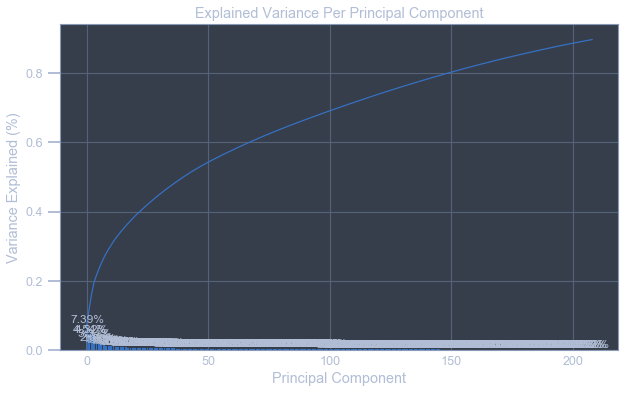

In [101]:
scree_plot(pca)

In [102]:
comp = get_component(pca, 0.85)

The number of components needed to obtain 0.8507923257104508 of variance is 178


In [103]:
# Re-apply PCA to the data while selecting for number of components to retain.
pca, X_pca = do_pca(n_components = comp, data=scaled_features)

After applying PCA with halft the features in the dataset and plotting the # of principal components vs variance explained, I realized that in order to have 80% of variance, we need to retain around 150 components. 

Then, I created a function to obtain the exact number of components needed to have 85% of variance, which the result is **178**

### Interpret Principal Components

Now that we have our transformed principal components, let's check out the weight of each variable on the first few components to see if they can be interpreted in some fashion.

As a reminder, each principal component is a unit vector that points in the direction of highest variance (after accounting for the variance captured by earlier principal components). The further a weight is from zero, the more the principal component is in the direction of the corresponding feature. If two features have large weights of the same sign (both positive or both negative), then increases in one tend expect to be associated with increases in the other. To contrast, features with different signs can be expected to show a negative correlation: increases in one variable should result in a decrease in the other.

- To investigate the features, let's map each weight to their corresponding feature name, then sort the features according to weight. The most interesting features for each principal component, then, will be those at the beginning and end of the sorted list. We will need to use the data dictionary document to understand these most prominent features, their relationships, and what a positive or negative value on the principal component might indicate.
- Since there are quite a lot of components, let's investigate the first three principal components in this step. To help facilitate this, we should write a function that we can call at any time to print the sorted list of feature weights, for the *i*-th principal component. This might come in handy in the next step of the project, when we interpret the tendencies of the discovered clusters.

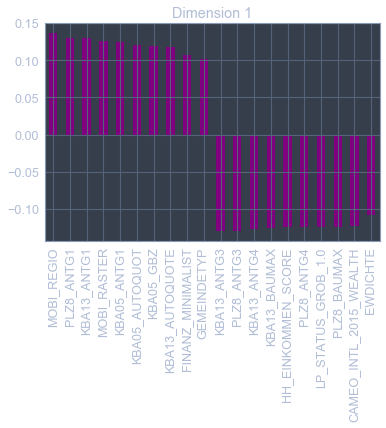

In [104]:
plot_component(azdias_updated, pca, 1)

* High mobility patterns
* High share of number of 1-2 family houses in the PLZ8
* High share of cars per household
* High financial interest
* High estimated household net income
* Wealthy households

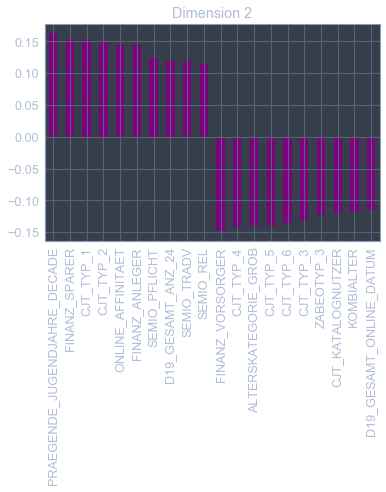

In [105]:
plot_component(azdias_updated, pca, 2)

* Person's youth: 90ies
* Not likely to be money savers
* Not likely to be investors
* High online affinity
* Lowest affinity indicating in what way the person is dutyfull traditional minded
* Prepared in terms of finance
* Less than 30 years (Age classification through prename analysis)


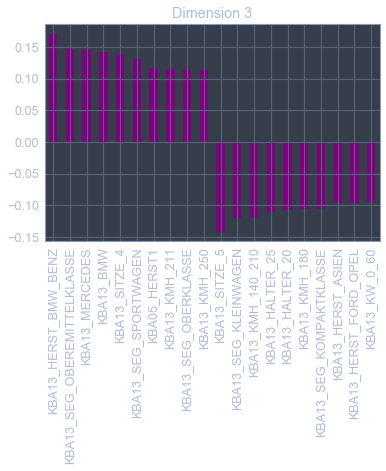

In [106]:
plot_component(azdias_updated, pca, 3)

* Very high share of BMW & Mercedes Benz within the PLZ8
* Very high share of upper middle class cars and upper class cars (BMW5er, BMW7er etc.)
* Very high number of cars with less than 5 seats in the PLZ8


### Apply Clustering to General Population

We've assessed and cleaned the demographics data, then scaled and transformed them. Now, it's time to see how the data clusters in the principal components space. In this substep, we will apply k-means clustering to the dataset and use the average within-cluster distances from each point to their assigned cluster's centroid to decide on a number of clusters to keep.

- We will use sklearn's [KMeans](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) class to perform k-means clustering on the PCA-transformed data.
- Then, we'll compute the average difference from each point to its assigned cluster's center. **Hint**: The KMeans object's `.score()` method might be useful here, but note that in sklearn, scores tend to be defined so that larger is better. Try applying it to a small, toy dataset, or use an internet search to help your understanding.
- We'll perform the above two steps for a number of different cluster counts. You can then see how the average distance decreases with an increasing number of clusters. However, each additional cluster provides a smaller net benefit. 
- Once we've selected a final number of clusters to use, we'll re-fit a KMeans instance to perform the clustering operation. 

In [107]:
# sample of dataset
sample_pca = X_pca[np.random.choice(X_pca.shape[0], int(X_pca.shape[0]*0.25))]

In [108]:
n_cluster = 30
# Over a number of different cluster counts...
distance = np.arange(n_cluster)
for cluster in range(n_cluster):

    # running k-means clustering on the data and...
    model = KMeans(cluster+1).fit(sample_pca)
   
    
    # computing the average within-cluster distances.
    distance[cluster] = abs(model.score(sample_pca))
        

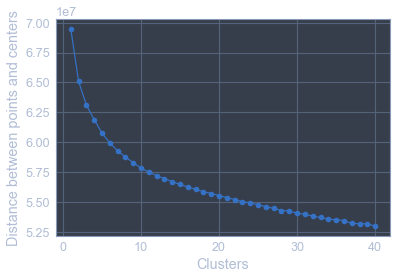

In [109]:
# Investigating the change in within-cluster distance across number of clusters.

plt.plot(range(1,distance.size+1), distance, marker='o')
plt.xlabel("Clusters")
plt.ylabel("Distance between points and centers");

As we can see in the plot above, there is no obvious elbow. However, we can perceive that after 15 clusters, the line is gradually decreasing. So I decided to use 15 clusters for this situation.

In [111]:
# Re-fitting the k-means model with 15 clusters and obtain
# cluster predictions for the general population demographics data.

model = KMeans(15, random_state=42).fit(X_pca)


In [113]:
# Saving model 
save_model(model, 'k_means_15')
#file = open('k_means_model' + str(15) + '_clusters.pkl', 'wb')
#pickle.dump(model, file)
#print('Model Saved')

k_means_15_model.pkl saved


In [114]:
kmeans_general = model.predict(X_pca) 

### Apply All Steps to the Customer Data

Now that we have clusters and cluster centers for the general population, it's time to see how the customer data maps on to those clusters. We're going to use the fits from the general population to clean, transform, and cluster the customer data. In the last step of the project, we will interpret how the general population fits apply to the customer data.

We will apply the same feature wrangling, selection, and engineering steps to the customer demographics using the clean_data() function we created earlier. (we can assume that the customer demographics data has similar meaning behind missing data patterns as the general demographics data.)

We will use the sklearn objects from the general demographics data, and apply their transformations to the customers data. 

In [115]:
print(outlier_columns.tolist())
pop_outlier = outlier_columns.tolist()
cust_col = customers.columns.tolist()

set(pop_outlier).difference(cust_col)

['ALTER_KIND4', 'TITEL_KZ', 'ALTER_KIND3', 'ALTER_KIND2', 'ALTER_KIND1', 'AGER_TYP', 'EXTSEL992', 'KK_KUNDENTYP', 'KBA05_BAUMAX', 'ALTER_HH', 'ALTERSKATEGORIE_FEIN', 'D19_VERSAND_ONLINE_QUOTE_12', 'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSI_ONLINE_QUOTE_12', 'D19_BANKEN_ONLINE_QUOTE_12', 'D19_SOZIALES', 'D19_LOTTO', 'D19_LETZTER_KAUF_BRANCHE', 'D19_KONSUMTYP', 'D19_GESAMT_ONLINE_QUOTE_12']


set()

In [116]:
# customers.loc[customers['CAMEO_DEUG_2015'] == 'X', 'CAMEO_DEUG_2015'] #= np.nan
customers.CAMEO_INTL_2015.value_counts()

14      14708
24      13301
41       8461
43       7158
25       6900
15       6845
51       5987
13       5728
22       5566
14.0     4939
24.0     4504
23       4276
34       3945
45       3936
54       3537
41.0     2859
55       2794
12       2791
43.0     2476
25.0     2472
15.0     2372
44       2144
51.0     2126
31       2050
13.0     1955
22.0     1941
35       1741
23.0     1494
34.0     1423
45.0     1352
54.0     1258
32       1256
33       1178
12.0      924
55.0      920
52        770
44.0      688
31.0      681
35.0      553
32.0      440
33.0      396
52.0      253
XX        126
Name: CAMEO_INTL_2015, dtype: int64

In [126]:
customers, customers_high_nas = utils.clean_azdias(customers.copy(),unknown_dict, outlier_columns, cat_col)

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Splitting records with NAs..
 Total records: 191652
Records split by 87 missing values.
 Shape of resulting dataset: (140338,)
 Shape of high NAs dataset: (51314,)



/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s
/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:5890: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)
/anaconda3/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [127]:
customers.head()

,AKT_DAT_KL,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,D19_BILDUNG,D19_BIO_OEKO,D19_BUCH_CD,D19_DIGIT_SERV,D19_DROGERIEARTIKEL,D19_ENERGIE,D19_FREIZEIT,D19_GARTEN,D19_GESAMT_ANZ_12,D19_GESAMT_ANZ_24,D19_GESAMT_DATUM,D19_GESAMT_OFFLINE_DATUM,D19_GESAMT_ONLINE_DATUM,...,CAMEO_DEUG_2015_5.0,CAMEO_DEUG_2015_6.0,CAMEO_DEUG_2015_7.0,CAMEO_DEUG_2015_8.0,CAMEO_DEUG_2015_9.0,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_6.0,GEBAEUDETYP_8.0,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,ZABEOTYP_1,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6,PRAEGENDE_JUGENDJAHRE_MOVEMENT,PRAEGENDE_JUGENDJAHRE_DECADE,CAMEO_INTL_2015_WEALTH,CAMEO_INTL_2015_LIFESTAGE,EINGEFUEGT_AM_YEAR
0,1.0,1.0,0.0,0.0,2.0,1.0,0.0,1.0,3.0,4.0,1.0,1.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0,0,0,0,0,6,0,0,0,0,0,0,0,9,9,10,...,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1.0,50.0,1.0,3.0,1992
2,1.0,1.0,0.0,0.0,1.0,1.0,0.0,3.0,7.0,5.0,2.0,2.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0,0,0,6,0,0,0,0,0,0,0,0,0,10,10,10,...,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1.0,50.0,3.0,4.0,1992
3,1.0,0.0,NaN,0.0,0.0,1.0,0.0,1.0,7.0,5.0,1.0,1.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0,0,0,0,0,6,0,0,0,0,0,0,1,6,6,10,...,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0.0,40.0,2.0,4.0,1992
4,1.0,7.0,0.0,0.0,4.0,7.0,0.0,3.0,3.0,4.0,3.0,3.0,3.0,4.0,3.0,3.0,1,2,3,5,0,3,10,7,0,0,6,0,0,2,0,4,0,6,0,3,5,1,8,1,...,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0.0,70.0,4.0,1.0,1992
5,1.0,1.0,0.0,0.0,2.0,1.0,0.0,3.0,7.0,3.0,1.0,1.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0,0,6,0,0,5,0,0,0,0,0,0,1,6,6,10,...,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1.0,50.0,3.0,4.0,1992


In [129]:
# Seems that there is a mismatch in the number of columns
# Investigating which column does not exist in the customer dataset

customer_columns = customers.columns.tolist()
general_columns = azdias_updated.columns.tolist()

print(set(general_columns).difference(customer_columns))
print(set(customer_columns).difference(general_columns))

{'GEBAEUDETYP_5.0'}
set()


In [130]:
# Adding 'GEBAEUDETYP_5.0' to the customers dataset with 0
gebaeu_index = azdias_updated.columns.get_loc('GEBAEUDETYP_5.0')
customers.insert(gebaeu_index, 'GEBAEUDETYP_5.0', 0 )

In [131]:
# Taking care of the remaining missing values
imputed_features_customers = imputer.transform(customers)
scaled_customers = scaler.transform(imputed_features_customers)

In [132]:
# Applying PCA and KMeans
pca_customers = pca.transform(scaled_customers)

kmeans_customers = model.predict(pca_customers)

### Compare Customer Data to Demographics Data
At this point, you have clustered data based on demographics of the general population of Germany, and seen how the customer data for a mail-order sales company maps onto those demographic clusters. In this final substep, you will compare the two cluster distributions to see where the strongest customer base for the company is.

Consider the proportion of persons in each cluster for the general population, and the proportions for the customers. If we think the company's customer base to be universal, then the cluster assignment proportions should be fairly similar between the two. If there are only particular segments of the population that are interested in the company's products, then we should see a mismatch from one to the other. If there is a higher proportion of persons in a cluster for the customer data compared to the general population (e.g. 5% of persons are assigned to a cluster for the general population, but 15% of the customer data is closest to that cluster's centroid) then that suggests the people in that cluster to be a target audience for the company. On the other hand, the proportion of the data in a cluster being larger in the general population than the customer data (e.g. only 2% of customers closest to a population centroid that captures 6% of the data) suggests that group of persons to be outside of the target demographics.

Take a look at the following points in this step:

- Compute the proportion of data points in each cluster for the general population and the customer data. Visualizations will be useful here: both for the individual dataset proportions, but also to visualize the ratios in cluster representation between groups. Seaborn's [`countplot()`](https://seaborn.pydata.org/generated/seaborn.countplot.html) or [`barplot()`](https://seaborn.pydata.org/generated/seaborn.barplot.html) function could be handy.
  - Recall the analysis you performed in step 1.1.3 of the project, where you separated out certain data points from the dataset if they had more than a specified threshold of missing values. If you found that this group was qualitatively different from the main bulk of the data, you should treat this as an additional data cluster in this analysis. Make sure that you account for the number of data points in this subset, for both the general population and customer datasets, when making your computations!
- Which cluster or clusters are overrepresented in the customer dataset compared to the general population? Select at least one such cluster and infer what kind of people might be represented by that cluster. Use the principal component interpretations from step 2.3 or look at additional components to help you make this inference. Alternatively, you can use the `.inverse_transform()` method of the PCA and StandardScaler objects to transform centroids back to the original data space and interpret the retrieved values directly.
- Perform a similar investigation for the underrepresented clusters. Which cluster or clusters are underrepresented in the customer dataset compared to the general population, and what kinds of people are typified by these clusters?

In [133]:
# Creating cluster 15 for the high NAs for the two datasets
#gral_high_nas = azdias[azdias.index.isin(na_rows_high.index)]
#kmeans_high_nas_gral = np.full((gral_high_nas.shape[0],), 15)
#kmeans_high_nas_cust = np.full((customers_high_nas.shape[0],), 15)

In [134]:
# Concatenating the cluster arrays for the high nas to the kmeans array
#print(np.concatenate((kmeans_general,kmeans_high_nas_gral)).shape,kmeans_general.shape,kmeans_high_nas_gral.shape,)
kmeans_gral_org = kmeans_general
kmeans_cust_org = kmeans_customers
#kmeans_general = np.concatenate((kmeans_general,kmeans_high_nas_gral))
#kmeans_customers = np.concatenate((kmeans_customers,kmeans_high_nas_cust))

785296
140338


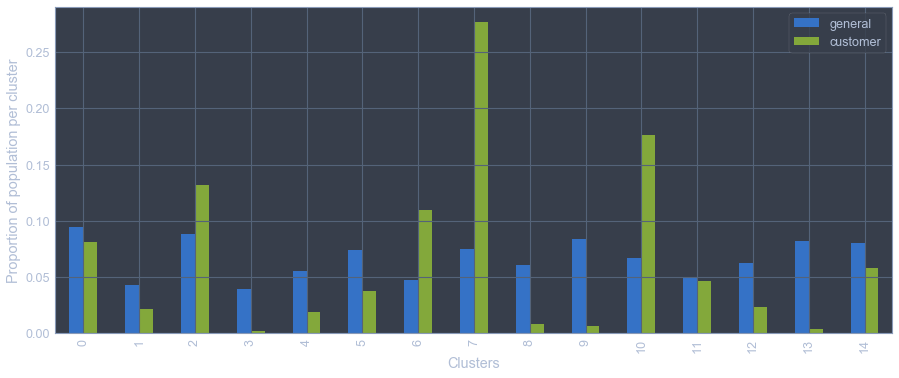

In [135]:
# Compare the proportion of data in each cluster for the customer data to the
# proportion of data in each cluster for the general population.

gral_prop = np.bincount(kmeans_general)/len(kmeans_general)
print(len(kmeans_general))
cust_prop = np.bincount(kmeans_customers)/len(kmeans_customers)
print(len(kmeans_customers))

full_prop = pd.DataFrame({'general': gral_prop, 'customer': cust_prop})

full_prop.plot(kind='bar', figsize=[15,6])
plt.xlabel('Clusters')
plt.ylabel('Proportion of population per cluster');

In [136]:
differences = full_prop['customer'] - full_prop['general']

# Overrepresented clusters
overrepresented = differences.sort_values(ascending=False)[:3].index
differences.sort_values(ascending=False)[:5]

7     0.202135
10    0.109514
6     0.061554
2     0.044215
11   -0.002752
dtype: float64

In [137]:
# Underrepresented clusters
underrepresented = differences.sort_values(ascending=True)[:3].index
differences.sort_values(ascending=True)[:3]

13   -0.079080
9    -0.077332
8    -0.052757
dtype: float64

In [138]:
# What kinds of people are part of a cluster that is overrepresented in the
# customer data compared to the general population?

def get_components(cluster, kmeans):
    
    pca_c = kmeans.cluster_centers_[cluster].copy()
    pca_series = pd.Series(pca_c)
    print(pca_series.head(5), pca_series.tail(5))
    pos_comp = pca_series.sort_values(ascending=False)[:3].index
    neg_comp = pca_series.sort_values(ascending=True)[:3].index
    print(pos_comp, neg_comp)
    
    return pos_comp, neg_comp

In [140]:
comp_pos_over, comp_neg_over = get_components(overrepresented[0],model) 
comp_pos_under, comp_neg_under = get_components(underrepresented[0],model)

0    4.800718
1   -4.159381
2    0.376620
3    1.632479
4    0.307449
dtype: float64 173    0.040051
174    0.011829
175   -0.018682
176    0.022113
177    0.013894
dtype: float64
Int64Index([0, 7, 3], dtype='int64') Int64Index([1, 6, 10], dtype='int64')
0   -4.689697
1    2.122607
2    1.288129
3   -3.547347
4   -0.329915
dtype: float64 173    0.057621
174   -0.018656
175    0.022247
176   -0.013925
177    0.030423
dtype: float64
Int64Index([1, 8, 2], dtype='int64') Int64Index([0, 3, 6], dtype='int64')


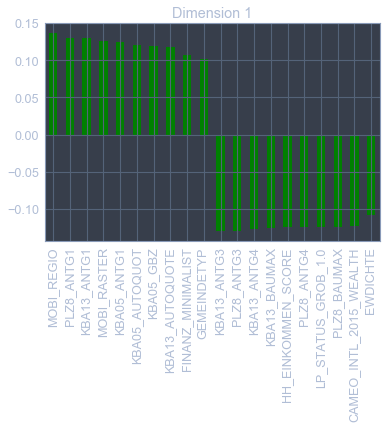

In [141]:
# For the overrepresented, lets take a closer look to its most relevant components

plot_component(full_dataset=customers,n_components=comp_pos_over[0]+1, pca=pca, color='green')

* High mobility patterns
* High share of number of 1-2 family houses in the PLZ8
* High share of cars per household
* High financial interest
* High estimated household net income
* Wealthy households

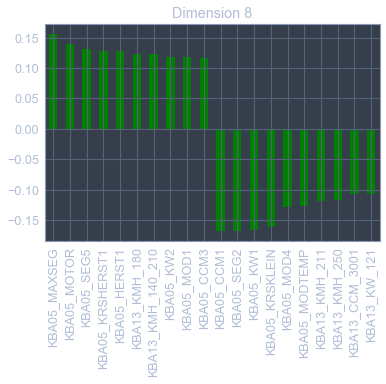

In [142]:
plot_component(full_dataset=customers,n_components=comp_pos_over[1]+1, pca=pca, color='green')

* Most common car in the microcell: upper class car(Mercedes/ BMW) or 
* Most common engine size in the microcell: big engine
* Very high share of upper middle class car (BMW5er, BMW7er etc.) in the microcell
* Very high share of big cars

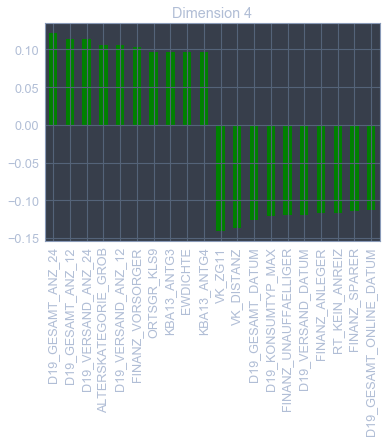

In [143]:
plot_component(full_dataset=customers,n_components=comp_pos_over[2]+1, pca=pca, color='green')

* Very high transaction activity(BANKS, TELCO, INSURANCE, MAIL-ORDER) in the last 12-24 months
* Very high mail order transaction activity in the last 12- 24 months.
* People > 60 years age classification through prename analysis
* Financially prepared household/people


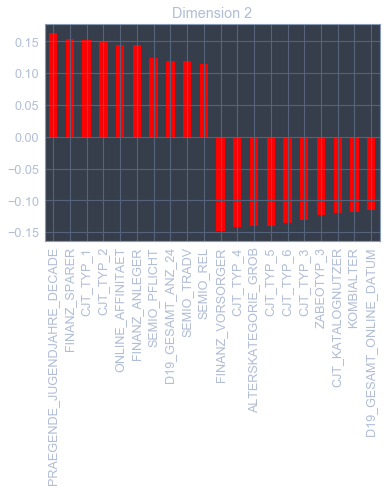

In [144]:
# What kinds of people are part of a cluster that is underrepresented in the
# customer data compared to the general population?

# For the uderrepresented, lets take a closer look to its most relevant components

plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[0]+1, pca=pca, color='red' )

Dimension 2
* Person's youth: 90ies
* Not likely to be money savers
* Not likely to be investors
* High online affinity
* Lowest affinity indicating in what way the person is dutyfull traditional minded
* Prepared in terms of finance
* Less than 30 years (Age classification through prename analysis)

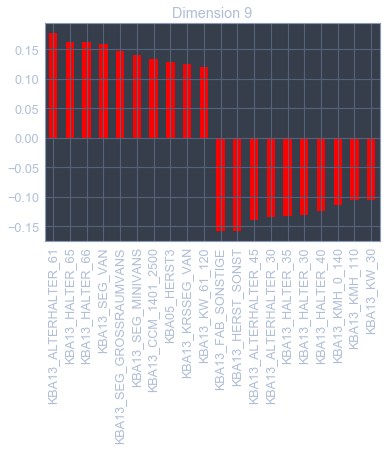

In [145]:
plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[1]+1, pca=pca, color='red' )

Dimension 9
* Very high share of car owners over 61 years old within the PLZ8
* Very high share of vans, big sized vans and minivans within the PLZ8

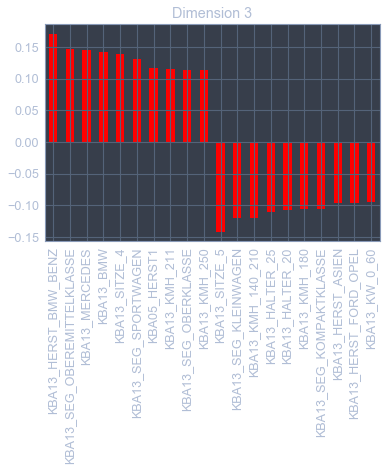

In [146]:
plot_component(full_dataset=azdias_updated,n_components=comp_pos_under[2]+1, pca=pca, color='red' )

Dimension 3
* Very high share of BMW & Mercedes Benz within the PLZ8
* Very high share of upper middle class cars and upper class cars (BMW5er, BMW7er etc.) within PLZ8
* Very high number of cars with less than 5 seats in the PLZ8
* Very high share of sports cars within the PLZ8
* Share of car owners not younger than 25 and not older than 46-61

In the plot above (customer vs general population), we are able to see that there are obvious overrepresented clusters, such as 11 cluster and also obvious underrepresented clusters, such as 7. After taking a look at their most relevant components, we could say that the kind of **overrepresented people** in the customer dataset compared to the general population is:

* High estimated household net income families (wealthy households) with high financial interest and high share of upper class cars (BMW/Mercedes) with big engines, who have very high transaction activity (Banks, Telco, Insurance, Mail-Order)

On the other hand, the kind of **underrepresented people** are:

* Young people (less than 30), who have not financial interest but financially prepared and not traditionally minded.
* People not younger than 25 but not older than 61 with very high share of sports cars with less than 5 seats within the PLZ8.
* People over 61 years old with very high share of vans, minivans or big sized vans withing the PLZ8.

## Part 2: Supervised Learning Model

Now that you've found which parts of the population are more likely to be customers of the mail-order company, it's time to build a prediction model. Each of the rows in the "MAILOUT" data files represents an individual that was targeted for a mailout campaign. Ideally, we should be able to use the demographic information from each individual to decide whether or not it will be worth it to include that person in the campaign.

The "MAILOUT" data has been split into two approximately equal parts, each with almost 43 000 data rows. In this part, you can verify your model with the "TRAIN" partition, which includes a column, "RESPONSE", that states whether or not a person became a customer of the company following the campaign. In the next part, you'll need to create predictions on the "TEST" partition, where the "RESPONSE" column has been withheld.

In [147]:
mailout_train = pd.read_csv('Udacity_MAILOUT_052018_TRAIN.csv', sep=';')
mailout_train.drop(columns='Unnamed: 0', inplace=True)

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [148]:
mailout_train.head()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_INTL_2015,CJT_GESAMTTYP,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_ONLINE_QUOTE_12,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,...,RELAT_AB,RETOURTYP_BK_S,RT_KEIN_ANREIZ,RT_SCHNAEPPCHEN,RT_UEBERGROESSE,SEMIO_DOM,SEMIO_ERL,SEMIO_FAM,SEMIO_KAEM,SEMIO_KRIT,SEMIO_KULT,SEMIO_LUST,SEMIO_MAT,SEMIO_PFLICHT,SEMIO_RAT,SEMIO_REL,SEMIO_SOZ,SEMIO_TRADV,SEMIO_VERT,SHOPPER_TYP,SOHO_KZ,STRUKTURTYP,TITEL_KZ,UMFELD_ALT,UMFELD_JUNG,UNGLEICHENN_FLAG,VERDICHTUNGSRAUM,VERS_TYP,VHA,VHN,VK_DHT4A,VK_DISTANZ,VK_ZG11,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,RESPONSE,ANREDE_KZ,ALTERSKATEGORIE_GROB
0,1763,2,1.0,8.0,NaN,NaN,NaN,NaN,8.0,15.0,0.0,0.0,1.0,13.0,0.0,3.0,5.0,5D,5,34,2.0,5.0,2.0,2.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0.0,0,0,0,...,5.0,5.0,2.0,5.0,1.0,6,7,2,6,6,1,7,1,3,2,1,5,1,3,3,0.0,3.0,0.0,2.0,4.0,0.0,4.0,2,1.0,2.0,5.0,2.0,1.0,6.0,9.0,3.0,3,0,2,4
1,1771,1,4.0,13.0,NaN,NaN,NaN,NaN,13.0,1.0,0.0,0.0,2.0,1.0,0.0,2.0,5.0,5B,5,32,2.0,2.0,2.0,2.0,4.0,3.0,5.0,4.0,1,1,5,0,0,3,10,10,0.0,0,0,6,...,1.0,2.0,3.0,1.0,3.0,6,6,1,5,6,3,6,5,5,4,3,1,3,4,2,0.0,1.0,0.0,2.0,5.0,0.0,0.0,1,1.0,3.0,1.0,2.0,1.0,4.0,9.0,7.0,1,0,2,3
2,1776,1,1.0,9.0,NaN,NaN,NaN,NaN,7.0,0.0,NaN,0.0,0.0,1.0,0.0,4.0,1.0,2D,2,14,4.0,5.0,1.0,1.0,5.0,5.0,5.0,5.0,0,1,7,0,0,0,10,7,0.0,5,0,0,...,4.0,3.0,1.0,5.0,2.0,3,3,4,1,3,4,7,6,1,1,5,3,1,7,3,0.0,3.0,0.0,1.0,5.0,0.0,10.0,1,4.0,1.0,6.0,4.0,2.0,NaN,9.0,2.0,3,0,1,4
3,1460,2,1.0,6.0,NaN,NaN,NaN,NaN,6.0,4.0,0.0,0.0,2.0,4.0,0.0,4.0,2.0,2D,2,14,2.0,5.0,2.0,2.0,5.0,5.0,5.0,4.0,0,0,10,0,0,0,10,10,0.0,0,0,6,...,3.0,5.0,2.0,5.0,1.0,5,7,1,6,7,1,7,1,4,2,2,5,3,2,1,0.0,3.0,0.0,3.0,5.0,0.0,5.0,2,1.0,4.0,8.0,11.0,11.0,6.0,9.0,1.0,3,0,2,4
4,1783,2,1.0,9.0,NaN,NaN,NaN,NaN,9.0,53.0,0.0,0.0,1.0,44.0,0.0,3.0,4.0,7B,7,41,6.0,5.0,1.0,2.0,5.0,5.0,5.0,5.0,0,0,10,0,0,0,10,10,0.0,0,5,0,...,3.0,5.0,1.0,5.0,1.0,5,4,6,2,5,5,6,6,4,5,4,6,2,7,1,0.0,3.0,0.0,2.0,5.0,0.0,4.0,1,0.0,4.0,2.0,2.0,1.0,6.0,9.0,3.0,3,0,1,3


In [149]:
mailout_train.RESPONSE.value_counts()

0    42430
1      532
Name: RESPONSE, dtype: int64

In [161]:
mailout_clean, mailout_high_nas = clean_mailout(mailout_train.copy(),unknown_dict,outlier_columns,cat_col)
#mailout_train.OST_WEST_KZ.value_counts()

Splitting records with NAs..
 Total records: 42962
Records split by 86 missing values.
 Shape of resulting dataset: (34993,)
 Shape of high NAs dataset: (7969,)



/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s
/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:5890: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)
/anaconda3/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [164]:

mailout_columns = mailout_clean.columns.tolist()
general_columns = azdias_updated.columns.tolist()

print(set(general_columns).difference(mailout_columns))
print(set(mailout_columns).difference(general_columns))

{'GEBAEUDETYP_5.0'}
{'RESPONSE'}


In [165]:
gebaeu_index = azdias_updated.columns.get_loc('GEBAEUDETYP_5.0')
mailout_clean.insert(gebaeu_index, 'GEBAEUDETYP_5.0', 0 )

In [166]:
# Taking care of the remaining missing values
imputed_features_mailout = imputer.transform(mailout_clean[mailout_clean.RESPONSE == 1].drop(columns = 'RESPONSE'))
scaled_mailout = scaler.transform(imputed_features_mailout)

In [167]:
# Applying PCA and KMeans
pca_mailout = pca.transform(scaled_mailout)

kmeans_mailout = model.predict(pca_mailout)

In [168]:
len(kmeans_general)

785296

785296 15
435 15


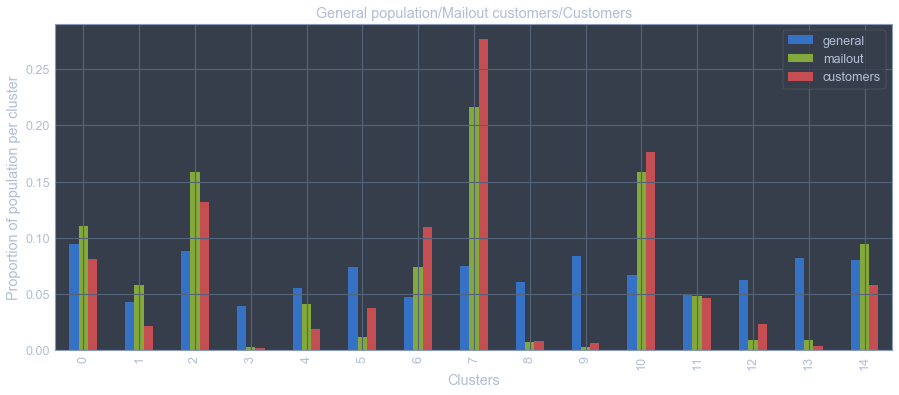

In [171]:
gral_prop = np.bincount(kmeans_general)/len(kmeans_general)
print(len(kmeans_general), len(gral_prop))
mailout_prop = np.bincount(kmeans_mailout)/len(kmeans_mailout)
print(len(kmeans_mailout), len(mailout_prop))

full_prop = pd.DataFrame({'general': gral_prop,'mailout': mailout_prop, 'customers': cust_prop})

full_prop.plot(kind='bar', figsize=[15,6])
plt.xlabel('Clusters')
plt.ylabel('Proportion of population per cluster')
plt.title('General population/Mailout customers/Customers');

We can see that the cluster 7, 10 and 2 are overrepresented here as well. However, there are more clusters here that show overrepresentation than in the customers dataset. This could be potentially due to the unbalance MAILOUT dataset, which mean we need to proceed with supervised learning using other methods.